In [1]:
import numpy as np
import scipy.integrate as spi

from scipy.interpolate import interp1d

import matplotlib.pyplot as plt
import math
import pandas as pd

In [2]:
data = pd.read_csv("D:\\DEBADES SIR;S PAPERS\\FORTRAN TOV Code\\aghto240m0.7.excel.csv")
df=pd.DataFrame(data)

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [3]:
#data1 = pd.read_csv("D:\\DEBADES SIR;S PAPERS\\FORTRAN TOV Code\\aghto300m0.7.excel.csv")
#df1=pd.DataFrame(data)

#pd.set_option('display.max_columns', None)
#pd.set_option('display.max_rows', None)

In [4]:
print(df)

     1.00E-01  1.53E-02  0.00E+00  1.44E+01   3.59E-03
0        0.12    0.0184       0.0      17.3    0.00394
1        0.14    0.0214       0.0      20.2    0.00505
2        0.16    0.0245       0.0      23.0    0.00732
3        0.18    0.0275       0.0      25.9    0.01110
4        0.20    0.0306       0.0      28.8    0.01680
5        0.22    0.0337       0.0      31.7    0.02480
6        0.24    0.0367       0.0      34.6    0.03520
7        0.26    0.0398       0.0      37.4    0.04860
8        0.28    0.0428       0.0      40.3    0.06500
9        0.30    0.0459       0.0      43.2    0.08470
10       0.32    0.0490       0.0      46.1    0.10800
11       0.34    0.0520       0.0      49.0    0.13500
12       0.36    0.0551       0.0      51.9    0.16700
13       0.38    0.0581       0.0      54.8    0.20200
14       0.40    0.0612       0.0      57.7    0.24200
15       0.42    0.0643       0.0      60.6    0.28700
16       0.44    0.0673       0.0      63.5    0.33600
17       0

In [5]:
#print(df1)

In [6]:


# Assuming df is your original DataFrame
new_df = pd.DataFrame()
new_df['Pressure (GeV/fm³)'] = df.iloc[:, 4] / 1000
new_df['Energy density (GeV/fm³)'] = df.iloc[:, 3] / 1000

#new_df1 = pd.DataFrame()
#new_df1['Pressure (GeV/fm³)'] = df.iloc[:, 4] / 1000
#new_df1['Energy density (GeV/fm³)'] = df.iloc[:, 3] / 1000




print(new_df)
#print(new_df1)

     Pressure (GeV/fm³)  Energy density (GeV/fm³)
0              0.000004                    0.0173
1              0.000005                    0.0202
2              0.000007                    0.0230
3              0.000011                    0.0259
4              0.000017                    0.0288
5              0.000025                    0.0317
6              0.000035                    0.0346
7              0.000049                    0.0374
8              0.000065                    0.0403
9              0.000085                    0.0432
10             0.000108                    0.0461
11             0.000135                    0.0490
12             0.000167                    0.0519
13             0.000202                    0.0548
14             0.000242                    0.0577
15             0.000287                    0.0606
16             0.000336                    0.0635
17             0.000390                    0.0664
18             0.000449                    0.0693


In [7]:
pressure_values = new_df['Pressure (GeV/fm³)']
energy_density_values = new_df['Energy density (GeV/fm³)']
interpolated_function = interp1d(pressure_values,energy_density_values, kind='cubic')


#pressure_values1 = new_df1['Pressure (GeV/fm³)']
#energy_density_values1 = new_df1['Energy density (GeV/fm³)']
#interpolated_function1 = interp1d(pressure_values1,energy_density_values1, kind='cubic')




In [8]:
len(pressure_values)

300

In [9]:
def tovrhs(dep_variables,x):#This function takes two parameters "initial" and "x" that represent the inputs. 
    p=dep_variables[0] #Here the first element in the initial list is assigned to variable "pres"
    𝑚=dep_variables[1] #Here the second element in the initial list is assigned to variable "mass"
    𝛼=41.325 #alfa= (M_solar*c**2/R_s**3) in units of MeV/fm^3
    𝜖=eos(p) #Here an equation of state is called as a function of pressure and is assigned to the energy density 
    one=-0.5*𝜖*m*(1+(p/𝜖))*(1+(4*np.pi/𝛼)*(p/m)*x**3)/(x**2-m*x) #RHS of the TOV equation dp/dr
    two=4*np.pi*x**2*𝜖/𝛼 # RHS of the TOV Equation dm/dr
    f=[one,two] #it stores the calculated values from the previous lines into a list f. 
    return f

In [10]:
 def eos(p):
    print(p)
    if p<=1.e-5:
        p=1.e-5
    return float(interpolated_function(p))
    
     

In [11]:
print(interpolated_function(pressure_values))

    

[0.0173 0.0202 0.023  0.0259 0.0288 0.0317 0.0346 0.0374 0.0403 0.0432
 0.0461 0.049  0.0519 0.0548 0.0577 0.0606 0.0635 0.0664 0.0693 0.0722
 0.0751 0.078  0.0809 0.0838 0.0868 0.0897 0.0926 0.0955 0.0985 0.101
 0.104  0.107  0.11   0.113  0.116  0.119  0.122  0.125  0.128  0.131
 0.134  0.137  0.14   0.143  0.146  0.149  0.152  0.155  0.158  0.161
 0.164  0.167  0.17   0.173  0.176  0.179  0.182  0.185  0.188  0.192
 0.195  0.198  0.201  0.204  0.207  0.21   0.213  0.216  0.219  0.223
 0.226  0.229  0.232  0.235  0.238  0.241  0.245  0.248  0.251  0.254
 0.257  0.26   0.264  0.267  0.27   0.273  0.277  0.28   0.283  0.286
 0.29   0.293  0.296  0.299  0.303  0.306  0.309  0.313  0.316  0.319
 0.323  0.326  0.329  0.333  0.336  0.339  0.343  0.346  0.35   0.353
 0.356  0.36   0.363  0.367  0.37   0.374  0.377  0.381  0.384  0.388
 0.391  0.395  0.398  0.402  0.405  0.409  0.412  0.416  0.419  0.423
 0.426  0.43   0.433  0.437  0.441  0.444  0.448  0.451  0.455  0.458
 0.462  0.466  0.4

In [12]:
def tsolve(p0,xfinal): # This function takes two parameters "pcent" that raprents central pressure and "xfinal" is final value of independent parameters.
    𝛼=41.325
    
    𝜖=eos(p0)
    
    dx=0.00025 #This represents the step size in independent variables.
    
    initial=p0,4*np.pi**𝜖*dx**3/(3*𝛼) #This line caculates the initial conditions of differential equations.It assigns a tuple to the variable "initial" containing the "central pressure(pcent)" and "initial mass((4 * np.pi ** eden * dx ** 3 / (3 * alfa)))
    X=np.arange(dx,xfinal,dx) #This line generates an array using np.arange()
    
    tov_sol=spi.odeint(tovrhs,initial,X) #It solves the ordinary differential equations using the "tovrhs" function,initial conditions "initial" and array of values "x".
    
    rstar=0 #We initialize "rstar","mstar","count" with value 0. They are used to store values related to some physical quantities.By setting it zero initially,it ensures that variables are initialized before any calculations or updates are performed
    mstar=0
    count=0
    
    m=[] # These are the three empty lists are created to store updated values of rstar,mstar and i
    r=[]
    p=[]
    k=[]
    for i in tov_sol[:,0]: #This starts a loop that iterates over the values in the first column ([:, 0]) of the tov_sol array.Each value represent the pressure.
        
        if i>1.e-5:
            count=count+1
            rstar=rstar+2.95*dx
            r.append(rstar) #It appends the current value of rstar to the list r.It stores the values of the radial distance.
            mstar=tov_sol[count,1] #This line assigns the value from tov_sol array at index "[count,1]" to the variable "mstar".It represents the mass at thecurrent iteration.
            m.append(mstar) #It appends the current value of mstar to the list m.It stores the values of the mass.
            p.append(i)#It appends the current value of "i" to the list w.It stores the values of the pressure.
            k.append(i*(1.6*10**36))
    return rstar,mstar,r,m,p,k #Finally the values of "rstar","mstar","r","m","w" are returned as a tuple.

F=tsolve(0.15,10) #It assigns the returned tuple from "tsolve" to the variable F,i.e.,F becomes a tuple containing the values returned by the "tsolve" function.


0.15
0.15
0.1499999999992104
0.14999999999842042
0.14999999209873255
0.14999998618765095
0.1499999980234983
0.1499999974572688
0.14999999219890253
0.14999999184556526
0.1499999854953444
0.14999998506615211
0.14999997763374132
0.1499999771107075
0.14999996857623557
0.14999996797238757
0.14999995831672594
0.14999995764674418
0.14999994685486615
0.1499999461308749
0.14999993419135282
0.1499999334228208
0.1499999203269347
0.1499999195212114
0.14999990526222023
0.14999990442505629
0.1499998889976686
0.14999988813361934
0.149999867961772
0.14999986807653556
0.14999984690425983
0.14999984689028484
0.1499998242180524
0.14999982420923869
0.1499998166322711
0.14999981663166156
0.1499998089057113
0.14999980890541018
0.14999980102244417
0.14999980102217209
0.14999979238351557
0.14999979238322586
0.14999978356198115
0.14999978356171284
0.14999968528668922
0.14999968752185872
0.14999968528668922
0.1499995673348112
0.1499994290692448
0.14999837582045975
0.14999837805560973
0.14999837582045975
0.14999

In [13]:
print(F[0],F[1])

11.919474999996048 1.8059511721598407


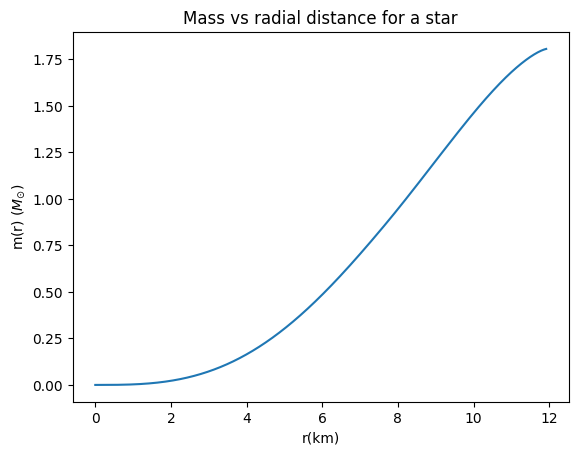

In [14]:
plt.plot(F[2],F[3])
plt.xlabel('r(km)')
plt.ylabel('m(r) ($M_{\odot}$)')
plt.title('Mass vs radial distance for a star' )
plt.show()

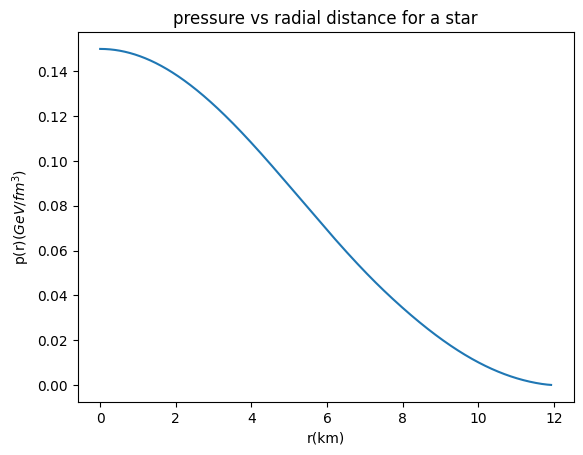

In [15]:
plt.plot(F[2],F[4])
plt.xlabel('r(km)')
plt.ylabel('p(r)($GeV/fm^{3}$)')
plt.title('pressure vs radial distance for a star' )
plt.show()

In [16]:
def M_R(imax):
    #imax=len(pressure_values) # It represents the maximum number of iterations in the subsequent loop.
    p0=np.zeros(imax) # Here a numpy array pc of desired size("imax")  is created and its all elements are initially set to zero.This array will store the values of pc during the iteration of the loop.
    M=np.zeros(imax)
    R=np.zeros(imax)
    E0=np.zeros(imax)
    for i in range(imax):
        p0[i]=pressure_values[i] # in each iteration this line calculates the value of pc[i] based on the index i.
        E0[i]=interpolated_function(pressure_values[i])
        
        
        R[i]=tsolve(p0[i],10)[0]
        # This line calculates the radius at index i by calling the tsolve function with pc[i] as the central pressure and 10 as the xfinal value. The tsolve function returns a tuple containing (rstar, mstar, r, m, w). Since the radius is stored at index 0 within the tuple, [0] is used to access that value. The calculated radius is then assigned to radius[i].
        M[i]=tsolve(p0[i],10)[1]
        #  These lines utilize the tsolve function to calculate the radius and mass for each pc[i] value within a loop. The resulting values are stored in the radius and mass arrays, respectively, at the corresponding indices i.
    return p0,R,M,E0 #The function will return these three arrays as a tuple.Each array contains the values calculated during the loop and order of the arrays in the tuple mathches the order in which they are listed in the return statement.

T=M_R(len(pressure_values))

3.9399999999999995e-06
3.9399999999999995e-06
3.93999999363152e-06
3.93999999363427e-06
3.939999987268541e-06
3.93999998727129e-06
3.9399363574647295e-06
3.939991579721268e-06
3.939917652941147e-06
3.939932472500435e-06
3.939859052775134e-06
3.939866136612633e-06
3.939787515332944e-06
3.93979052017575e-06
3.9397040368624045e-06
3.9397044360428185e-06
3.939608728108489e-06
3.939607304378584e-06
3.939501590659147e-06
3.939498816563371e-06
3.939382609747437e-06
3.939378794044438e-06
3.939226465492406e-06
3.9392290676903064e-06
3.93907572245543e-06
3.939075281597637e-06
3.938908861689769e-06
3.9389086315080175e-06
3.938463307831916e-06
3.938463488223788e-06
3.937932205142146e-06
3.9379339593205495e-06
3.937318385301814e-06
3.937320031882488e-06
3.935681537386819e-06
3.93569825540989e-06
3.933613021297293e-06
3.933635797041945e-06
3.931137839266718e-06
3.931153441424949e-06
3.920579577517617e-06
3.920927346705945e-06
3.905451792341712e-06
3.905926454700739e-06
3.886416469814967e-06
3.886680

3.52e-05
3.52e-05
3.519999999112693e-05
3.5199999991130584e-05
3.519999998226116e-05
3.5199999982264806e-05
3.519991132450783e-05
3.519998666100433e-05
3.519984905644777e-05
3.5199875327193025e-05
3.5199736844159825e-05
3.5199749758980344e-05
3.519960088681165e-05
3.519960634215298e-05
3.519944231218584e-05
3.519944291824829e-05
3.519926123922848e-05
3.5199258427484564e-05
3.519905765772984e-05
3.519905230453183e-05
3.519883153975193e-05
3.519882422190867e-05
3.5198582859043505e-05
3.519857397674989e-05
3.5198311594066444e-05
3.51983014364516e-05
3.5198017727698484e-05
3.519800651048988e-05
3.5197431377222716e-05
3.519744039662081e-05
3.5196824656369274e-05
3.5196823695710746e-05
3.5196142528672756e-05
3.5196142263108594e-05
3.519460708632857e-05
3.5194610211695635e-05
3.519279139314314e-05
3.5192797989208964e-05
3.5190702736955826e-05
3.519070831898785e-05
3.518464818962346e-05
3.518471609830105e-05
3.517694008798038e-05
3.517703339826427e-05
3.51676822477625e-05
3.5167744935508255e-0

8.47e-05
8.47e-05
8.46999999887964e-05
8.46999999888008e-05
8.46999999776016e-05
8.4699999977606e-05
8.469988802962379e-05
8.469998128406752e-05
8.469976866399238e-05
8.469980808695786e-05
8.469959252726178e-05
8.469961219649425e-05
8.46993799434142e-05
8.469938820223171e-05
8.469913204397369e-05
8.46991328130701e-05
8.469884893925934e-05
8.469884440826355e-05
8.469853060225246e-05
8.469852212206583e-05
8.469817698920868e-05
8.469816545252156e-05
8.469778806086154e-05
8.469777408845594e-05
8.46973637853061e-05
8.469734782632856e-05
8.469690413719612e-05
8.469688652709212e-05
8.469617223329313e-05
8.469618126978673e-05
8.469543429237314e-05
8.469543311959565e-05
8.469462220924435e-05
8.469462163287918e-05
8.469256389111849e-05
8.469256598489321e-05
8.46901433921396e-05
8.469015052165096e-05
8.468736946429887e-05
8.468737587893164e-05
8.468145565533375e-05
8.468149087095087e-05
8.467432272980072e-05
8.467436709374087e-05
8.466600825156646e-05
8.466604100419495e-05
8.463740966428022e-05
8

0.00016700000000000002
0.00016700000000000002
0.00016699999998637854
0.00016699999998638363
0.00016699999997276725
0.00016699999997277234
0.00016699986385984163
0.00016699997486210657
0.0001669996694992269
0.00016699972484785546
0.0001669994136134223
0.00016699944147322452
0.0001669991055492288
0.00016699911714244104
0.0001669987463299005
0.00016699874717428172
0.0001669983360415451
0.00016699832925858718
0.00016699787463433
0.00016699786216018962
0.00016699736204490702
0.00016699734516250554
0.00016699679821819926
0.00016699677782108845
0.000166996183109777
0.00016699615984509412
0.00016699551668436757
0.00016699549103574554
0.00016699463315568474
0.0001669946422251532
0.00016699376049001988
0.00016699375925592234
0.00016699281467201247
0.00016699281393745935
0.00016699056523839355
0.00016699056502215122
0.00016698799018048343
0.00016698799349846062
0.00016698509286645482
0.00016698509646774536
0.000166979709279235
0.00016697972598061556
0.00016697343710727288
0.00016697345849091058
0

0.000287
0.000287
0.0002869999999838949
0.00028699999996780135
0.0002869998390317584
0.0002869999673500157
0.0002869995520693157
0.00028699962593439
0.0002869992009272643
0.00028699923828783946
0.000286998778889113
0.00028699879425596184
0.00028699828675675143
0.000286998287519773
0.00028699772457644235
0.0002869977149561211
0.0002869970922696636
0.00028699707489401963
0.00028699638974980516
0.0002869963663636187
0.0002869956169433033
0.0002869955887631806
0.00028699477379114243
0.0002869947416988091
0.000286993860246499
0.0002869938249012163
0.00028699287627209494
0.00028699283817961417
0.00028699182183800184
0.0002869917813947502
0.00028699069691995565
0.00028699065444240455
0.00028698851755370195
0.00028698853940033344
0.0002869862613849888
0.00028698625931271093
0.00028698378052405385
0.0002869837797042091
0.00028697813469192516
0.0002869781412688753
0.00028697159223835
0.00028697160788304757
0.0002869641680230793
0.0002869641819245901
0.0002869490744913868
0.0002869491438503665
0.

0.000449
0.000449
0.00044899999998134046
0.00044899999996269354
0.0004489998134934252
0.0004489999586349954
0.0004489994160157153
0.0004489995109377514
0.0004489989537349179
0.0004489990018449285
0.00044899839875611866
0.00044899841826695936
0.00044899775154620734
0.0004489977519973614
0.00044899701209588167
0.00044899699897536414
0.00044899618029200676
0.0004489961570272003
0.0004489952560210164
0.00044899522489078394
0.0004489942391881535
0.0004489942017828576
0.00044899312971772925
0.0004489930871905848
0.00044899192754972256
0.00044899188076328705
0.0004489906326363091
0.00044899058225245585
0.00044898924493904334
0.00044898919147666716
0.0004489877644267088
0.0004489877083001037
0.0004489852645000973
0.0004489852863276375
0.00044898271136609743
0.0004489827090334754
0.0004489799347485777
0.0004489799335380502
0.000448973807011698
0.00044897380985560757
0.0004489668204364888
0.00044896683069854714
0.0004489589831741189
0.00044895899312259263
0.00044894465789597213
0.000448944699274

0.000584
0.0005839999999795947
0.0005839999999592025
0.0005839997960387653
0.0005839999520843733
0.0005839993147375
0.000583999425076719
0.0005839987693007083
0.0005839988252312853
0.0005839981148553326
0.0005839981372904724
0.0005839973515814893
0.0005839973516493848
0.0005839964794240526
0.0005839964635522716
0.0005839954982434974
0.0005839954704526217
0.0005839944079062165
0.0005839943708716693
0.0005839932083018072
0.0005839931638915563
0.0005839918993422962
0.0005839918489112436
0.0005839904809579417
0.0005839904255196917
0.0005839889530931504
0.0005839888934255843
0.0005839873157032
0.0005839872524162192
0.0005839855687517485
0.0005839855023323436
0.0005839828507209033
0.0005839828725474167
0.0005839800967128635
0.0005839800942868475
0.0005839771198099592
0.0005839771184217552
0.0005839707849661497
0.0005839707858060884
0.0005839636426142248
0.0005839636494931028
0.0005839556967490873
0.0005839557040004222
0.0005839418247232289
0.000583941854057136
0.0005839259581062916
0.0005839

0.0008269999999999999
0.0008269999999999999
0.0008269999999769085
0.0008269999999538314
0.0008269997691820211
0.0008269999410638048
0.0008269991466915697
0.0008269992821869292
0.0008269984626462035
0.0008269985312426424
0.0008269976423897852
0.0008269976694021124
0.0008269966855765437
0.0008269966847511904
0.000826995592069369
0.0008269955713860525
0.0008269943616841487
0.0008269943261443347
0.0008269929942540912
0.0008269929471892366
0.0008269914896430381
0.0008269914333804759
0.0008269898477428281
0.0008269897839712545
0.0008269880684677506
0.000826987998450782
0.0008269861517494494
0.0008269860764569966
0.000826984097532889
0.0008269840177255069
0.0008269819057733046
0.0008269818220583313
0.0008269788538947358
0.0008269788757282831
0.0008269757943520564
0.000826975791860516
0.0008269725125210084
0.0008269725109507609
0.0008269658406262983
0.0008269658395045009
0.000826958421244723
0.000826958424667609
0.000826950254253034
0.0008269502586132039
0.0008269367903722404
0.000826936808263

0.00102
0.00102
0.001019999999975039
0.0010199999999500925
0.001019999750486539
0.001019999932719239
0.0010199990215423126
0.001019999175458713
0.0010199982338407161
0.0010199983116345845
0.0010199972895640523
0.001019997319776681
0.0010199961879441939
0.0010199961862592997
0.0010199949287793297
0.0010199949043274265
0.0010199935118516638
0.0010199934703620348
0.0010199919369697436
0.0010199918822608107
0.0010199902039783615
0.0010199901387185127
0.0010199883127544425
0.0010199882388802325
0.0010199862632004804
0.001019986182161188
0.001019984055238687
0.0010199839681468363
0.001019981688806401
0.0010199815965344363
0.0010199791638526253
0.001019979067097269
0.0010199758808855865
0.0010199759027266983
0.0010199726112443514
0.0010199726087423103
0.0010199691195596863
0.0010199691179077171
0.0010199622045436465
0.001019962202551378
0.0010199545742991584
0.0010199545761049656
0.0010199462268383331
0.0010199462297788993
0.0010199329084691674
0.0010199329213158319
0.0010199180414557966
0.00

-0.0012370724799195222
-0.0012371169490455955
-0.0014197051677424912
-0.001419732080442049
-0.0016136163267716063
-0.0016136351339497005
-0.0018192541118945563
-0.0018192685727807113
0.00124
0.00124
0.0012399999999731573
0.0012399999999463298
0.001239999731672343
0.0012399999237204873
0.0012399988893553081
0.0012399990624040974
0.0012399979917850446
0.001239998079039688
0.0012399969160167338
0.0012399969493844926
0.0012399956608149048
0.0012399956580136221
0.001239994225906912
0.0012399941972770997
0.0012399926110390992
0.0012399925630757075
0.0012399908159940482
0.0012399907530279222
0.0012399888405965607
0.001239988765655027
0.0012399866847079253
0.0012399865999884183
0.0012399843482182708
0.001239984255365497
0.0012399818310399207
0.001239981731316525
0.0012399791331022178
0.0012399790274984278
0.0012399762543476283
0.0012399761436542613
0.0012399727396513196
0.0012399727614993091
0.0012399692604093443
0.001239969257914983
0.0012399655592120861
0.0012399655575038116
0.00123995839424

-1.421058851786111e-05
-1.4511172368541026e-05
-1.451117244951434e-05
-1.5112067012426785e-05
-1.5112066787239439e-05
-1.5112067012426785e-05
-1.571259911454462e-05
-1.631277004197403e-05
-1.9497411566023503e-05
-1.949741127548943e-05
-1.9497411566023503e-05
-1.9497498989947154e-05
-2.2672097967603023e-05
-2.267225336263271e-05
-2.5837034367393686e-05
-3.0476453215631214e-05
-3.0476670494867992e-05
-3.509591397685571e-05
-3.969542099511695e-05
-4.427574125898731e-05
-5.108162140706969e-05
-5.108162064589422e-05
-5.108162140706969e-05
-5.784772992585882e-05
-6.45757622794505e-05
-7.126732658545912e-05
-9.108073174778478e-05
-9.10807303905761e-05
-9.108073174778478e-05
-0.00011062068088811387
-0.00012992115571223392
-0.00014901456510626397
-0.00018689275981095268
-0.00018689275702603355
-0.00018689275981095268
-0.0001868797144262304
-0.00022423374416605547
-0.0002612399636093404
-0.000261259585498715
-0.0003212473910948832
-0.00032129713286987413
-0.00038129990654759235
-0.00038131482209

-0.00016721348122625615
-0.00023212816611391365
-0.00023217400788823998
-0.0002957242249183407
-0.00029576636679879364
-0.00035862297684710495
-0.00035865042800544875
-0.0004213175940039462
-0.0004213359454880248
-0.0005069464501034479
-0.0005069792659425618
-0.0005937154596711696
-0.0005937600596395129
-0.0006822364961819273
-0.0006822627425139382
-0.000772918954320479
-0.0007729365167255714
-0.0008661221069771012
-0.0008661340059497957
-0.001009654259261379
-0.0010096829589065508
-0.0011600827632587728
-0.0011601281220721246
-0.0013180097234217895
-0.001318037005896861
-0.0014838570119509852
-0.0014838754891530151
-0.0016580350282656433
-0.0016580481868030937
-0.0019273953399175433
-0.001927428739838891
0.00174
0.00174
0.0017399999999693058
0.0017399999999386277
0.0017399996931577915
0.0017399999035959727
0.001739998600572723
0.0017399988145738023
0.001739997461955838
0.0017399975692216991
0.001739996097607593
0.001739996137285373
0.0017399945052122181
0.00173999449943174
0.001739992

0.00204
0.00204
0.002039999999967227
0.00203999999993447
0.0020399996723671292
0.0020399998917639828
0.0020399984354176515
0.0020399986723194105
0.0020399971583698107
0.0020399972766669836
0.0020399956282210717
0.0020399956711410925
0.0020399938420103225
0.002039993834187422
0.0020399917992074816
0.0020399917551059627
0.002039989499434139
0.0020399894281607476
0.0020399869423841695
0.0020399868500184663
0.0020399841278144586
0.0020399840186090005
0.002039981055533256
0.002039980932576122
0.0020399777253887552
0.0020399775909919135
0.002039974137259739
0.0020399739931984376
0.002039970291048416
0.0020399701387150866
0.0020399661866750633
0.0020399660271818495
0.00203996182407403
0.0020399616583231936
0.002039957203190747
0.0020399570319243015
0.002039952323979468
0.0020399521478149728
0.002039944709641938
0.002039944752625902
0.002039936965556586
0.0020399369614074636
0.0020399286836485075
0.0020399286810724874
0.0020399131134546705
0.0020399131127240484
0.0020398959733757297
0.00203989

0.0023599999999999997
0.0023599999999999997
0.0023599999999651014
0.00235999999993022
0.0023599996511165632
0.002359999879032722
0.002359998260376854
0.0023599985212360004
0.0023599968362583885
0.0023599969659985976
0.0023599951299198177
0.002359995176055666
0.0023599931376984897
0.002359993127507078
0.0023599908589608466
0.002359990808485208
0.002359988293279952
0.0023599882126274373
0.002359985440315674
0.002359985336236029
0.002359982299798982
0.0023599821770144214
0.0023599788715179208
0.00235997873345797
0.002359975155304717
0.002359975004537173
0.0023599711510253855
0.0023599709895220414
0.002359966858571813
0.0023599666878793227
0.0023599622778558357
0.002359962099209557
0.0023599574088048374
0.0023599572232070156
0.002359952251358444
0.0023599520596333332
0.0023599468054660323
0.0023599466082996484
0.0023599387465595154
0.0023599387895214623
0.0023599305869338653
0.0023599305827263976
0.0023599218887640694
0.002359921886038202
0.002359905844362078
0.002359905842415488
0.0023598

0.00271
0.00271
0.002709999999962924
0.002709999999925865
0.0027099996293343948
0.002709999865255806
0.0027099980749905935
0.002709998360797952
0.0027099964946801967
0.0027099966361949063
0.0027099946011548176
0.0027099946503905347
0.0027099923899934824
0.002709992377011643
0.0027099898604512626
0.0027099898029594805
0.0027099870120496734
0.0027099869212106414
0.0027099838444126665
0.0027099837276830844
0.002709980357243884
0.002709980219841432
0.002709976550310063
0.002709976396024494
0.002709972423426584
0.002709972255095605
0.0027099679764459816
0.0027099677962487525
0.002709963209249226
0.0027099630188951165
0.0027099581217392204
0.0027099579225935895
0.0027099527138359568
0.002709952507006542
0.0027099469854728925
0.0027099467718707192
0.0027099409365942094
0.0027099407169775213
0.0027099324256721407
0.0027099324686156883
0.002709923844788357
0.002709923840549124
0.0027098277845050887
0.0027098278248846694
0.0027098277845050887
0.0027098223905382126
0.0027096785131165593
0.0027094

0.0015948918323326067
0.0015948918081590136
0.001587479717042139
0.0015874797169682763
0.0015800643811637492
0.0015800643719852997
0.0015726458854090106
0.00157264587605842
0.0015577997772978174
0.0015577997311130459
0.0015429416270651636
0.0015429416453472916
0.0015280715788429655
0.0015280715969190764
0.0015131891826997935
0.0015131891784889748
0.0014982935810938498
0.0014982935768222607
0.0014435598725351965
0.001443563403719143
0.001453421844722184
0.0014534229146651908
0.0014083705303741042
0.0014083883360796249
0.0014083705279861435
0.001408389686230357
0.0014444290984868189
0.0014444293367326833
0.0014354292505697616
0.001435428982139067
0.001426421760781738
0.001426421850009767
0.0014174081169345705
0.0014174081180686234
0.0014083880648806438
0.0014083880657757533
0.0013903307152349751
0.0013903307223112758
0.0013722544831932671
0.0013722544863917934
0.0013541660516745268
0.0013541660383294032
0.0013360741293643038
0.0013360740085043917
0.0013179886145547846
0.00131798777632995

0.00326
0.00326
0.0032599999999595726
0.003259999999919162
0.003259999595815689
0.0032599998428962827
0.0032599977783581333
0.0032599981035614438
0.0032599959475354853
0.0032599961074769456
0.003259993753718402
0.0032599938075475164
0.0032599911912425832
0.0032599911734568186
0.0032599882591814234
0.0032599881901428907
0.0032599849569736198
0.0032599848495285582
0.003259981284185836
0.00325998114691892
0.0032599772404782353
0.0032599770793977603
0.003259972825583691
0.0032599726450542616
0.003259968039290828
0.003259967842580893
0.0032599628814307816
0.0032599626710504404
0.003259957351867209
0.00325995712978552
0.003259951450488854
0.003259951218278657
0.0032599451772040156
0.003259944936141415
0.0032599385319364
0.0032599382830709117
0.0032599315146219937
0.003259931258827142
0.0032599223174256185
0.003259922360353645
0.0032599130997666543
0.0032599130955167457
0.003259805384400187
0.0032598054329750726
0.003259805384400187
0.0032597995093492094
0.003259639091547083
0.003259404838130

0.00366
0.00366
0.0036599999999572704
0.0036599999999145576
0.0036599995727869144
0.003659999826615734
0.0036599975674666426
0.0036599979201392733
0.00365999555801492
0.0036599957306165352
0.0036599931499805244
0.0036599932066844988
0.0036599903367987587
0.003659990315237935
0.0036599871174119764
0.003659987039826175
0.0036599834911998836
0.003659983371626598
0.0036599794576885765
0.0036599793055107407
0.003659975016507487
0.0036599748382929558
0.00365997016736556
0.003659969967885812
0.003659964910032515
0.0036599646928608836
0.003659959244324361
0.003659959012205196
0.0036599531700925126
0.00365995292517869
0.0036599466872156965
0.0036599464312269217
0.0036599397955939307
0.003659939529925488
0.003659932495144016
0.0036599322209434535
0.0036599247857961275
0.0036599245040185723
0.0036599151223655163
0.0036599151652859105
0.003659905473781034
0.0036599054695427113
0.0036597896130021886
0.0036597896675373037
0.0036597896130021886
0.0036597834148932393
0.0036596114946792174
0.0036593612

0.0038799999999999998
0.0038799999999999998
0.0038799999999560913
0.0038799999999121998
0.003879999560997306
0.00387999981791626
0.0038799974576191067
0.0038799978243215577
0.0038799953548833243
0.0038799955338469625
0.0038799928349238177
0.0038799928929189984
0.0038799898907036566
0.003879989866987316
0.003879986521096614
0.003879986438881618
0.003879982725451726
0.0038799825993929855
0.0038799785032740666
0.003879978343168279
0.0038799738541771592
0.0038799736668822314
0.0038799687778575715
0.0038799685683558937
0.0038799632740752453
0.0038799630460981975
0.00387995734263837
0.0038799570990517345
0.003879950983392033
0.0038799507264439767
0.0038799441962097873
0.00387994392769615
0.0038799369809873786
0.0038799367023652285
0.0038799293376380454
0.0038799290501057506
0.00387992126608897
0.0038799209706439613
0.0038799113650037054
0.0038799114079189254
0.003879901497157408
0.0038799014929294835
0.00387978141970904
0.0038797814775222888
0.00387978141970904
0.003879775058925885
0.0038795

0.00012040091385715866
0.00011831745933321625
0.00011831745934774657
0.00011418294384215035
0.00011418294401392965
0.00011009205899364675
0.0001100920595248892
0.0001060452836567438
0.00010604528504624397
0.00010204304728781595
0.00010204306726848642
9.808586146504503e-05
9.8085880366883e-05
8.782232664622546e-05
8.78221811536377e-05
7.789079261445931e-05
7.788967384123394e-05
6.830261531531377e-05
6.830265224820153e-05
5.908181477372556e-05
5.9080564432852694e-05
5.024675835500516e-05
5.024326385606851e-05
5.024676224897778e-05
5.024299586643787e-05
5.72819395724586e-05
5.728188656587269e-05
5.5498647451115876e-05
5.549871429224861e-05
5.373119495542181e-05
5.3731172098292896e-05
5.197933546381928e-05
5.197933581953562e-05
5.0243265546444995e-05
5.024326581701349e-05
4.68185857090383e-05
4.681860266268535e-05
4.345740859824042e-05
4.345770160148746e-05
4.01617604012428e-05
4.0161989951948545e-05
3.693413446431377e-05
3.693407467522848e-05
3.377752250289634e-05
3.377744741495492e-05
2.

0.00479
0.004789999999951254
0.004789999999902525
0.0047899995126105726
0.0047899997805794185
0.004789996992632349
0.004789997417951027
0.0047899944942141936
0.004789994699486978
0.004789991499385751
0.004789991562295262
0.004789987999078186
0.004789987965728952
0.004789983991871124
0.004789983889581477
0.004789979476983402
0.004789979323013949
0.004789974453831287
0.004789974259725164
0.004789968921961195
0.004789968695800663
0.004789962881017488
0.004789962628675269
0.004789956330718853
0.004789956056593515
0.004789949270840466
0.004789948978310426
0.004789941701200688
0.0047899413929163885
0.004789933621651191
0.004789933299729888
0.0047899250320696295
0.0047899246982292185
0.004789915932354141
0.004789915588007538
0.004789906322419202
0.00478990596874243
0.004789896202192446
0.004789895840174746
0.004789885571612226
0.004789885202093594
0.0047898744306256996
0.004789874054325453
0.004789856683179817
0.004789856757750775
0.004789838577853706
0.0047898385715275165
0.00478981934789789

0.0019558505951717442
0.0019558483749090704
0.001914539678764923
0.0019145391203805513
0.0018733275023867318
0.0018733275107025691
0.0018322130456256823
0.001832215042897157
0.0017741012779662927
0.0017741094709345345
0.0017741001095890902
0.0017741117033920758
0.0018205757066149038
0.0018205758551360313
0.0018089451338268814
0.0018089452670067001
0.0017973234223428306
0.0017973235807350102
0.0017741078133472516
0.0017741082458345118
0.001750933254835213
0.001750933330484968
0.0017278026102331716
0.0017278029383025549
0.0017047216898819122
0.0017047217652113296
0.0016654954576860654
0.0016654946611035593
0.0016264450159335316
0.0016264435366510489
0.0015875860686746406
0.0015875844027496463
0.0015489308874801866
0.0015489264453844628
0.001562141709904926
0.00156214038827652
0.0015367844945668426
0.0015367833056117231
0.001511510840073949
0.0015115095802026562
0.0014863138509123043
0.001486312594256323
0.001439609998133719
0.0014396098190970145
0.0013930692179772886
0.001393100429448201

0.000800586732380308
0.0007783582770943597
0.0007783588036066086
0.0007404273957339805
0.0007404278341456404
0.0007030675347564822
0.0007030689502808986
0.0007102071209881652
0.0007102078384688767
0.0006803661036221196
0.0006803675169646061
0.0006858175188855457
0.0006858183166593907
0.0006616865339631495
0.0006616871851674579
0.0006378208273726919
0.0006378213201132198
0.0006142282557369731
0.0006142279699790073
0.0005830111925355701
0.0005830099479934275
0.0005523064366711072
0.0005523050872290039
0.0005221232199202972
0.0005221231200552382
0.0004924738847839377
0.0004924741321643765
0.00046336863168782566
0.00046337004109426564
0.00046946719138159763
0.00046946790023190063
0.00044680759016775664
0.00044680830057357935
0.00042450400980941557
0.00042450437920354424
0.00040256563178121677
0.000402565175600458
0.00037726734317592483
0.0003772664747855805
0.0003524929483663766
0.0003524931610417116
0.0003282572113135953
0.00032825848622081665
0.0003331870218555678
0.0003331877088998864
0

0.0060999999999999995
0.006099999999944846
0.006099999999889708
0.0060999994485181
0.006099999726357795
0.0060999963480696
0.006099996851435875
0.006099993298288931
0.006099993537369363
0.006099989641136609
0.006099989708495318
0.006099985364674341
0.006099985315802429
0.006099980467068341
0.006099980334917758
0.006099974947357261
0.006099974752765634
0.0060999688048354005
0.006099968561743794
0.0060999620389572615
0.0060999617571292075
0.006099954649295749
0.006099954335826651
0.006099946635513112
0.0060999462957178185
0.0060999379973393645
0.006099937635300342
0.0060999287345563065
0.0060999283534764965
0.006099918846985693
0.006099918449423798
0.006099908334480443
0.006099907922512599
0.00609989719691806
0.006099896772251864
0.006099885434195659
0.00609988499825243
0.006099871336275944
0.006099871394636488
0.0060998573088802055
0.006099857303149834
0.006099693976501594
0.006099694067394117
0.006099693976501594
0.006099686316013779
0.006099448903762752
0.00609911027726641
0.006098705

0.00638
0.00638
0.0063799999999435185
0.006379999999887052
0.006379999435230265
0.006379999714517992
0.00637999621075382
0.006379996730369814
0.0063799930431725485
0.0063799932891423555
0.006379989244440492
0.006379989312469289
0.006379984802001461
0.006379984749567587
0.006379979713932896
0.006379979575181727
0.006379973979235106
0.0063799737757622025
0.006379967597176554
0.006379967343431137
0.006379960567192309
0.0063799602732942185
0.006379952888840182
0.0063799525621439515
0.006379944561770505
0.006379944207785184
0.006379935585703767
0.006379935208661043
0.006379925960414061
0.006379925563633978
0.00637991568571684
0.006379915271851669
0.0063799047614598245
0.006379904332661632
0.006379893187516185
0.006379892745555026
0.006379880963779399
0.00637988051012859
0.006379866254021069
0.006379866315010321
0.006379851612102034
0.006379851606109932
0.006379682957466107
0.006379683052530791
0.006379682957466107
0.00637967515924637
0.006379430511157016
0.0063790822959333806
0.006378666540

0.00698
0.006979999999940797
0.006979999999881609
0.006979999408003954
0.006979999689436192
0.006979995926452406
0.0069799964790206535
0.006979992514408034
0.006979992774058704
0.006979988421718558
0.0069799884906169936
0.0069799836345460125
0.006979983574262993
0.0069799781507838225
0.006979977997923071
0.006979971969353039
0.006979971747071538
0.0069799650894687955
0.006979964813262663
0.00697995751052602
0.006979957191249179
0.006979949232051323
0.006979948877592185
0.006979940253670363
0.006979939869938086
0.006979930575083865
0.006979930166617571
0.006979920196049891
0.006979919766410889
0.006979909116370752
0.006979908668404082
0.006979897335883271
0.006979896871897437
0.006979884854451506
0.006979884376345244
0.006979871671961234
0.0069798711813149755
0.006979855672579014
0.006979855739134859
0.0069798397337699864
0.006979839727222964
0.00697966008064336
0.0069796601846484
0.00697966008064336
0.006979652006483
0.006979392438776646
0.006979024505775922
0.006978585266942798
0.0069

0.00729
0.00729
0.007289999999939409
0.007289999999878834
0.007289999394133171
0.007289999676338182
0.00728999577991862
0.007289996349254644
0.00728999224168604
0.007289992508207447
0.007289987997217321
0.00728998806640368
0.007289983032011347
0.007289982967535727
0.007289977343866511
0.007289977183595829
0.007289970931663151
0.007289970699556794
0.007289963794589088
0.0072899635066812005
0.007289955932018755
0.007289955599540533
0.00728994734346286
0.007289946974577109
0.007289938028534536
0.007289937629356053
0.007289927986924502
0.007289927562150427
0.007289917218382754
0.007289916771698403
0.00728990572270502
0.007289905257054519
0.007289893499722713
0.007289893017494979
0.007289880549295401
0.007289880052455316
0.0072898668713051165
0.007289866361488175
0.0072898501998676065
0.007289850269332807
0.007289833584679786
0.007289833577842795
0.007289648292611497
0.007289648401235721
0.007289648292611497
0.007289640080555348
0.007289372881496121
0.007288994888507167
0.007288543674648579

0.00793
0.007929999999936583
0.007929999999873183
0.00792999936586502
0.007929999648997354
0.007929995477992573
0.007929996081432439
0.007929991679371577
0.007929991959677493
0.007929987121618486
0.00792998719106757
0.00792998178886106
0.007929981715443632
0.007929975678701465
0.007929975502879182
0.007929968789936282
0.007929968537316921
0.007929961121697287
0.007929960809420317
0.00792995267331689
0.00792995231338861
0.007929943444273242
0.007929943045420194
0.007929933434153826
0.007929933002913307
0.007929922642628923
0.007929922184022727
0.007929911069432055
0.007929910587400286
0.007929898714345546
0.007929898212035913
0.007929885577189804
0.00792988505715644
0.0079298716578153
0.007929871122158998
0.007929856956096493
0.007929856406565886
0.007929838884566312
0.007929838960110128
0.007929820859154483
0.007929820851711653
0.007929624007240064
0.00792962412540067
0.007929624007240064
0.007929615519370993
0.007929332711224075
0.007929319967179209
0.007929330883193246
0.007928966938

0.00826
0.008259999999934748
0.008259999999869512
0.008259999347504026
0.008259999631891113
0.008259995276284349
0.008259995903787239
0.008259991304597676
0.00825999159521719
0.008259986538935643
0.008259986609541319
0.008259980962487862
0.008259980883992497
0.008259974572722371
0.008259974387344772
0.008259967368378756
0.008259967102843147
0.008259959348550717
0.008259959020745248
0.008259950512542098
0.008259950134998095
0.00825994085980888
0.00825994044163475
0.00825993038992106
0.008259929937940289
0.008259919102534924
0.008259918621989227
0.008259906997372682
0.008259906492374748
0.008259894074207406
0.008259893548042843
0.00825988033285187
0.008259879788186724
0.008259865773150186
0.008259865212177307
0.008259850394971475
0.00825984981951613
0.008259831428928175
0.008259831508312086
0.008259812505148857
0.00825981249732473
0.008259608201169865
0.008259608324247618
0.008259608201169865
0.008259599530717867
0.008259306695767105
0.008258894995436446
0.00825840369640631
0.00825783204

0.008960000000000001
0.008960000000000001
0.008959999999931793
0.0089599999998636
0.008959999317925547
0.008959999601692347
0.008959994953698053
0.008959995616422325
0.00895999070279068
0.008959991007115555
0.00895998560093342
0.008959985670911864
0.008959979629843295
0.00895997954096183
0.008959972786777686
0.008959972584005367
0.008959965070386615
0.008959964782195153
0.008959956479703867
0.008959956125153283
0.008959947013988242
0.008959946606431655
0.008959936672660661
0.008959936221804177
0.008959925455263333
0.008959924968378392
0.008959913361430217
0.008959912844102741
0.00895990039086534
0.008959899847478138
0.00895988654332679
0.0089598859773813
0.008959871818614849
0.008959871232952261
0.008959856216563098
0.00895985561352033
0.008959839737031693
0.008959839118553936
0.008959819233230429
0.008959819319337472
0.008959798757562898
0.008959798749067762
0.008959582203342002
0.00895958233685018
0.008959582203342002
0.008959573256187429
0.008959263953843007
0.008958830701203508
0.0

0.00932
0.00932
0.009319999999930287
0.009319999999860586
0.009319999302854739
0.009319999585970157
0.009319994787824054
0.009319995468418349
0.009319990393138425
0.009319990704308534
0.009319985118116098
0.009319985187592642
0.00931997894371512
0.0093199788493287
0.009319971867084437
0.009319971655213944
0.009319963886828143
0.009319963586841168
0.009319955001949367
0.009319954633506732
0.009319945211683904
0.00931994478856006
0.00931993451543479
0.009319934047642295
0.009319922912730087
0.009319922407770055
0.00931991040319241
0.009319909866827247
0.009319896986516574
0.009319896423267587
0.009319882662453103
0.009319882075932397
0.00931986743079599
0.009319866823934563
0.00931985129137355
0.009319850666582193
0.00931983424404148
0.009319833603326878
0.009319812940964746
0.009319813030575956
0.009319791658042472
0.009319791649197764
0.00931956883301725
0.009319568971889647
0.00931956883301725
0.009319559747543055
0.0093192420330654
0.009318797794925691
0.009318267806154985
0.00931765

0.0101
0.0101
0.010099999999927181
0.010099999999854377
0.010099999271802584
0.010099999552472963
0.010099994444410188
0.010099995160887871
0.010099989751190194
0.010099990075585758
0.010099984116368942
0.010099984183965955
0.010099977519337158
0.010099977412784593
0.01009996995702008
0.01009996972559532
0.010099961427927306
0.010099961102839916
0.010099951930999017
0.010099951533145139
0.010099941465423796
0.010099941009444216
0.010099930030568026
0.01009992952710542
0.010099917625930797
0.010099917082958541
0.01009990425111152
0.010099903674754915
0.010099889905786197
0.010099889300851348
0.010099874589689922
0.010099873960016489
0.010099858302603919
0.01009985765130757
0.010099841044345812
0.010099840373989248
0.010099822814762285
0.010099822127478642
0.010099799818561432
0.010099799915637505
0.010099776822931531
0.010099776813342053
0.010099540985788179
0.010099541136283067
0.010099540985788179
0.010099531623158905
0.010099196483825939
0.010098729547066074
0.010098172582883943
0.01

0.0105
0.0105
0.010499999999925602
0.010499999999851215
0.010499999255978502
0.010499999535054212
0.010499994267981039
0.01049999500263612
0.010499989421174484
0.010499989752147916
0.010499983601194881
0.010499983667633885
0.010499976786626331
0.010499976673647092
0.010499968974279062
0.010499968732643415
0.010499960162614256
0.01049995982447519
0.010499950350539905
0.010499949937426298
0.010499939537220494
0.01049993906421688
0.010499927722003704
0.010499927200075527
0.010499914904373877
0.01049991434173642
0.010499901083918631
0.010499900486883082
0.010499886260304426
0.010499885633822774
0.010499870433258557
0.010499869781287035
0.010499853602555809
0.010499852928304684
0.010499835768008448
0.010499835074118235
0.010499816929458656
0.010499816218127274
0.010499793053954935
0.01049979315491845
0.010499769168139168
0.010499769158162146
0.010499526673950387
0.010499526830405526
0.010499526673950387
0.010499517172765156
0.010499173136357615
0.010498694633686205
0.010498123930780253
0.01

0.011300000000000001
0.011300000000000001
0.011299999999922395
0.011299999999844799
0.011299999223896238
0.011299999499251461
0.011299993906845293
0.01129999467850016
0.0112999887454568
0.011299989089724844
0.011299982546194227
0.011299982610112213
0.011299975285984159
0.01129997515971134
0.011299966961400626
0.011299966698733703
0.011299957570805576
0.011299957205826458
0.011299947113041083
0.01129994666857238
0.011299935587222256
0.011299935079255839
0.011299922992658452
0.011299922432819721
0.011299909328803735
0.011299908725802605
0.011299894595221476
0.011299893955749228
0.011299878791558483
0.011299878120865404
0.011299861917525954
0.011299861219806617
0.011299843972885339
0.01129984325154344
0.011299824957437763
0.01129982421527293
0.011299804871016016
0.011299804110358616
0.011299779186819311
0.011299779295789892
0.011299753469144866
0.011299753458370188
0.011299497447334715
0.011299497615710348
0.011299497447334715
0.011299487669129603
0.01129912558954434
0.011298623672260456


0.0121
0.012099999999918698
0.012099999999837407
0.012099999186921036
0.012099999458666348
0.01209999348027745
0.012099994297499018
0.012099987948587226
0.012099988310171379
0.012099981303322642
0.012099981365695537
0.01209997351941672
0.012099973378749821
0.012099964593160062
0.012099964306869425
0.01209995452279633
0.012099954127264598
0.012099943307089387
0.01209994282668239
0.01209993094509596
0.01209993039688793
0.01209991743608026
0.012099916832483897
0.012099902779460834
0.01209990212977614
0.012099886974772775
0.012099886286144501
0.012099870021640135
0.012099869299674446
0.012099851919755624
0.012099851168931473
0.012099832668865558
0.012099831892817431
0.012099812268758578
0.012099811470475959
0.012099790719257127
0.012099789901228434
0.012099762959394689
0.012099763077493856
0.01209973514313622
0.012099735131454906
0.012099463605932224
0.012099463786228282
0.012099463605932224
0.01209945350689874
0.01209907080726936
0.012098542173729215
0.012097911996315791
0.012097179618542

0.013
0.013
0.012999999999915276
0.012999999999830562
0.012999999152689446
0.01299999941798705
0.012999993088761163
0.01299999394387255
0.012999987214258841
0.012999987588372992
0.012999980155193819
0.012999980213161481
0.012999971884703627
0.012999971728093812
0.012999962398823362
0.012999962088301805
0.012999951695689902
0.012999951269705058
0.012999939773996364
0.01299993925829972
0.012999926632746484
0.012999926045384119
0.012999912271163304
0.012999911625254814
0.0129998966886328
0.012999895994008014
0.012999879884663933
0.012999879148874731
0.012999861858859518
0.012999861087831584
0.01299984261089481
0.012999841809362398
0.012999822140501617
0.0129998213123064
0.012999800447456402
0.012999799595758291
0.012999777531571286
0.012999776659000567
0.012999747730389664
0.01299974785761362
0.012999717840824314
0.012999717828235318
0.01299943170591081
0.012999431899617437
0.01299943170591081
0.012999421328974031
0.012999019252337745
0.012998465612388165
0.012997805770051721
0.0129970390

0.0019062600022132258
0.001906258557011068
0.0018713275493376482
0.001871326573485037
0.0018366077157496567
0.0018366080986015989
0.0018021003579276607
0.0018021019735445481
0.0017678095475630558
0.0017678111510924944
0.001733740825930255
0.0017337423659912305
0.00169990449539807
0.0016999053285830239
0.0016663107745414963
0.0016663100837728245
0.0016329654077342577
0.0016329645288439794
0.0015998752931418035
0.0015998744331441133
0.0015344776991091668
0.0015344642234487054
0.0015587246980887503
0.001558721725935449
0.0015179695826467525
0.00151796695061778
0.0014775811903027852
0.0014775815406840999
0.0014375182643274701
0.0014375233682835755
0.0014469703594540092
0.0014469722235916384
0.0014165320384834652
0.0014165373507840325
0.0014165321018781729
0.001416537898800996
0.001440871357227664
0.001440871454032278
0.0014347776286975844
0.0014347775893954013
0.0014286905850888789
0.001428690595157564
0.0014226104608368443
0.0014226104708396866
0.0014104708999983738
0.0014104709474016986


0.014
0.014
0.0139999999999117
0.013999999999823405
0.013999999116896557
0.013999999373651663
0.013999992678908703
0.013999993571653727
0.013999986443993832
0.013999986829493011
0.013999978949427267
0.01399997900124552
0.01399997016648016
0.013999969991774166
0.01399996009092234
0.013999959753722542
0.013999948720780213
0.013999948261674137
0.013999936054673878
0.013999935500847863
0.013999922091552493
0.01399992146205899
0.013999906830596797
0.013999906139287432
0.013999890271159388
0.013999889528412655
0.013999872412722532
0.013999871626511938
0.013999853254867455
0.01399985243144958
0.013999832797251753
0.013999831941625249
0.013999811039592656
0.013999810155813771
0.013999787981654487
0.013999787073059641
0.013999763623239172
0.01399976269260559
0.013999731611670363
0.013999731748852383
0.01399969947193523
0.013999699458357464
0.013999397958751188
0.013999398167358474
0.013999397958751188
0.013999387303135609
0.01399896485229539
0.013998384997102419
0.01399769406559737
0.0139968914

0.0009571728894165433
0.0009282533565246506
0.0009282487566989281
0.0008996336282909258
0.0008996336107347011
0.0008713418505537317
0.0008713390020347896
0.000843368799374035
0.0008433720480630613
0.0008157353888915632
0.0008157355910810148
0.0007884299258567555
0.0007884291617655571
0.0007614519949442208
0.0007614514444313163
0.0007348030477569798
0.0007348021075499671
0.0007084803257326154
0.0007084812906973538
0.000673686785097642
0.000673686794507464
0.0006395000757517273
0.0006394983443148702
0.0006059329812943344
0.0006059304287929769
0.000572993318095196
0.000572993993237429
0.0005406929119376112
0.0005406953532145518
0.0005090397993372461
0.0005090400854078016
0.00046995419757557555
0.0004699532417519988
0.00043192758860407024
0.0004319277601673814
0.00039500217861909996
0.00039499549903690775
0.0004036964886234894
0.0004036934040570892
0.00042622978126560286
0.0004262297345914435
0.0004205571350546793
0.0004205571975292722
0.0004149102855647684
0.0004149102625401165
0.00040928

0.0154
0.0154
0.015399999999905845
0.015399999999811696
0.015399999058321904
0.015399999302581019
0.015399991988880935
0.01539999294891924
0.0153999851499087
0.015399985557973856
0.015399976926388193
0.015399976970871658
0.015399967286378565
0.015399967083961876
0.015399956225193724
0.015399955845645007
0.01539994374067107
0.01539994322822603
0.015399929831306069
0.015399929215598336
0.01539991449595479
0.015399913797753363
0.015399897733725807
0.015399896968130943
0.01539987954391475
0.015399878722240827
0.015399859925958312
0.015399859056898021
0.015399838879400819
0.015399837969775166
0.01539981640386967
0.015399815459128316
0.015399792499057138
0.015399791523622343
0.01539976716470673
0.015399766162216002
0.015399740400602876
0.015399739374084077
0.015399704797264255
0.015399704950506693
0.015399669008454898
0.015399668993286581
0.0153993425176891
0.015399342747157185
0.0153993425176891
0.01539933140136528
0.015398875994724746
0.015398253802585417
0.01539751274207444
0.015396652232

0.00639541433727533
0.006431372286840259
0.006431368580672569
0.006327511618126051
0.006327512025090743
0.006223891294096843
0.006223890848382414
0.006120520606689979
0.006120520318330174
0.00601741027833545
0.006017410622386311
0.005869367025223492
0.005869375652283437
0.005908165013329594
0.0059081683835336355
0.005799246011057902
0.005799247854092249
0.0056906750603114035
0.005690673942493978
0.005582476142843064
0.005582473500448483
0.005474670550072293
0.005474670314408699
0.005313609109427002
0.005313614701094055
0.005345852048913827
0.005345854796398608
0.005217689276936962
0.005217691265573473
0.005090234093772863
0.005090227256379075
0.0051199336924581795
0.005119930648497419
0.005022596644025721
0.005022595310823639
0.004925689520516261
0.004925691198855849
0.004829220587696778
0.004829224637125476
0.004733209844286036
0.004733210351708953
0.004612934484510806
0.004612932377779629
0.004493458294232796
0.004493455514921186
0.00437483471393694
0.004374825656825299
0.00440226796

0.0165
0.016499999999901996
0.016499999999803994
0.016499999019794112
0.016499999251876486
0.016499991540622566
0.016499992539185285
0.016499984305375293
0.01649998472365845
0.01649997560245278
0.016499975638226888
0.016499965397875457
0.01649996517385066
0.01649995368666789
0.016499953276244286
0.01649994046654764
0.01649993991627032
0.01649992573593116
0.016499925076983
0.016499909493615482
0.01649990874785212
0.016499891738663376
0.016499890921975516
0.01649987247033428
0.016499871594628752
0.016499851688035888
0.016499850762460657
0.016499829391289005
0.016499828423022386
0.01649980557970174
0.016499804574478895
0.016499780252950385
0.01649977921542527
0.016499753410765063
0.016499752344765785
0.01649972505291891
0.016499723961631987
0.01649968692927303
0.016499687093980822
0.016499648566992743
0.016499648550691706
0.016499305391463145
0.016499305637321954
0.016499305391463145
0.016499293995780796
0.01649881660617789
0.0164981662952002
0.016497391929765327
0.01649649294983359
0.016

0.00813955345661876
0.008160419888373792
0.008160416267892807
0.008096572606116284
0.008096569645770641
0.008032798324167386
0.008032798134912146
0.007969100668599783
0.007969100611687758
0.007905464622580296
0.007905464634513247
0.007778271259796852
0.007778301483384743
0.007830720549991612
0.007830725357093178
0.007756004184354846
0.007756011984188617
0.0077730497080425245
0.007773053691098171
0.007819189984160074
0.007819190066441864
0.007807655343168021
0.007807655296223395
0.007796120979258078
0.00779612098261604
0.007784587059690553
0.007784587063078108
0.0077615201791230645
0.00776152019548539
0.007738454363090873
0.007738454355301128
0.0077153893459368005
0.0077153893381782706
0.007692325069615318
0.007692325069981239
0.007669261610919556
0.0076692616112896276
0.00748263402117233
0.007482622717723204
0.007526210058043429
0.0075262079878435865
0.007383359843851551
0.00738331432091021
0.007405272635571287
0.007405243538137041
0.007502004405722649
0.007502004024256602
0.0074778048

0.0182
0.0182
0.018199999999896032
0.018199999999792067
0.018199998960132687
0.01819999917139924
0.018199990841478657
0.0181999918984638
0.018199982986840935
0.018199983419651962
0.01819997353424418
0.018199973555183248
0.018199962446529824
0.018199962187657574
0.01819994971827165
0.01819994925862265
0.018199935347001085
0.018199934736703404
0.01819991933101208
0.018199918603652287
0.018199901669010206
0.018199900848129957
0.018199882359987322
0.018199881462703772
0.018199861403146868
0.018199860442286112
0.018199838797851704
0.018199837783268134
0.01819981454358631
0.01819981348301265
0.01819978863992903
0.018199787539543447
0.018199761086531527
0.018199759951347497
0.018199731883103355
0.018199730717244726
0.01819970102940032
0.018199699836299807
0.0181996589053235
0.01819965908830623
0.01819961645262428
0.01819961643452459
0.018199247383835028
0.018199247655024946
0.018199247383835028
0.018199235569088423
0.018198724153600535
0.018198030434051604
0.018197204690558397
0.0181962463947

0.005037162034565506
0.00503716205124724
0.004997456004679146
0.004997456057864882
0.00495783726687364
0.004957837384872789
0.004918306237528196
0.004918306260830951
0.004823793476450274
0.004823793464968611
0.004729799284029082
0.004729799164827886
0.0046363414578463645
0.004636340450153688
0.004543438261195131
0.004543437563201382
0.004451112981461142
0.004451111514316345
0.00433540244702906
0.004335392112239882
0.004378867880884513
0.0043788652729238094
0.004306987667092801
0.004306985285656444
0.004235468031920429
0.004235467586305669
0.004164307976881926
0.004164312256861675
0.004177361007941682
0.004177363338715463
0.004223827186151419
0.004223827235838959
0.004212196527398974
0.004212196545048102
0.0042005755309786645
0.004200575552800316
0.00417736278767224
0.004177362851698515
0.004154189612074138
0.0041541896308002774
0.004131056441740965
0.004131056496371917
0.004107964138581897
0.004107964192747954
0.003976913873563606
0.003976904312813489
0.004013414662915083
0.00401341335

0.0038565137328037554
0.003856513760879545
0.003805328366859767
0.0038053296171786815
0.0037543586155293594
0.0037543604246704993
0.003703606907230523
0.0037036069773169534
0.0036530751037583678
0.0036530750618705998
0.003602775539566051
0.003602774651331117
0.0035449838289790567
0.0035449803797646348
0.0034875174436342824
0.0034875162245331746
0.0034303826634013265
0.0034303828788469328
0.003373574236902473
0.003373576356174981
0.0033170922174819784
0.003317094160475759
0.0032412784113211362
0.0032412781264833162
0.0031660777950350332
0.0031660724821008976
0.0030915012364691134
0.003091496180703789
0.003017563939138578
0.00301756593449136
0.0029442974978236432
0.0029442962420087996
0.002871692350288053
0.0028716932194479106
0.002789342762136341
0.0027893457493743086
0.0027078611331572784
0.002707863125270931
0.0026272410873118606
0.0026272391624878656
0.0025474710096806095
0.0025474729513388994
0.00246858028469665
0.002468577377669581
0.0023905771755362735
0.002390575220079718
0.00231

0.001156471992999281
0.0011564720042242845
0.0011329105281760296
0.0011329104321934314
0.0011095143964975635
0.0011095142419767475
0.0010716189266853002
0.0010716099743815033
0.001082910662899139
0.001082907928605393
0.001056549428469906
0.0010565459224573125
0.001030432241903977
0.0010304321747299154
0.0010045632262375224
0.0010045635649740465
0.0009789303013138838
0.0009789328491180878
0.0009283598676761776
0.0009283758818470873
0.0009521231785993457
0.0009521255361043564
0.000925577233635961
0.0009255796504855493
0.0008992994024412155
0.0008993013369864652
0.0008732993442431313
0.0008732989080258994
0.0008390655872802195
0.0008390623033801117
0.0008462992259203447
0.0008462975827831317
0.0008196110356246618
0.0008196094014496367
0.0007932346741886128
0.0007932337456527406
0.0007671688417552894
0.0007671689935116188
0.0007244277735218924
0.0007244288995345739
0.0006825469642920643
0.0006825507142439705
0.0006930191960554344
0.0006930207846127683
0.0006620973039626125
0.00066209912312

0.0206
0.0206
0.020599999999887184
0.020599999999774365
0.020599998871587203
0.020599999049756356
0.02059998978711804
0.020599990931718465
0.020599980997812583
0.020599981452149974
0.020599970413899594
0.020599970412127078
0.020599957993394098
0.020599957681655318
0.020599943730186643
0.020599943196005083
0.020599927621527916
0.02059992692043046
0.020599909665527733
0.020599908834723048
0.020599889860754454
0.020599888926324954
0.020599868206093754
0.020599867187004836
0.020599844700665393
0.020599843611128515
0.02059981934376541
0.02059981819469959
0.020599792134824327
0.02059979093479783
0.020599763073376465
0.020599761829235116
0.020599732159037227
0.020599730876336358
0.020599699391486075
0.020599698074795277
0.020599664770453666
0.020599663423576716
0.02059961657521882
0.020599616785991353
0.020599567909884032
0.020599567889063735
0.020599160464145297
0.02059916077109671
0.020599160464145297
0.020599148046078444
0.020598586404923125
0.020597828818947766
0.020596927583780088
0.0205

0.0212
0.0212
0.02119999999988454
0.021199999999769077
0.02119999884513925
0.02119999901448111
0.021199989462629302
0.02119999063659955
0.021199980387376482
0.021199980850411262
0.021199969457924357
0.021199969451002783
0.02119995663076541
0.021199956304437592
0.02119994189957462
0.021199941344020996
0.02119992526151421
0.021199924533951628
0.021199906714635935
0.02119990585340693
0.021199886257464773
0.021199885289447124
0.021199863888852692
0.021199862833590384
0.021199839607892734
0.0211998384800309
0.02119981341385946
0.021199812224650373
0.02119978530616587
0.02119978406443935
0.021199755284331843
0.021199753997142703
0.021199723347960726
0.0211997220210339
0.021199689496721807
0.021199688134766394
0.02119965373033707
0.021199652337272976
0.021199603751441524
0.02119960397029966
0.021199553265922426
0.021199553244310224
0.02119913448648158
0.021199134802373298
0.02119913448648158
0.02119912188429644
0.02119854547010412
0.021197769119687116
0.021196845738758168
0.02119577486139019


0.0219
0.0219
0.021899999999882264
0.021899999999764528
0.021899998822385806
0.021899998980744503
0.021899989194938668
0.021899990387884986
0.02189997987994552
0.021899980345649616
0.02189996865957183
0.02189996864440063
0.021899955489113714
0.02189995514709262
0.021899940362076428
0.02189993978548102
0.021899923275552225
0.021899922522931884
0.021899904227546715
0.02189990333813798
0.021899883216550287
0.021899882217858033
0.021899860241387875
0.02189985915341225
0.021899835301130988
0.02189983413885902
0.021899808395036725
0.021899807169983423
0.021899779522503743
0.021899778243705103
0.021899748683039937
0.021899747357715514
0.021899715876238516
0.021899714510246925
0.021899681101760087
0.021899679699920387
0.021899644359319088
0.02189964292564271
0.021899592713014112
0.0218995929396302
0.02189954051242601
0.021899540490059526
0.021899111751763827
0.021899112078086022
0.021899111751763827
0.021899099008432548
0.021898509561577743
0.02189771671365268
0.02189677382957721
0.02189568045

0.01577610712854131
0.015776114600165717
0.015805093869100836
0.015805097325717644
0.015704810830270782
0.015704815754040875
0.015604008536244513
0.015604013695718719
0.015502709298242089
0.015502714861069118
0.015519795582766581
0.015519802018417853
0.01558719790512489
0.015587198001699377
0.01557036856004752
0.015570368635436932
0.015553525714391706
0.015553525795179855
0.015519800151232315
0.015519800322290705
0.01548602318853521
0.015486023128197496
0.015452195760254674
0.015452195835861441
0.015418320203668871
0.015418320280803238
0.015287551722403453
0.015287550594021825
0.015156222789054829
0.01515620024599759
0.015199326999838543
0.01519931984643751
0.015110847048028295
0.015110847629736671
0.015022143927538683
0.015022143372956837
0.014933204589747822
0.014933204356730567
0.014844015837101996
0.014844015951052232
0.014664774005119655
0.014664816956588419
0.014738780893592696
0.014738788387569653
0.014633154155981036
0.014633161848179983
0.01463315425345322
0.014633162638595505

0.0014743521553293396
0.0014379682431678916
0.0014379726314496042
0.0014440609438854312
0.0014440632346551052
0.0014139556677253216
0.001413960556192052
0.0014139556672611007
0.0014139610996776793
0.0014380278352229417
0.0014380279265707515
0.0014320000472591008
0.0014320000092171992
0.0014259794452355175
0.0014259794548792612
0.001419966260528532
0.0014199662700928328
0.0014079621023598645
0.0014079621475681457
0.0013959881724788503
0.0013959881473753798
0.0013840451627762868
0.0013840451374522713
0.0013721343305106216
0.0013721343280153557
0.001360257277635548
0.0013602572749462692
0.0013137656321840815
0.0013137601260680765
0.0012679545776517868
0.0012679193717109185
0.0012824248757085585
0.0012824121512823796
0.001307465760434615
0.0013074654970282663
0.001301183130839759
0.0013011832696924383
0.0012949135932874925
0.0012949135780011708
0.0012886564895267711
0.0012886564744585727
0.0012761801350757186
0.001276180064543874
0.0012637537072310307
0.0012637537488644083
0.00125137663401

0.0058286001979030305
0.005898776371655023
0.0058987814639920744
0.0057770431023613485
0.005777046530224225
0.005656081471691972
0.005656078940652739
0.00553590652825425
0.00553590284072544
0.005416537318372298
0.005416537992654315
0.005266294491241432
0.00526629979071691
0.005117457609543686
0.005117453883577149
0.004970048635563733
0.004970033592235925
0.004970048666892038
0.004970031899481233
0.005087856025964328
0.005087855734324327
0.005058314557517961
0.005058314677336404
0.005028830706428015
0.005028830675350382
0.004999403622314649
0.004999403615424582
0.004940719853428903
0.004940720065359027
0.004882263648934848
0.0048822640915840675
0.004824036426580847
0.0048240368658126346
0.004766040174418706
0.0047660406019306295
0.00460584644351603
0.00460584776303694
0.004447567748684511
0.004447552853879335
0.00449809153342722
0.004498087284991613
0.004391233638265252
0.00439122824577209
0.00439244360687899
0.0043924380000093044
0.004476886693000558
0.0044768866313650065
0.00445572144

0.0010740650594961267
0.0010694907878330644
0.0010694907878598444
0.0010603649161152948
0.0010603649164056977
0.0010512693529963588
0.0010512693538705597
0.00104220409951846
0.001042204100451741
0.0010331690483228817
0.00103316904924995
0.0010241639878015992
0.0010241639887153709
0.0009651835788297973
0.0009651993868556254
0.0009827248174260437
0.0009827283290314037
0.0009418924272964888
0.0009419066871027559
0.00095262619325539
0.0009526327212158459
0.0009766825695502145
0.0009766827074729728
0.0009706504448872075
0.0009706503694135968
0.0009646312706023256
0.0009646312767940419
0.0009586254266983263
0.0009586254327831659
0.0009466535466826849
0.0009466535750568254
0.0009347351256229213
0.0009347351084715175
0.0009228705871700143
0.0009228705698377239
0.0009110607072951684
0.0009110606949498424
0.0008993064004653767
0.0008993063170404771
0.00086509426273489
0.0008650928301536721
0.0008313790493910021
0.0008313750743710544
0.0008388571665445033
0.0008388551968472439
0.00081291940738467

0.0253
0.025299999999870152
0.025299999999740294
0.025299998701165
0.025299998801698257
0.02529998774036876
0.025299989041082174
0.025299977125858148
0.025299977610099673
0.02529996432967165
0.025299964273257352
0.025299949300513637
0.02529994887649128
0.025299932030957123
0.025299931343073574
0.02529991251771296
0.025299911631814314
0.025299890758537023
0.025299889718755623
0.025299866751733513
0.02529986558900855
0.025299840495983043
0.025299839232812985
0.025299811990243094
0.025299810643487602
0.02529978123367942
0.025299779816292584
0.02529974822561659
0.025299746747763835
0.025299712965501736
0.025299711435305097
0.025299675452877726
0.025299673876928226
0.025299635687363046
0.025299634071082235
0.025299593668636596
0.02529959201653745
0.02529953310511009
0.025299533373116315
0.025299471737243198
0.025299471710876556
0.025298990166255666
0.025298990543239995
0.025298990166255666
0.02529897667707737
0.02529831853732132
0.025297438933403534
0.025296393657492155
0.025295182308672788

0.0261
0.02609999999986763
0.026099999999735245
0.026099998675894378
0.026099998761761473
0.026099987442699667
0.0260999887617087
0.02609997655947076
0.026099977044287456
0.02609996343658214
0.026099963368869668
0.02609994802142759
0.02609994757801181
0.026099930306395406
0.026099929593301718
0.026099910288121437
0.026099909372645346
0.026099887964312833
0.026099886891559225
0.026099863333237803
0.026099862134828115
0.02609983639354937
0.026099835092478412
0.02609980714418354
0.026099805757683028
0.026099775584289192
0.02609977412559916
0.02609974171317754
0.026099740192687848
0.026099705530285115
0.026099703956297154
0.02609966703514633
0.026099665414396702
0.026099626227372955
0.026099624565402973
0.02609958310663857
0.02609958140806093
0.026099520568780073
0.026099520846095705
0.026099457160825235
0.02609945713357164
0.026098964457519455
0.026098964846424332
0.026098964457519455
0.026098950827480163
0.02609827822926833
0.026097380439799665
0.026096313707063494
0.026095077643494533
0

0.0268
0.02679999999986465
0.02679999999972929
0.02679999864613462
0.026799998718665813
0.026799999661330617
0.02679999966993047
0.026799998905552798
0.02679999890841941
0.02679999802879328
0.026799998009859452
0.026799997006862038
0.02679999696944397
0.026799995836421498
0.02679999578452752
0.026799994516869784
0.026799994453603527
0.026799993048112092
0.026799992975758417
0.026799991430156198
0.026799991350405863
0.026799989663025197
0.02679998957715126
0.02679998774673862
0.0267999876557184
0.026799985681309684
0.026799985585907484
0.02679998346674624
0.02679998336756994
0.02679998110305222
0.02679998100059265
0.026799978590228892
0.02679997848488775
0.02679997547641414
0.02679997549063349
0.026799972370397846
0.026799972368889993
0.026799969073618764
0.026799969072567983
0.026799967821357098
0.0267999678212582
0.026799966546843645
0.026799966546790423
0.026799952481624457
0.026799952880974868
0.026799952481624457
0.02679993577787184
0.026799916326817986
0.026799651309914796
0.02679

0.027600000000000003
0.027599999999862075
0.027599999999724137
0.02759999862033488
0.027599998677461237
0.027599999654876816
0.027599999661879086
0.027599998880095566
0.02759999888204971
0.027599997981561392
0.027599997961442094
0.027599996934147716
0.027599996895216715
0.027599995734389853
0.02759999568070269
0.027599994381665358
0.02759999431637715
0.027599992875878176
0.02759999280131596
0.02759999121703835
0.027599991134925714
0.027599989405171433
0.027599989316806867
0.02759998744029895
0.027599987346679653
0.027599985322435613
0.027599985224341622
0.027599983051590376
0.02759998294964219
0.02759998062776798
0.027599980522466684
0.027599978050970267
0.027599977942725992
0.027599974838088875
0.027599974852795865
0.0275999716311113
0.02759997162955128
0.027599968225917815
0.02759996822483422
0.027599966949450175
0.027599966949350834
0.0275999656505131
0.027599965650460006
0.027599951325321996
0.02759995173659332
0.027599951325321996
0.027599934333887608
0.027599914567819024
0.027599

0.028399999999999998
0.028399999999859468
0.028399999999718924
0.028399998594288857
0.02839999863565312
0.0283999996483614
0.02839999965372957
0.028399998854342978
0.02839999885536375
0.028399997933768177
0.028399997912441646
0.02839999686055967
0.028399996820091245
0.028399995631123737
0.02839999557561626
0.02839999424481708
0.028399994177477537
0.028399992701542406
0.028399992624740394
0.02839999100131208
0.028399990916804323
0.028399989144154168
0.028399989053264848
0.028399987130092237
0.02839998703383862
0.028399984959142546
0.028399984858320567
0.028399982631315185
0.028399982526558096
0.028399980146615728
0.028399980038434976
0.028399977505046633
0.028399977393860864
0.02839997419150347
0.028399974206706587
0.02839997088189136
0.028399970880278354
0.02839996736645381
0.028399967365337026
0.028399966065646053
0.02839996606554627
0.02839996474215358
0.028399964742100617
0.028399950155730016
0.02839995057892225
0.028399950155730016
0.028399932875439838
0.02839991279326061
0.0283996

0.007723190797950112
0.007723190797692835
0.007696581666757781
0.007696581666525103
0.007669995912950469
0.007669995912730454
0.007472623781711411
0.007472606337638144
0.007534647580122124
0.007534645923018115
0.007400031333710052
0.007399991894899038
0.007456514952268309
0.007456507404607871
0.007518998983830688
0.007518998858321334
0.007503361173401655
0.007503361350967115
0.007487733630194149
0.007487733563282998
0.007472115599126641
0.00747211559912075
0.007456507558852
0.007456507558861031
0.007425321595561875
0.0074253215956463945
0.007394176253699086
0.007394176253961814
0.007363071936976662
0.007363071937276585
0.007332008872690955
0.007332008873007582
0.0073009871130492255
0.007300987113376887
0.007043845088355477
0.007043899355227305
0.007161192311543847
0.00716119651822432
0.007022208094526502
0.007022229224254171
0.007070097848529326
0.007070104215440918
0.007142949819895322
0.0071429499469987225
0.007124717697218021
0.00712471749875894
0.007106499027376052
0.00710649910688

0.011028269329490243
0.010969483897950086
0.010969483897699113
0.010910755626921525
0.010910755626202676
0.010852084575278635
0.010852084605359656
0.010793470312834808
0.010793470527820042
0.010734913127078138
0.010734913219334652
0.010610093598652599
0.010610093885263195
0.010485535599801464
0.01048553701530998
0.010361248198348109
0.010361249276995964
0.010237238776157901
0.010237238089553508
0.01006650668195631
0.010066504137752915
0.009896316058527428
0.009896315471923281
0.00972668087372099
0.009726687378322633
0.009755480660812362
0.009755486530826401
0.009868117974327956
0.009868118069972412
0.009839936127963397
0.009839936190901628
0.009811769896422682
0.009811769966201934
0.009755484875718687
0.009755485037504522
0.00969926470613745
0.009699264681052523
0.009643110337021116
0.009643110407047358
0.009587023843810993
0.009587023832935193
0.009351523171194118
0.009351520254780766
0.009117354470615653
0.009117349133959493
0.008884608237063552
0.008884623015832031
0.008974495007607

0.00398913883610925
0.00398912247418024
0.004045426719134643
0.004045425363693209
0.003922405126945995
0.003922361909331563
0.003976194410242298
0.003976187332214423
0.004031539106646392
0.004031539001557417
0.004017671834241343
0.004017671972465466
0.004003824437261729
0.004003824387076629
0.003989996288822862
0.00398999628891151
0.003976187699411851
0.003976187699498226
0.00394862899646497
0.003948628997338616
0.003921147909551347
0.003921147912164231
0.0038937436480630523
0.0038937436508139273
0.0038664149998667054
0.0038664150090522414
0.0038391603897105432
0.0038391605430450493
0.00371481225765833
0.0037148346662049573
0.003771144451733015
0.003771147290788378
0.0037035802723773014
0.0037035869978663833
0.003721328988518591
0.003721331878659512
0.0036717630994135882
0.0036717648734450096
0.0036224518754564175
0.00362245352404932
0.0035734073598581236
0.0035734067862054227
0.0035061810114671347
0.0035061768636943914
0.0035174112880587837
0.0035174088673836927
0.0034617733295671358


0.032600000000000004
0.032600000000000004
0.03259999999984468
0.032599999999689336
0.03259999844623974
0.03259999839838119
0.03259999961132693
0.03259999960717662
0.03259999870626664
0.03259999870203206
0.03259999765870918
0.03259999763058069
0.032599996436951904
0.03259999638777801
0.032599995036637935
0.0325999949707874
0.03259999345700091
0.032599993377978746
0.03259999169793647
0.03259999160835809
0.03259998975947095
0.03259998966128493
0.03259998764164744
0.03259998753632685
0.03259998534450174
0.032599985233180306
0.032599982868059305
0.032599982751625206
0.03259998021233702
0.03259998009149754
0.03259997737734542
0.03259997725267218
0.03259997436309061
0.032599974235051746
0.03259997047459874
0.03259997049263192
0.03259996657889068
0.03259996657697713
0.032599962433880955
0.03259996243257661
0.03259996099171373
0.032599960991610465
0.03259995952552486
0.03259995952547182
0.032599943416764886
0.032599943902541895
0.032599943416764886
0.03259992444198473
0.03259990249352101
0.0325

0.0335
0.0335
0.03349999999984179
0.03349999999968355
0.03349999841730029
0.033499998349326515
0.03349999960408772
0.03349999959793806
0.03349999867753681
0.03349999867210574
0.033499997605306905
0.03349999757569532
0.033499996354642174
0.033499996303630826
0.0334999949210429
0.033499994853049775
0.03349999330371968
0.033499993222305235
0.03349999150256686
0.03349999141039228
0.033499989517613404
0.03349998941666303
0.03349998734890525
0.03349998724067988
0.033499984996480464
0.03349998488213556
0.03349998246036626
0.03349998234080719
0.0334999797405808
0.033499979616528654
0.03349997683713558
0.03349997670917319
0.033499973750037375
0.033499973618642126
0.0334999697427942
0.033499969761421264
0.03349996572540267
0.03349996572342626
0.03349996144929831
0.03349996144795595
0.033499959981965366
0.03349995998186192
0.03349995849045025
0.03349995849039752
0.03349994211489295
0.033499942614080985
0.03349994211489295
0.03349992285041742
0.033499900590086465
0.03349959294026893
0.033499593439

0.0344
0.0344
0.034399999999838275
0.03439999999967652
0.03439999838216913
0.034399998293062124
0.034399999595299664
0.03439999958681994
0.03439999864190571
0.03439999863523786
0.034399997539046746
0.03439999750783476
0.03439999625256821
0.0343999961994974
0.03439999477778072
0.03439999470733122
0.03439999311386436
0.034399993029668216
0.03439999126071181
0.034399991165489634
0.034399989218355596
0.03439998911413824
0.03439998698684543
0.03439998687516984
0.03439998456622248
0.03439998444827241
0.03439998195651629
0.03439998183321954
0.034399979157746736
0.0343999790298424
0.03439997616992658
0.034399976038012134
0.034399972993063535
0.0343999728576284
0.03439996884852761
0.03439996886782939
0.03439996469122156
0.03439996468917398
0.03439996026482357
0.03439996026343698
0.03439995876308557
0.03439995876298105
0.03439995723681685
0.034399957236763895
0.03439994048936428
0.03439994100196334
0.03439994048936428
0.03439992080803279
0.0343998980855276
0.03439958607268811
0.03439958658528189

0.0353
0.0353
0.03529999999983532
0.03529999999967061
0.03529999835262528
0.03529999824253557
0.03529999958790927
0.03529999957734352
0.035299998612466715
0.035299998604551394
0.03529999748429857
0.03529999745155023
0.03529999616816417
0.03529999611319608
0.035299994659226785
0.0352999945865686
0.0352999929566428
0.035299992869982935
0.03529999106030358
0.03529999096240931
0.03529998897024434
0.035299988863183016
0.03529998668651775
0.035299986571854645
0.035299984209167336
0.03529998408810839
0.03529998153822444
0.035299981411715024
0.03529997867371025
0.035299978542503566
0.03529997561563848
0.035299975480343485
0.03529997236401756
0.0352999722251331
0.03529996809679793
0.035299968116714646
0.03529996381366928
0.03529996381155686
0.03529995925163987
0.03529995925021438
0.03529995772441099
0.03529995772430628
0.03529995617249532
0.035299956172442644
0.03529993915509722
0.035299939681107305
0.03529993915509722
0.035299919180961974
0.03529989614348462
0.03529958074743099
0.0352995812734

0.0363
0.0363
0.03629999999983221
0.03629999999966439
0.036299998321487295
0.03629999818784785
0.036299999580120104
0.036299999567292615
0.036299998581629876
0.03629999857230779
0.036299997426942905
0.0362999973924912
0.03629999607970839
0.036299996022667154
0.036299994534939053
0.03629999445988879
0.03629999279176705
0.036299992702453945
0.03629999085008236
0.03629999074932151
0.036299988709923035
0.03629998859981915
0.03629998637134472
0.0362999862534921
0.036299983834393375
0.03629998371002067
0.03629998109910219
0.03629998096917277
0.03629997816549372
0.03629997803077524
0.036299975033582677
0.03629997489469582
0.036299971703378224
0.03629997156083151
0.03629996730341118
0.03629996732399851
0.03629996288378166
0.03629996288159869
0.03629995817439178
0.036299958172924675
0.03629995662184473
0.03629995662174012
0.036299955044506206
0.03629995504445402
0.03629993776172127
0.03629993830263249
0.03629993776172127
0.03629991750448059
0.036299894167282264
0.03629957533010862
0.03629957587

0.037200000000000004
0.037200000000000004
0.03719999999982859
0.03719999999965715
0.03719999828528422
0.03719999812904718
0.03719999957106391
0.03719999955575477
0.0371999985447238
0.0371999985340794
0.037199997358262994
0.03719999732212094
0.03719999597387082
0.037199995914667904
0.03719999438636207
0.0371999943087415
0.03719999259483711
0.037199992502618406
0.03719999059918425
0.037199990495243605
0.03719998839944527
0.03719998828593528
0.03719998599567981
0.03719998587423201
0.03719998338793708
0.037199983259809305
0.037199980576252706
0.03719998044243146
0.03719997756065106
0.03719997742192256
0.0371999743411482
0.03719997419814824
0.03719997091775424
0.03719997077100377
0.03719996637383125
0.0371999663951285
0.03719996180731104
0.03719996180505354
0.03719995694000645
0.037199956938493525
0.03719995535234406
0.037199955352238356
0.037199953739545995
0.03719995373949357
0.037199936077744855
0.037199936632067096
0.037199936077744855
0.037199915396347254
0.03719989158945701
0.03719956

0.038200000000000005
0.038200000000000005
0.03819999999982542
0.038199999999650805
0.0381999982534972
0.0381999980727575
0.038199999563112395
0.03819999954544924
0.03819999851313995
0.03819999850103249
0.03819999729949066
0.038199997261586516
0.038199995883210394
0.0381999958218689
0.038199994258958876
0.03819999417887439
0.03819999242581153
0.0381999923308623
0.03819999038365528
0.038199990276766224
0.03819998813253481
0.03819998801589664
0.03819998567251285
0.03819998554778674
0.038199983003641136
0.038199982872108094
0.038199980125957184
0.0381999799886221
0.03819997703948677
0.038199976897150614
0.03819997374424696
0.03819997359755753
0.038199970240248654
0.03819997008973675
0.03819996555923498
0.038199965581226354
0.03819996085162017
0.03819996084928997
0.03819995583190467
0.038199955830349255
0.03819995421866826
0.03819995421856265
0.03819995258019819
0.03819995258014623
0.03819993465067938
0.03819993521990277
0.03819993465067938
0.03819991368405759
0.03819988957549814
0.03819956

0.039200000000000006
0.039200000000000006
0.03919999999982159
0.03919999999964315
0.03919999821518619
0.03919999800859119
0.0391999995535289
0.03919999953313715
0.03919999847422961
0.039199998460600155
0.03919999722705313
0.03919999718724903
0.03919999577153268
0.039199995707805156
0.03919999410212292
0.03919999401923067
0.039199992217866374
0.039199992119763216
0.03919999011864822
0.0391999900083221
0.039199987804517035
0.0391999876842081
0.03919998527553971
0.039199985146947565
0.03919998253177134
0.03919998239620713
0.03919997957325199
0.03919997943174449
0.039199976400009336
0.0391999762533787
0.039199973012061816
0.03919997286097143
0.03919996940942136
0.03919996925441488
0.039199964571221886
0.03919996459399558
0.03919995970272195
0.039199959700309935
0.03919995450973872
0.03919995450813403
0.039199952861212584
0.03919995286110616
0.039199951187161464
0.03919995118710946
0.03919993287966472
0.03919993346378924
0.03919993287966472
0.039199911494915765
0.039199886928081254
0.039199

0.040100000000000004
0.040100000000000004
0.04009999999981848
0.04009999999963693
0.040099998184109024
0.040099997954318185
0.040099999545754945
0.04009999952306035
0.040099998443017405
0.04009999842800997
0.04009999716894225
0.04009999712746536
0.040099995681896455
0.04009999561611907
0.04009999397617655
0.040099993890907605
0.04009999205079966
0.040099991950051664
0.04009998990564961
0.04009998979245938
0.040099987540777975
0.04009998741742394
0.04009998495625481
0.040099984824466375
0.04009998215213781
0.04009998201324945
0.04009997912846899
0.040099978983527976
0.04009997588527746
0.04009997573511879
0.04009997242258272
0.040099972267881874
0.040099968740397486
0.04009996858170805
0.04009996376940876
0.04009996379285187
0.04009995876441517
0.04009995876193333
0.04009995342408025
0.04009995342243461
0.04009995174941123
0.04009995174930461
0.04009995004907586
0.040099950049024106
0.04009993146559273
0.04009993206312827
0.04009993146559273
0.0400999097824445
0.04009988489540713
0.0400

0.0409
0.0409
0.04089999999981549
0.04089999999963093
0.040899998154139576
0.040899997903061425
0.040899999538258076
0.04089999951336845
0.04089999841262788
0.040899998396363275
0.04089999711234785
0.04089999706932462
0.040899995594615345
0.040899995526917886
0.04089999385356838
0.040899993766054785
0.04089999188819863
0.04089999178493948
0.04089998969838863
0.04089998958246921
0.040899987284192946
0.040899987157929744
0.04089998464568488
0.0408999845108369
0.04089998178292475
0.04089998164084965
0.04089997869595656
0.04089997854772002
0.040899975384810876
0.04089997523126267
0.040899971849508304
0.04089997169133591
0.04089996809006234
0.040899967927829246
0.040899962993336945
0.04089996301740973
0.04089995785937328
0.040899957856825854
0.04089995237996807
0.04089995237828353
0.04089995067870448
0.04089995067859739
0.04089994895158495
0.04089994895153326
0.04089993008483934
0.04089993069429579
0.04089993008483934
0.04089990809093622
0.040899882865842035
0.04089954487609358
0.0408995454

0.0012847443776598437
0.0013079029359658336
0.0013079028028184368
0.0013020968612364615
0.0013020969203549533
0.0012963020045107015
0.0012963019933427515
0.0012905180763180671
0.0012905180653046888
0.0012789833025037374
0.001278983250912977
0.0012674922755851682
0.0012674923059120531
0.0012560446183436584
0.0012560446488637201
0.0012446393107456049
0.0012446393146607283
0.001233274948942367
0.001233274961539889
0.001200589737053872
0.0012005945578415025
0.0011682083945151437
0.001168219364906344
0.0011766331260357659
0.0011766378327698929
0.00115284631970362
0.0011528449329687765
0.0011292181383583356
0.0011292183052839886
0.0011057662825633527
0.0011057660306509655
0.0010825011020371607
0.0010824989549985
0.0010468505593505754
0.0010468442307945728
0.0010556452721463216
0.0010556425839089458
0.0010290548248409884
0.0010290513740553934
0.0010027243707381567
0.001002721370550941
0.0009766445197579166
0.0009766447392929574
0.0009307800554218512
0.0009307920430725525
0.0009471921484183286

0.007466290471648851
0.007466273401924158
0.00759947608646659
0.007599476085446933
0.00756609885865624
0.007566098802902835
0.007532773241428838
0.007532773034505091
0.007499500187876659
0.007499500139132216
0.0074662812437438315
0.007466281244365561
0.007400008830908337
0.007400008837667781
0.007333960273370084
0.0073339602945376664
0.007268136470880867
0.007268136504243308
0.007202534824670608
0.00720253541728281
0.0071371532809915575
0.007137154173412592
0.007018382233845297
0.007018383035108667
0.006900327799849162
0.006900330339274538
0.00678299243683473
0.006782996295235253
0.006666386780615709
0.006666391194250547
0.006526690951372063
0.0065266938033620575
0.006388137063964838
0.006388124413322152
0.006422196480748757
0.006422190844997897
0.0063183386447739735
0.006318339305153157
0.0062151467607571755
0.006215146303188733
0.006112613878588545
0.006112613721063885
0.006010738198965781
0.006010738742154929
0.005866798045517163
0.005866806246927389
0.0058927266996707
0.00589273114

0.0432
0.0432
0.04319999999980519
0.04319999999961034
0.043199998051113596
0.04319999773422596
0.04319999951248614
0.04319999948021894
0.04319999830613554
0.04319999828603822
0.04319999691391744
0.043199996866034665
0.04319999528869634
0.043199995214784945
0.04319999342402303
0.04319999332911484
0.04319999131879519
0.043199991207170566
0.043199988972890624
0.04319998884781086
0.043199986386375226
0.04319998625029519
0.04319998355933435
0.043199983414120846
0.04319998049183807
0.04319998033893332
0.04319997718393779
0.0431999770244745
0.04319997363566955
0.04319997347055139
0.043199969847057984
0.043199969677016274
0.04319996581811955
0.043199965643753835
0.0431999603055199
0.04319996033164474
0.04319995474702719
0.04319995474426603
0.04319994881105483
0.043199948809240024
0.043199947008370494
0.04319994700825987
0.043199945178804565
0.043199945178751815
0.04319992521531756
0.04319992585904661
0.04319992521531756
0.043199901989315885
0.043199875394804285
0.043199525201287656
0.043199525

0.044
0.044
0.04399999999980208
0.04399999999960412
0.04399999802002419
0.04399999768039113
0.04399999950470912
0.043999999470095245
0.04399999827442818
0.04399999825298853
0.043999996854825335
0.04399999680530589
0.04399999519753292
0.043999995121598114
0.04399999329593474
0.043999993198666244
0.04399999114890173
0.04399999103463984
0.043999988756310324
0.04399998862836657
0.04399998611822963
0.043999985979098384
0.043999983234748415
0.04399998308632722
0.04399998010593952
0.043999979949694706
0.04399997673185645
0.04399997656893986
0.043999973112536776
0.04399997294386745
0.04399996924800627
0.043999969074328016
0.04399996513828223
0.043999964960204876
0.04399995949319015
0.04399995951998023
0.04399995379866091
0.043999953795830805
0.04399994771590195
0.04399994771404667
0.04399994588583452
0.04399994588572341
0.043999944028697814
0.043999944028645106
0.04399992377388458
0.043999924429534536
0.04399992377388458
0.043999900228644355
0.04399987328713921
0.043999519666885305
0.043999520

2.5304366838569084e-05
2.254444308018857e-05
2.254440046552154e-05
1.4065179647243028e-05
1.4075066135233178e-05
1.6101046464039028e-05
1.6103631844466835e-05
1.023436578077529e-05
1.027666002228604e-05
1.3332543537027436e-05
1.333568353331259e-05
1.0705316182877967e-05
1.0711475950859922e-05
1.1381830554410315e-05
1.1384531415405282e-05
9.523040213404372e-06
9.51275624723733e-06
1.017321267999646e-05
1.01734668825624e-05
9.003774792719637e-06
8.98846862582606e-06
9.222542905935724e-06
9.211567126979539e-06
9.981111011324499e-06
9.981057096076509e-06
9.789627174588889e-06
9.789145773238436e-06
9.597247907206399e-06
9.597247906356376e-06
9.213492554590113e-06
9.213492549490919e-06
8.829791019288182e-06
8.8297910124912e-06
8.446143288560313e-06
8.446143281765596e-06
4.6126226809865425e-06
4.612622402002412e-06
7.844668765697825e-07
7.844671762555008e-07
-3.0383358753038595e-06
-3.0383358565663023e-06
-6.855800187362388e-06
-6.855800168700127e-06
-4.473975376939125e-05
-4.473974530204724e

-0.0014930111086246503
-0.0014930419980641897
-0.001681974729743123
-0.0016819584417296495
-0.0018587998395038052
-0.0018587394967305329
-0.0020251068104445782
-0.002025092252411824
-0.002182443911526291
-0.002182435909163641
-0.002331966327977576
-0.002331960625531948
-0.0025565562925536083
-0.002556535726894505
-0.002767131631282541
-0.0027670792940848814
-0.002966238752048309
-0.0029662032141125724
-0.003156014231714201
-0.0031559908577431313
-0.003338144605890503
-0.003338129130733329
-0.0035140127677080277
-0.003514002262402928
-0.0037586607695798903
-0.003758635717280818
-0.0039954829229814914
-0.003995431474845419
0.0455
0.0455
0.045499999999795274
0.0454999999995905
0.04549999795185583
0.045499997566918964
0.04549999948765682
0.04549999944801569
0.045499998203743786
0.04549999817966263
0.04549999672304002
0.045499996670212664
0.045499994994294586
0.045499994914162095
0.045499993010500596
0.045499992908257056
0.04549999077046653
0.045499990650589794
0.045499988274065734
0.045499

-0.0016439981309102547
-0.0016439735387629114
-0.0018556991040361418
-0.0018556455446445083
-0.0020525421919188277
-0.0020525080763316157
-0.002236928145502439
-0.0022369049851973534
-0.0024107563705522126
-0.002410740822527119
-0.0025755906067092193
-0.0025755798794183053
-0.002798935329055215
-0.002798909740346828
-0.003009512737542351
-0.0030094602430212457
-0.0032097104603822763
-0.003209678468942088
-0.0034015447919563445
-0.003401523266033339
-0.003586601536343931
-0.0035865873190937705
-0.0037661938916896324
-0.0037661842331548658
-0.004021052619202895
-0.004021028398802959
0.046299999999999994
0.046299999999999994
0.046299999999791404
0.04629999999958277
0.046299997913204785
0.04629999750316824
0.04629999947798826
0.04629999943549573
0.04629999816340883
0.04629999813787047
0.04629999664781647
0.04629999659315216
0.04629999487828819
0.0462999947958073
0.04629999284759056
0.0462999927425511
0.04629999055449586
0.046299990431454656
0.04629998799887567
0.0462999878613266
0.04629998

0.008766409521160154
0.008766409364045574
0.008743094541938088
0.008743094470106707
0.00871980146652481
0.008719801377263296
0.00867328008893076
0.00867327982459277
0.008626842738893196
0.008626842657760522
0.008580487602897749
0.008580487418244295
0.00853421136797959
0.008534211744853654
0.008457465647560001
0.0084574690786305
0.008380945593526656
0.008380951492126568
0.008304674318555152
0.008304680053902643
0.008228683828168748
0.008228689274010293
0.008116657798714602
0.008116648025575667
0.008137704183992874
0.008137700238087351
0.008047245445498489
0.008047224834657469
0.008071606461986198
0.008071597319659141
0.0081244577978542
0.008124457609744304
0.008111225904000093
0.008111226011991515
0.008098005517481247
0.008098005508826115
0.008084796127351402
0.008084796118736587
0.008058410691340284
0.008058410650363033
0.00803206932257865
0.008032069344380933
0.008005771586103539
0.008005771607963114
0.007979516531962983
0.007979516533105023
0.007953302889290999
0.007953302890371316
0

0.000757092984797462
0.0007300413131193154
0.0007300404731351881
0.000703338072369286
0.0007033383201821169
0.0006641079253844059
0.0006641079406474164
0.0006256797034146674
0.0006256771648388743
0.0005880671512134095
0.000588063168039709
0.0005512714056031256
0.0005512750125075052
0.000515314448255941
0.0005153175667006657
0.00048019862749260533
0.0004801975695752872
0.0004398624630113526
0.00043986386418328274
0.00040074864556779126
0.00040074226207684183
0.0003628660741556072
0.0003628626945217167
0.0003262367429876148
0.00032624852765902965
0.0003341356763392603
0.0003341413597054807
0.0003062150551149132
0.0003062098381929076
0.0002790854236176227
0.00027908350249630293
0.00025276613653014176
0.00025277128248822503
0.00022728550729074167
0.00022728730326010993
0.000202661311992566
0.0002026596749358191
0.00017893500246482616
0.0001789296393850662
0.0001561397000003929
0.00015612795844023578
0.00015919555690713637
0.00015918680176574658
0.00017492595429051272
0.00017492576938463238

0.0012752147005571945
0.001275197384826449
0.001302156345232508
0.001302155978160895
0.001295393484297501
0.0012953936830531314
0.0012886464441688476
0.0012886464237049974
0.001281914237291436
0.0012819142171886346
0.0012684949298806497
0.0012684947253275224
0.0012551349899130031
0.0012551343987124354
0.0012418326488332536
0.0012418316977678763
0.0012230353917096497
0.0012230340470032886
0.001204340441921871
0.0012043417223329552
0.0011857493739444171
0.0011857503193575282
0.0011672567016062943
0.0011672576115490624
0.0011274426259285908
0.0011274477057661143
0.0010881408806414155
0.0010881342684518024
0.0010493850398085025
0.0010493621108511669
0.0010628271960421375
0.001062820424636829
0.0010830529885395791
0.001083052840951096
0.001077980567047433
0.0010779806538309294
0.0010729178030502939
0.0010729177985473056
0.001067864317901853
0.0010678643134761656
0.00105778557551759
0.0010577855547677895
0.001047744462456541
0.0010477444745949965
0.001037740992591076
0.0010377410048259285
0.

0.00011763670501524533
0.00010541759839002938
0.00010541586813685161
9.358971038773601e-05
9.358896423017778e-05
7.867659724387366e-05
7.867956178232164e-05
6.450699536423896e-05
6.451511649544862e-05
6.870125317177546e-05
6.870411776175996e-05
5.910987809829775e-05
5.911206741402009e-05
4.992731371602317e-05
4.992464413443956e-05
4.115876130872106e-05
4.115661092756701e-05
3.12410507217224e-05
3.1264697508831954e-05
3.3523383797328625e-05
3.353516347669759e-05
3.960092736570535e-05
3.9601124666744866e-05
3.806076277613552e-05
3.806068166197159e-05
3.653566518613589e-05
3.6535683363414536e-05
3.502652686436458e-05
3.5026543215883035e-05
3.205761241311048e-05
3.205763975551604e-05
2.9157900595835265e-05
2.9157703288935232e-05
2.6330530805352635e-05
2.6330435695799423e-05
2.3579435805447528e-05
2.3579412323159908e-05
2.0908074574464653e-05
2.090819390522193e-05
1.572124229164123e-05
1.5722376252219928e-05
1.0921269746222942e-05
1.0944817151917018e-05
1.3081879979365018e-05
1.308509661091

0.007748696950892869
0.007748733316306332
0.007836262980195711
0.007836263488234036
0.00781434702437729
0.007814346388798044
0.007792452038770024
0.007792452259404714
0.00777058058575009
0.007770580585495213
0.0077487309380993045
0.007748730937853119
0.00770509655301356
0.007705096550680398
0.007661547848832326
0.00766154784203902
0.007618085284469876
0.007618085277452655
0.007574711032500575
0.007574710996278769
0.007531428738383828
0.007531428267122816
0.0074483392651565365
0.007448336641143426
0.007365613843346036
0.007365609740907356
0.00728325670835297
0.007283253036250248
0.007201266941743673
0.007201264239637858
0.007108586883811539
0.00710858771300029
0.007016368278174321
0.007016371725211054
0.0069246119751696185
0.006924612674515869
0.006833309366150529
0.00683330967683905
0.006742465215948092
0.006742465434494575
0.006588264250302406
0.00658826355164965
0.006435479234631179
0.0064354693043250765
0.00646441951078203
0.006464414311342756
0.00634151277929763
0.00634150993385428

0.001068572034859016
0.0010635579878808393
0.0010635579836016846
0.0010585532379979343
0.0010585532337825715
0.0010485716817862838
0.0010485716620325766
0.0010386272555434274
0.001038627267128327
0.0010287198278666264
0.0010287198395321968
0.0010188490212370328
0.001018849022769079
0.0010090143113635134
0.0010090143347464108
0.000983590603482583
0.0009835917002687712
0.0009584032231682074
0.0009584053507546298
0.0009334527856107716
0.0009334546653687493
0.0009087415996983865
0.000908743309716859
0.0008706264504576603
0.0008706253262341579
0.0008331364822645913
0.0008331249941354329
0.0008424987729526947
0.0008424937089547528
0.0008147086416534543
0.0008147097287243682
0.0007872710287534821
0.0007872717314910268
0.0007601763540943372
0.0007601773301459798
0.0007334250746555667
0.000733425104847376
0.0006809446428338978
0.0006809470719496954
0.000629849299084231
0.0006298542188159508
0.0005801955404869457
0.0005801836068755344
0.0005928520159021896
0.0005928471536128153
0.000556635858909

0.011256501039144114
0.011202914542343727
0.011202913998978336
0.011071284917690608
0.011071281202820167
0.010940183778754378
0.010940176210334307
0.01096579522455995
0.010965791085286973
0.0108606484630958
0.010860645648700498
0.010755843697819638
0.010755842261275165
0.010651376554160772
0.01065137725861802
0.010500314993680692
0.010500317517060218
0.010349968022595041
0.010349970846712573
0.010200343349781345
0.010200342201885914
0.010051434122386311
0.010051432076536485
0.009750710164649685
0.009750718605995669
0.009881234698330939
0.00988123479321097
0.009711982771923842
0.009711990195746433
0.009774318320085077
0.009774320377581316
0.0096677865075185
0.009667789770267742
0.009561646242937542
0.00956165021979408
0.0095830751545333
0.009583077442797154
0.009498616075746256
0.009498617946496748
0.009414413156264824
0.009414414826091254
0.009263124814178698
0.009263126173583002
0.009112702344556408
0.009112700694070802
0.008963156990160561
0.00896316074143589
0.00881453503236398
0.00

-0.0038714561397078305
-0.003871446311838143
-0.004122946252143571
-0.00412292176923658
0.0526
0.0526
0.0525999999997622
0.052599999999524326
0.05259999762083405
0.05259999700380275
0.05259999940485173
0.05259999933980767
0.05259999785905084
0.05259999782141573
0.05259999607987161
0.05259999601034328
0.05259999400195945
0.05259999390085021
0.052599991616396835
0.05259999148942933
0.052599988921687185
0.05259998877399861
0.05259998591768927
0.05259998575326399
0.05259998260451737
0.052599982426380164
0.05259997898230801
0.052599978792770195
0.05259997505117283
0.05259997485202548
0.052599970811194656
0.052599970603847385
0.05259996626243281
0.05259996604801182
0.05259996140492909
0.05259996118434678
0.05259995623871266
0.052599956012717636
0.05259994892010175
0.052599948955218384
0.0525999415122149
0.052599941508525205
0.052599933583505176
0.052599933581138236
0.052599931373444125
0.052599931373321245
0.05259992913287894
0.05259992913282311
0.052599904789653644
0.0525999055734533
0.0525

0.014797866118746662
0.014777423202179984
0.014777422947488655
0.014756986885394806
0.014756986980530322
0.014736558037998008
0.014736558038002568
0.01471613595836462
0.014716135958353414
0.014675311887990834
0.014675311887909657
0.01463451406148767
0.014634514061269683
0.014593742236976804
0.014593742236780944
0.01455299663878383
0.014552996638598586
0.014512277956380711
0.01451227795617625
0.01423087221132313
0.014230845098080093
0.014264437719425703
0.014264424390824289
0.01446261094353269
0.014462610943050977
0.014412988822267382
0.014412988821331634
0.014363415655556145
0.014363415603075625
0.014313896165785635
0.014313895700905006
0.014264432974631765
0.014264432728288754
0.014178558738590854
0.014178558733966866
0.014092870347363416
0.014092870360378904
0.014007364683691407
0.014007364710781914
0.013922029769997235
0.01392203036801439
0.013836848646026748
0.013836851625508144
0.0136682459547088
0.013668254646085336
0.013704354057016446
0.013704358127971696
0.01357216962486221
0.

0.0535
0.05349999999975858
0.0534999999995171
0.05349999758469988
0.05349999693781492
0.05349999939581277
0.053499999327797226
0.05349999782202713
0.05349999778262279
0.05349999601076014
0.053499995939143834
0.053499993895226944
0.0534999937915964
0.05349999146631626
0.053499991336447644
0.053499988722500585
0.0534999885715979
0.05349998566363721
0.05349998549574129
0.053499982289844226
0.05349998210802437
0.05349997860126219
0.05349997840786446
0.053499974598006
0.053499974394848736
0.053499970280160965
0.053499970068675434
0.05349996564778824
0.05349996542911804
0.05349996070093099
0.05349996047600268
0.05349995543961936
0.05349995520919319
0.0534999479572232
0.053499947993174035
0.05349994038028349
0.05349994037650887
0.05349993226857499
0.05349993226616047
0.053499930029486435
0.05349993002936333
0.053499927759775925
0.0534999277597203
0.053499903111837686
0.053499903909048366
0.053499903111837686
0.05349987467759377
0.0534998423459907
0.053499440800034506
0.053499441597238295
0.05

0.0012039544792997886
0.0011725111799596748
0.0011725213977341004
0.0011794635830870515
0.0011794686192396213
0.0011551555646133718
0.001155154547254672
0.00113101414515299
0.0011310142414772894
0.0011070560193494723
0.0011070557874006356
0.0010832927809016784
0.001083290597950901
0.0010363812882052917
0.0010363648561224161
0.0010540565840677979
0.0010540527506030576
0.001025135159547087
0.0010251302034252328
0.0009965209056571715
0.0009965170613513753
0.000968202282744554
0.0009682034462051517
0.0009343920065675802
0.0009343972227698068
0.0009402605074408792
0.0009402635216961968
0.0009126175812434263
0.0009126203559448517
0.0008852809174167691
0.0008852820753859691
0.0008582581045893478
0.0008582566138407075
0.000828028927343874
0.0008280265689945295
0.0007982044605043966
0.0007982023332077599
0.000768780938427979
0.0007687808521939891
0.0007397593392949339
0.0007397597479527615
0.0006935077759935129
0.0006935092504142522
0.000705129391405692
0.0007051298659779606
0.00067108629097232

0.00022599472950422442
0.00022600169019325382
0.00024684670178525773
0.0002468468327761718
0.00024158227731512156
0.00024158220712350788
0.0002363528608081361
0.00023635286934283842
0.00023115902937107498
0.0002311590455092415
0.00022087894084021317
0.00022087907284607127
0.0002107446141082909
0.00021074485735377997
0.00020075932334958954
0.0002007595324862633
0.0001909265164987638
0.00019092649966196969
0.00014918897406512814
0.00014913310756380595
0.00017174520713021687
0.00017174075268299265
0.00015318745885454924
0.00015318042323297473
0.00015774004167023613
0.0001577364304513658
0.0001440830790538182
0.00014408568133807774
0.0001307933102916377
0.00013079784359738752
0.0001330002305548332
0.0001330029795694523
0.00012218078714791794
0.00012218173880938318
0.00011163351244134934
0.00011163272107145529
0.0001013652618743128
0.0001013643731657515
8.4957986947395e-05
8.4960280345759e-05
6.938498643726961e-05
6.93942723490527e-05
7.23883571472488e-05
7.23933266398155e-05
8.240258233598

0.005453305501786469
0.005453305294267522
0.0052534940674582335
0.005253506960286964
0.005298425462510289
0.005298431222627793
0.0051454422972558546
0.00514544304891902
0.0049943781276585355
0.0049943604668045765
0.005009266514334469
0.005009252242016721
0.005118081958404001
0.005118081710319337
0.005090782132602142
0.005090782241089171
0.005063544565505877
0.0050635445427891735
0.005036368460448661
0.005036368438091914
0.004982200143165639
0.004982200163330118
0.0049282753961030065
0.004928275860629652
0.004874594650832736
0.00487459478059353
0.004821156960469804
0.004821156951924546
0.004767963141210048
0.004767963130648899
0.004590788899499788
0.004590783316308716
0.004416478722536124
0.004416455987801938
0.00447011488934837
0.004470108231390688
0.004350821348333812
0.004350811707933827
0.00435082134301426
0.004350810640251545
0.004446138959794215
0.004446138823010611
0.004422224650295366
0.004422224671347357
0.004398365726586493
0.004398365696671923
0.004374561755869821
0.004374561

0.0025025893934489214
0.002523597220427065
0.002523600955043185
0.0025815863443788157
0.0025815864447587015
0.0025670398576999576
0.0025670398750711654
0.002552526612154615
0.002552526636599769
0.002523600291608215
0.0025236003784377603
0.002494808245971329
0.0024948082817038745
0.002466151038404204
0.0024661510834111775
0.0024376295853545662
0.0024376296250001686
0.002347502597392083
0.002347503204063891
0.0022588068389970905
0.0022588001963671023
0.002171541186218168
0.002171525697095863
0.002174214508755174
0.002174198334710411
0.0022417740196535763
0.002241773742570876
0.002224800665450215
0.00222480078359596
0.002207881117204406
0.0022078810874144542
0.0021910143282483805
0.0021910143009670046
0.0021574378537495497
0.002157438042512218
0.00212406912334833
0.0021240698012700656
0.002090908958482961
0.0020909090667905754
0.0020579568550089878
0.0020579568296910317
0.002025215537133087
0.0020252154921701
0.001947502809016457
0.0019474913617358602
0.0019649369322544967
0.0019649322662

0.03796518624929825
0.037625021689800524
0.037625097310345856
0.03762502162857895
0.03762510308804202
0.03789730886413838
0.03789730996852649
0.03782936455239976
0.037829363208619744
0.03776134495281239
0.03776134541248662
0.037693256717570595
0.03769325672069014
0.03762509758876727
0.03762509759120028
0.037488571809790094
0.03748857182997612
0.03735177973249279
0.03735177974514494
0.03721473955156208
0.037214739520901916
0.03707747609813723
0.03707747551305533
0.03694001637094529
0.0369400137097515
0.03680237090426343
0.0368023729066597
0.03663297765280228
0.03663297974914682
0.03646333758068139
0.036463339254043
0.036293439568986965
0.03629343946443806
0.03612324981654207
0.03612325153505348
0.035952733682534994
0.03595274052390321
0.03575656845302063
0.03575657173879192
0.035559912974885324
0.03555991922602546
0.03536276795487317
0.035362775019947536
0.03516514125070608
0.03516514837441396
0.03480880977884153
0.034808819909481266
0.03445125593355437
0.03445121921884777
0.03456652272

0.0585
0.05849999999973469
0.05849999999946929
0.0584999973454867
0.05849999651713392
0.05849999933597361
0.05849999924861948
0.05849999757224773
0.05849999752220762
0.05849999554424626
0.05849999545981393
0.05849999317499993
0.0584999930555285
0.05849999045401811
0.05849999030564797
0.058499987379553434
0.05849998720795361
0.05849998395145307
0.058499983761059186
0.058499980169862534
0.058499979964055836
0.058499976034951315
0.058499975816321506
0.05849997154685778
0.05849997131741456
0.058499966705685004
0.05849996646701161
0.058499961511507326
0.05849996126486954
0.05849995596437762
0.05849995571080144
0.05849995006433322
0.058499949804660785
0.05849994153593799
0.05849994157714627
0.058499932884159285
0.058499932879848386
0.05849992361183714
0.0584999236091133
0.05849992115695495
0.05849992115682635
0.05849991866982729
0.058499918669770556
0.058499891716615786
0.0584998925883321
0.058499891716615786
0.05849986073551203
0.058499825613535346
0.05849939946640972
0.0584994003381187
0.0

0.007925318119151653
0.007781984886581174
0.007782016309777649
0.007798174107943843
0.007798195444116136
0.00789982182182226
0.007899821872760754
0.007874362113018478
0.007874362229466263
0.007848937670792299
0.007848937686693867
0.00782354694064368
0.007823546939919601
0.007798188885201151
0.007798188884534011
0.007747567433279414
0.007747567427171396
0.007697068469706619
0.007697068452365153
0.007646690243021023
0.007646690226040696
0.00759643411532723
0.007596434098852857
0.0075463044789489085
0.007546304140262204
0.007464843310723111
0.007464838711893751
0.007383741116710427
0.007383736893644114
0.007303004801619145
0.007303004833621348
0.00722264099972784
0.007222641420637379
0.007142638691020118
0.007142640963466715
0.007020088061986728
0.007020091186111038
0.006898377169226324
0.006898380925455419
0.006777503843192702
0.006777508216448587
0.006657477334757367
0.00665748229783848
0.0065095938761323665
0.006509596638219907
0.006363102716129547
0.006363087120357534
0.00639912576030

0.0022567666803620166
0.0022405959826435093
0.0022405961370226095
0.0022244740223155554
0.00222447399755705
0.0022084000383265764
0.002208400014125161
0.002176395352294339
0.002176395296848745
0.002144579030780121
0.0021445796043145188
0.0021129513077302402
0.0021129516222404125
0.0020815114041170106
0.0020815113866768206
0.0020502601327946892
0.002050260113229661
0.001958417579171922
0.0019584082492010275
0.0018683190854765122
0.0018682812665045975
0.0018956279403231548
0.0018956130535269936
0.001945783228810384
0.0019457829034389604
0.0019331905923582508
0.0019331907729182097
0.0019206318213482309
0.001920631803345886
0.0019081058384313003
0.0019081058208117278
0.001883151995393676
0.0018831519159717063
0.001858326797978585
0.0018583270621146883
0.0018336292349177673
0.0018336296618934138
0.0018090592315087568
0.0018090592587940626
0.0017846163883757516
0.0017846163744963286
0.0017094096555895376
0.0017094083574448146
0.0016355558588263689
0.0016355319688219517
0.0016596131800070372


0.0611
0.0611
0.06109999999972171
0.06109999999944333
0.06109999721564001
0.061099996287104955
0.06109999930349247
0.06109999920546218
0.061099997436186826
0.061099997380277035
0.061099995290014704
0.06109999519854364
0.06109999278242872
0.061099992654278845
0.06109998990218284
0.06109998974368931
0.06109998664740945
0.06109998646449296
0.061099983017950235
0.06109998281526063
0.06109997901396586
0.06109997879505379
0.061099974635641735
0.061099974403229305
0.06109996988312913
0.06109996963933007
0.061099964756540934
0.061099964503021104
0.06109995925595873
0.06109995899405035
0.061099953381440766
0.06109995311222393
0.06109994713302836
0.06109994685738973
0.061099938031361566
0.06109993807545606
0.061099928790104445
0.0610999287855005
0.06109991888097543
0.06109991887808389
0.06109991630965434
0.06109991630952274
0.061099913705228305
0.06109991370517092
0.061099885508766355
0.0610998864192256
0.061099885508766355
0.061099853154649435
0.06109981652873582
0.06109937736896623
0.061099378

-0.00029986009935018134
-0.00029986059353773794
-0.0004841111000562289
-0.0004841110799861213
-0.0006573029360153296
-0.0006572981288115757
-0.000820571829471371
-0.0008205683974963617
-0.0009749188749906677
-0.0009749165341096477
-0.0011212116305818996
-0.0011212098140219516
-0.0013832131959413988
-0.0013831988618878462
-0.0016226043486350543
-0.0016225535374570403
-0.0018429208982666534
-0.0018428780598645435
-0.002047093159933838
-0.0020470648886709224
-0.0022374833664885203
-0.002237464261112418
-0.0024160194312000173
-0.002416006251823907
-0.0026468502631417216
-0.0026468224137169687
-0.002861409009021708
-0.002861355798045238
-0.0030623820822978866
-0.0030623501325762717
-0.003252031505603615
-0.0032520095490496505
-0.0034321423232475234
-0.003432127636406883
-0.0036041907127122657
-0.0036041805938039568
-0.0038417247451864307
-0.0038416997399211114
-0.004067914790974598
-0.004067862439054389
-0.004285114622910517
-0.004285082701014091
-0.0044953356511954435
-0.004495314393792572

0.003729644680700337
0.003729648783344335
0.0036684508938256894
0.0036684555963685285
0.003607686043593025
0.003607689590469726
0.0035473671693664766
0.0035473652966408176
0.0034793316843253754
0.0034793262902332554
0.003411869358817583
0.003411863880576194
0.003344967403058074
0.0033449676634849925
0.0032786287207972474
0.0032786319544125166
0.0031941728399195496
0.0031941790251650416
0.0032232780854616417
0.003223280101399669
0.0031683283079715885
0.0031683306759588397
0.0031137860368753525
0.003113788311751866
0.0030059376379041056
0.0030059401645481723
0.0028997747728377794
0.002899760588967428
0.0029352730656303622
0.0029352685358066317
0.0028653346280863704
0.002865331907295558
0.0027961247652426554
0.002796122934472627
0.0027276319153211217
0.0027276317833937816
0.0025927642316893565
0.002592769363584036
0.002460680582116386
0.0024607138054339693
0.002520497706703232
0.002520503976081035
0.0025782495567370904
0.002578249702515215
0.0025637632606263297
0.0025637632784982003
0.002

0.04755220081581675
0.047552191876892115
0.047381497558288466
0.047381495264696635
0.04721027842893854
0.047210278059936966
0.04703852131676855
0.047038521061667345
0.0467273004383946
0.046727343222426845
0.04682412860648307
0.046824140274028245
0.04660880634814034
0.046608828411281805
0.04663293249819291
0.04663294931423525
0.04678596060358297
0.04678596091793217
0.046747752147478214
0.04674775199202062
0.04670951347950606
0.04670951350104363
0.04667124544702043
0.04667124546889908
0.04659462102568286
0.04659462113302065
0.046517880281092196
0.04651788023591621
0.04644102496343319
0.046441024918731366
0.046364058196718426
0.04636405820431607
0.04628698403208834
0.046286984039079916
0.045964371618849344
0.04596433874926818
0.046020226200276654
0.046020209461860834
0.04623372218315713
0.046233722140751006
0.04618041299286794
0.04618041290500932
0.046127057758100845
0.046127057746879974
0.046073657919188916
0.04607365791811048
0.04602021450057085
0.04602021449950691
0.045913200348577494


0.0638
0.0638
0.06379999999970822
0.06379999999941635
0.06379999708065319
0.06379999604494552
0.06379999926972553
0.06379999916042126
0.06379999729486065
0.06379999723265942
0.06379999502588526
0.06379999492692609
0.06379999237448979
0.06379999223716545
0.0637999893286479
0.06379998915949266
0.06379998588636779
0.063799985691561
0.06379998204748556
0.06379998183189746
0.06379997781217754
0.06379997757953317
0.06379997318064562
0.06379997293380336
0.06379996815305443
0.06379996789423516
0.063799962729527
0.06379996246048164
0.0637999569101524
0.06379995663228162
0.06379995069499446
0.06379995040943402
0.0637999440840986
0.06379994379178106
0.06379993437778582
0.06379993442493655
0.06379992451388394
0.06379992450897119
0.0637999139315253
0.06379991392845934
0.06379991124234981
0.06379991124221548
0.06379990851928177
0.0637999085192239
0.063799879068588
0.06379988001928029
0.063799879068588
0.06379984533572644
0.06379980720573608
0.06379935489075052
0.063799355841435
0.06379935489075052
0

0.015562043778366282
0.015562043777907968
0.015515711667454113
0.01551571166685836
0.015055324975148965
0.015054952387491745
0.015324427550325747
0.015324425818714314
0.015134134796855008
0.01513407094976215
0.015212246344843404
0.01521223411460477
0.015301959950489602
0.015301959768949325
0.015279507068531727
0.015279507307024372
0.015257068896977121
0.01525706881070729
0.01523464454601
0.015234644546047237
0.015212234741228924
0.01521223474127702
0.01516745918694583
0.015167459187454976
0.015122743027822946
0.015122743029404659
0.015078086394161104
0.01507808639592845
0.015033488667375933
0.015033488669163316
0.014988948487545768
0.01498894848928281
0.014729794717070463
0.014729821611034219
0.014763658057294968
0.014763671312225047
0.014943790384943825
0.01494379038663724
0.014898686455472623
0.014898686457027327
0.014853632957024422
0.01485363305826995
0.014808626086318265
0.014808626452884681
0.014763663526324893
0.014763663609004286
0.014673860509396777
0.014673860497463598
0.0145

0.026607199175798298
0.026607198966441065
0.026577727191867385
0.026577727291459276
0.026548263656061756
0.02654826364029758
0.026518808175559253
0.026518808159772624
0.026459922188128353
0.026459922112291655
0.026401069529630856
0.02640106956729085
0.02634225028867196
0.02634225032634345
0.026283463595635468
0.026283463595440378
0.02622470796802481
0.026224707967783464
0.025857786908633138
0.025857812843706734
0.02592373265913098
0.02592374140767874
0.025623027419249243
0.02562316733610006
0.025769645785785167
0.025769665555290838
0.025892919493024694
0.02589291987659348
0.02586210251302103
0.025862101921838396
0.025831286891752393
0.025831287127583136
0.02580047525302436
0.025800475253117107
0.025769666061648544
0.025769666061659403
0.02570805494084445
0.025708054941052275
0.025646452508518245
0.025646452509174317
0.025584858017822256
0.025584858018572902
0.02552327123226069
0.025523271233041833
0.02546169242893207
0.025461692429720247
0.02500601270847654
0.02500597349927899
0.025134

0.06659999999999999
0.0665999999996942
0.06659999999938829
0.06659999694036535
0.06659999579024288
0.06659999923463251
0.06659999911344168
0.06659999714814485
0.06659999707921453
0.0665999947516286
0.06659999464471511
0.06659999195082755
0.0665999918038152
0.06659998873291018
0.06659998855253685
0.0665999850957565
0.06659998488846734
0.06659998103919695
0.06659998081008882
0.06659997656342403
0.06659997631640138
0.06659997166865664
0.06659997140671814
0.06659996635507323
0.06659996608054995
0.06659996062280728
0.06659996033753775
0.06659995447195566
0.06659995417741095
0.0665999479025879
0.06659994759996114
0.06659994091475367
0.06659994060502461
0.06659993057115986
0.06659993062154429
0.0665999200500545
0.0665999200448167
0.06659990875647162
0.06659990875322452
0.0665999059482069
0.06659990594807012
0.06659990310533971
0.06659990310528154
0.06659987239154537
0.0665998733839608
0.06659987239154537
0.06659983727675779
0.06659979764553323
0.06659933203273231
0.06659933302513969
0.0665993

1.2835557172613421e-05
1.2839290383896154e-05
1.0322795211851468e-05
1.0328044329819234e-05
1.0754190903688298e-05
1.0757343028957807e-05
8.785490049920236e-06
8.75455650661776e-06
9.65016573326375e-06
9.64521713842519e-06
1.0533147685840913e-05
1.0533158724006004e-05
1.0310418879235757e-05
1.0310428657931893e-05
1.0089091627250371e-05
1.0089100689259793e-05
9.650702202265785e-06
9.648820705036613e-06
9.207556359434768e-06
9.20890348903751e-06
8.768480526578008e-06
8.768954666150277e-06
8.329069027653262e-06
3.933684443518655e-06
-4.553986996676521e-07
-4.553986807133576e-07
-4.83819598488675e-06
-4.838195963410619e-06
-9.214722973844862e-06
-9.214722952459705e-06
-5.263852101092444e-05
-5.2638511303275435e-05
-9.545200062785505e-05
-9.545200658040942e-05
-0.00013766992572881222
-0.0001376699421130914
-0.0001793065783099191
-0.0001793065855017119
-0.00022037574537013004
-0.0002203757522221186
-0.0004926567842464468
-0.000492660753412597
-0.0007418548905338716
-0.0007418536254268651
-0.

0.010262322837981668
0.010124503104054392
0.010124501597651537
0.009744698215148475
0.009744691951321155
0.009827577463693837
0.009827570045755558
0.009533862924576588
0.009533904712839467
0.009719380809094465
0.009719383392351278
0.00961163635982139
0.009611639889145445
0.009504343102662835
0.009504346630652201
0.009291130856511027
0.009291133229072364
0.009079799981367709
0.009079792689461363
0.009116642250854668
0.009116637300634027
0.008943438172689198
0.008943444832011361
0.008771596180804826
0.008771592013666922
0.0086011070405333
0.008601070350174772
0.008675907661341879
0.008675900174749703
0.008580615825078955
0.008580612838301131
0.008485709374973182
0.008485711755091338
0.00839118308260472
0.008391195748056185
0.008416684780627268
0.008416690058272643
0.008347880164621822
0.008347883608311162
0.008279308455077766
0.008279312170438084
0.008211000761032747
0.008211003781315436
0.008124944102056896
0.008124937345706608
0.00803938445396338
0.008039371737201874
0.0080393844282755

0.04354919418110337
0.04354921925742357
0.04361949194164278
0.0436195000943938
0.043474505747587856
0.04347451205604724
0.043329344106954285
0.043329350771840476
0.0431840406572074
0.04318404748073495
0.04293550035212928
0.04293549825501466
0.042686921549692704
0.042686830315849814
0.042791051135771
0.042791031171888365
0.04290660769621982
0.04290660722382209
0.04287771448659384
0.04287771478584323
0.04284882109144796
0.04284882107763667
0.04281992615830466
0.04281992614440688
0.04276213268960114
0.04276213262245977
0.04270433388539839
0.04270433391736289
0.04264652914565599
0.04264652917751293
0.042588717018814504
0.042588717017309465
0.042530895500102375
0.04253089549851415
0.042199332965834724
0.04219937670935065
0.04227276544894911
0.04227278110025306
0.04247929793709751
0.042479297938325486
0.04242768882226177
0.042427688914733405
0.042376066329155235
0.04237606644993755
0.04232442883282117
0.04232442884152002
0.0422727746237179
0.04227277462441043
0.042169411744051255
0.042169411

0.0695
0.0695
0.06949999999967964
0.06949999999935916
0.06949999679461345
0.06949999552257967
0.0694999991981727
0.06949999906446785
0.06949999699591389
0.06949999691980074
0.06949999446701316
0.0694999943516621
0.06949999151108302
0.06949999135385136
0.06949998811446173
0.0694999879222957
0.06949998427489726
0.06949998405451499
0.06949997999221416
0.0694999797489455
0.06949997526662166
0.06949997500455557
0.06949997009835623
0.06949996982063565
0.0694999644876106
0.06949996419667998
0.06949995843452904
0.06949995813231698
0.0694999519392164
0.06949995162726644
0.06949994500174816
0.0694999446813124
0.0694999376221784
0.06949993729428516
0.06949992660737667
0.06949992666117995
0.06949991539307909
0.06949991538749958
0.06949990334866084
0.06949990334522599
0.06949990042027569
0.06949990042013675
0.06949989745666195
0.06949989745660362
0.06949986547325868
0.06949986650888737
0.06949986547325868
0.06949982897618912
0.06949978784985826
0.06949930879589687
0.06949930983151728
0.069499308795

0.02493549014820509
0.024935490138060148
0.024903424464590762
0.024903424454415117
0.024839315577077546
0.02483931552818136
0.02477523656941397
0.024775236593635588
0.02471118736278675
0.02471118738700128
0.02464716726032366
0.024647167260128496
0.024583175169455927
0.024583175170271736
0.024145906401668082
0.024146045041893962
0.024357569713997173
0.024357580544381564
0.024132266265216838
0.024132301195052074
0.024200546886649178
0.024200560421346808
0.024326163644421965
0.024326163925254697
0.024294753588031213
0.02429475342513202
0.024263349117711316
0.024263349130379287
0.024231951156571917
0.024231951169276553
0.024169174848848868
0.02416917490989481
0.024106426311134847
0.02410642628086428
0.024043707442864794
0.024043707412537006
0.023981020914557033
0.02398102091460255
0.023918369889492645
0.023918369889425074
0.023528084720764408
0.023527985882990914
0.02370283411853281
0.023702826016105457
0.0234879010059589
0.023487859193395667
0.023561959844996427
0.023561947249579634
0.023

0.0714
0.0714
0.07139999999967007
0.07139999999934003
0.071399996698895
0.07139999534517667
0.07139999917422873
0.07139999903222145
0.0713999968960705
0.0713999968151376
0.07139999428032005
0.07139999415933475
0.0713999912225915
0.07139999105856625
0.0713999877086817
0.07139998750869785
0.07139998373625253
0.07139998350720582
0.07139997930512476
0.07139997905249668
0.07139997441551856
0.07139997414351815
0.07139996906768185
0.07139996877954598
0.0713999632618167
0.07139996296006365
0.07139995699807446
0.07139995668469148
0.07139995027656523
0.07139994995314305
0.07139994309736838
0.0713999427651975
0.07139993546054088
0.07139993512068125
0.07139992400000227
0.07139992405608311
0.07139991232481246
0.07139991231900647
0.07139989978080609
0.07139989977724834
0.07139989677559197
0.07139989677545182
0.07139989373479975
0.07139989373474143
0.07139986094185335
0.07139986200579419
0.07139986094185335
0.07139982356720599
0.0713997814953498
0.07139929381015553
0.07139929487408792
0.0713992938101

0.008043944055235303
0.008043944082659167
0.008016228483371834
0.00801622851089726
0.007988565098714873
0.007988565100523488
0.00796095251233987
0.007960952514071518
0.007808430225368327
0.007808449024934256
0.007832059091201592
0.007832068239782447
0.007704003105268141
0.0077040775723493495
0.007759332392079108
0.007759347165419491
0.007817501736879453
0.007817502037025982
0.007802947586330134
0.007802947113063419
0.007788402983654413
0.007788403175120787
0.007773870094249334
0.007773870094206153
0.007759347741760505
0.007759347741723066
0.007730334814748086
0.007730334814372892
0.007701363791670405
0.007701363790568595
0.007672434406933521
0.0076724344057953866
0.0076435467316805115
0.0076435467305607215
0.007614701168541578
0.0076147011674183515
0.007374065596461522
0.007373956017231156
0.007463768136890259
0.007463751748384836
0.007584413596230771
0.007584413590134088
0.007554174611356293
0.007554174507983869
0.0075239851062058605
0.007523985007955636
0.007493845995216895
0.0074938

0.011936550819448437
0.012012023940843043
0.01201202371499306
0.011993131824674564
0.011993132132869367
0.011974256154622267
0.011974256040696107
0.011955395705600369
0.011955395705680444
0.01193655135851973
0.011936551358601643
0.011898911307230444
0.011898911308095977
0.01186133676182118
0.011861336764480748
0.011823827831460049
0.01182382783438523
0.011786383860575445
0.011786383863512818
0.011749003441508489
0.01174900344437119
0.011541695441693117
0.011541724788584205
0.011587282845203946
0.011587292021758585
0.011426424171087215
0.011426515946667637
0.011498565163762018
0.011498581694593219
0.011569528128476387
0.011569528459407223
0.011551776490086273
0.011551775971947805
0.011534034012903406
0.011534034221601664
0.01151630304172618
0.011516303041704964
0.011498582263785159
0.011498582263756479
0.011463171346776834
0.011463171346503735
0.011427800548832887
0.011427800548040526
0.011392469285764087
0.0113924692849638
0.011357177310992988
0.011357177310222892
0.011321924711851094


0.01842167475930718
0.018264701101882545
0.018264701002166196
0.017962741497878115
0.017962761532518176
0.01803438546387566
0.01803439080329232
0.017804886304880717
0.01780493424299443
0.017888243565746205
0.01788825648462764
0.018005137333225726
0.01800513757490548
0.0179758982018633
0.017975897836656728
0.01794667110622833
0.017946671249349087
0.017917457596204816
0.017917457596215037
0.01788825666834001
0.01788825666832307
0.017829892274190642
0.017829892274056257
0.017771576879700192
0.0177715768793198
0.01771330968250518
0.017713309682136417
0.017655090265224185
0.017655090264880578
0.017596918593717325
0.017596918593382346
0.017141203741566087
0.01714113859746688
0.017323743397072492
0.017323734919231438
0.017051738927618163
0.017051706122963237
0.017136717924763557
0.0171367065589486
0.0169502602601042
0.016950263185296324
0.01676446088914163
0.016764457151231215
0.016579343104017527
0.016579337634543424
0.016394941575236896
0.01639494041614699
0.016151588551004264
0.01615156370

0.05839970424613892
0.05839969987271907
0.058157730012742125
0.058157740045876524
0.05791445057161787
0.0579144543241019
0.05766990565757143
0.057669894014527726
0.057393921050128846
0.05739391306935254
0.0571167070292309
0.05711664602906393
0.05720933349481591
0.05720931477486068
0.05702417038936036
0.0570241710536634
0.05683847476890242
0.05683847337586914
0.05665217936291922
0.05665218073689297
0.0564652239248552
0.05646523868237392
0.05627760981463167
0.05627761715999977
0.05608931758350561
0.05608931827598607
0.055900375648722474
0.05590037630336741
0.05552087014090681
0.05552081017396193
0.055624887665702755
0.05562487041968604
0.055348404626265876
0.055348328520173455
0.05545017229012082
0.05545015133883741
0.05558995896277227
0.05558995848452652
0.05555503009181007
0.055555030382049474
0.055520086258443964
0.05552008624163642
0.055485126209918315
0.055485126192859474
0.05541515877442935
0.0554151586912763
0.055345128058234536
0.05534512809516773
0.05527503390043683
0.0552750339

0.055094963302697364
0.05509496329607341
0.055017396275268964
0.05501739641658278
0.05484488821433982
0.054844893970896605
0.0546719521817916
0.05467196043543042
0.054498591993343413
0.05449859279067674
0.05432481075150288
0.05432481111705252
0.054150660028102475
0.05415065839640025
0.053911849790907476
0.053911818399217666
0.053971852395064246
0.05397183939686385
0.05379271823378262
0.053792712431410934
0.05361327767510947
0.053613277273174303
0.053433504779307986
0.05343350456410382
0.05325333496488157
0.053253343149967616
0.05307273770385007
0.05307274980767838
0.05289171020644157
0.05289171152923138
0.05271024236603815
0.052710242796436345
0.05240492726588
0.05240492165901171
0.05209888578385596
0.05209878787440779
0.05222342805743524
0.0522234069841008
0.05236864014469461
0.0523686397582777
0.05233234641433842
0.0523323469919415
0.05229604399125273
0.05229604376605202
0.05225973029782747
0.05225973029758052
0.05222340678238811
0.05222340678227889
0.05215073014543948
0.052150730144

-0.001651122564341708
-0.0016510936813478511
-0.0018577409214388147
-0.0018577212195821393
-0.0021048411571695917
-0.0021048085653496244
-0.002332058016036357
-0.002332004749241094
-0.0025424168440708636
-0.0025423859349287016
-0.0027384633767500847
-0.0027384415115123263
-0.0029222235283503186
-0.002922208716468857
-0.00309538176559547
-0.0030953714168831157
-0.0033294383387899675
-0.003329412818593591
-0.0035477391075585158
-0.0035476858028883245
-0.003752946039240453
-0.003752912982361577
-0.003947302526765155
-0.003947280107392326
-0.004132581596493263
-0.004132566645195565
-0.004310249722634843
-0.004310239472871195
-0.00455629771227496
-0.004556272655825801
-0.004791982660715169
-0.004791930512466004
0.07640000000000001
0.07640000000000001
0.07639999999964456
0.07639999999928897
0.07639999644338764
0.07639999486726688
0.07639999911031359
0.07639999894590184
0.07639999662979399
0.07639999653572145
0.07639999378234363
0.07639999364607095
0.07639999045296493
0.07639999027058479
0.07

0.02083966369834712
0.020782964481972685
0.020782964483388684
0.020726330353156807
0.020726330354610606
0.020669760013725714
0.020669760015150872
0.020304085015051168
0.020304143083757956
0.020336207830900514
0.020336248670804444
0.02060290154423233
0.02060290154647977
0.020536124452877332
0.02053612456924947
0.020469423026030407
0.020469423544396313
0.02040279325931891
0.0204027934056342
0.0203362295920196
0.020336229590912604
0.020203285098864335
0.02020328508968162
0.020070563291620665
0.020070563268361
0.01993804519082425
0.019938045179243094
0.019805719686874515
0.019805719825131563
0.019673584456226727
0.019673584610369905
0.019373888183022898
0.019373887776512614
0.019075460699182215
0.01907544771650505
0.018778684190056266
0.01877861538484538
0.018778684302021682
0.018778610078428258
0.01901594410965697
0.019015943043313995
0.01895650368244751
0.018956505041928372
0.018897136738394577
0.01889713626602811
0.01883783873487272
0.018837838734917005
0.018778614337019883
0.0187786143

0.04597264054149333
0.04593700066078878
0.045937000645920927
0.0459013606605
0.04590136064551524
0.04583008077581319
0.04583008070345589
0.04575880105897009
0.045758801093558246
0.04568752156829928
0.04568752160281335
0.04561624144500995
0.045616241443591395
0.04554495923560366
0.045544959234140245
0.045081725738474014
0.045081815900224045
0.045220805746773805
0.045220825735389526
0.0454801440253241
0.04548014402564886
0.04541532359016845
0.04541532369669158
0.0453504963746476
0.045350496553596666
0.045285661328646726
0.04528566134658258
0.04522081721944405
0.045220817220466634
0.04509110082921395
0.04509110083982255
0.04496134877823752
0.044961348810247694
0.044831569196956716
0.044831569230513804
0.04470177695410501
0.04470177660867212
0.04457199111382106
0.04457198792676849
0.04439338877383106
0.044393383473770684
0.044214823271146564
0.04421481306626955
0.04403626838230736
0.04403625747892201
0.04385768203480021
0.0438576731481676
0.043658929424361004
0.04365894075818234
0.04346006

0.07959999999999999
0.07959999999999999
0.07959999999962812
0.07959999999925611
0.07959999627915959
0.07959999455584052
0.07959999906923193
0.0795999988902179
0.07959999645911012
0.07959999635632126
0.07959999346309664
0.07959999331675122
0.07959998995946302
0.07959998976506846
0.07959998593165808
0.07959998569687657
0.07959998137697032
0.07959998110946435
0.07959997629520411
0.07959997600111057
0.07959997068662705
0.07959997037067426
0.07959996455153694
0.07959996421736791
0.07959995789017621
0.07959995754062857
0.07959995070272682
0.07959995034004154
0.07959994298932166
0.07959994261529352
0.07959993475005683
0.07959993436614247
0.07959992598500176
0.07959992559239798
0.0795999125331964
0.07959991259950505
0.07959989879477526
0.07959989878796228
0.07959988401142826
0.07959988400733632
0.07959988068430275
0.0795998806841585
0.07959987732048485
0.07959987732042702
0.07959984115216454
0.0795998423382946
0.07959984115216454
0.07959980014302173
0.07959975417885376
0.0795992301772142
0.079

0.011028825384634044
0.011028825389975383
0.0109465677965426
0.010946567812891748
0.01086456014645482
0.010864560181687246
0.010782799683899752
0.010782800260748064
0.01070128495166998
0.01070128562325998
0.010554461575041803
0.01055446229362306
0.010408431479351292
0.010408434109251788
0.010263202214162888
0.010263202428200158
0.01011876842540893
0.010118766633282348
0.009774258584333183
0.009774248384724273
0.00943430344055248
0.009434374433606778
0.009666041150070786
0.009666044684101796
0.009558307101659792
0.009558310610545944
0.009451049752593666
0.009451052824960452
0.009281187483846277
0.009281189006796807
0.009112571956638137
0.009112568646761755
0.008945211639780836
0.008945217172014748
0.008779169520482832
0.008779166047298441
0.0086144400988927
0.008614408241306392
0.008680904110779123
0.00868089648373333
0.008583074852299566
0.008583071261268387
0.008485668129863646
0.008485670319375747
0.008388677818852459
0.008388691712103616
0.008414655377073638
0.008414661201407391
0.0

0.035973462413401644
0.035934229016216936
0.03593422927724914
0.03589499694468532
0.035894996944805906
0.03585576514988642
0.035855765149899785
0.0357773022452728
0.0357773022455293
0.03569883897882917
0.03569883897962652
0.035620374201192365
0.03562037420208769
0.03554190719880543
0.03554190719973391
0.035463437697869526
0.03546343769881801
0.034927436082505016
0.03492742397223815
0.034391912192141154
0.034391790832267496
0.034482787297907776
0.03448271252466513
0.034838451212339486
0.0348384500543032
0.03474948700038392
0.03474948855782757
0.03466054372336213
0.03466054316149737
0.0345716174249569
0.0345716174247245
0.03448271523608905
0.034482715236285495
0.034304998334529796
0.034304998168736445
0.034127427513590755
0.034127424239564955
0.03395001920466846
0.033950016190224724
0.03377278267757859
0.033772782534397805
0.03359571856346272
0.03359571853641575
0.033165497660323895
0.03316551667031738
0.03325297219923619
0.03325297822681117
0.03291054713851307
0.032910606830379344
0.033

-0.0029175741328468755
-0.0029175627282155988
-0.0031538084323961056
-0.003153781921937202
-0.003373081832615718
-0.00337302829090196
-0.003578159873864753
-0.0035781269829919327
-0.003771371370476344
-0.003771348879040873
-0.003954558322950131
-0.003954543259151707
-0.004129243821293725
-0.004129233442564082
-0.004368955844344835
-0.004368930555125778
-0.004596676898968491
-0.004596624365241407
-0.004814822573721483
-0.004814790636994398
0.08170000000000001
0.08170000000000001
0.08169999999961641
0.08169999999923268
0.08169999616176914
0.08169999433682315
0.08169999903986674
0.08169999885051209
0.08169999633622071
0.08169999622743811
0.08169999323321285
0.08169999307988739
0.08169998960416433
0.08169998940136938
0.0816999854318538
0.08169998518741468
0.08169998071346327
0.08169998043525968
0.08169997544879247
0.08169997514314724
0.08169996963812261
0.08169996930991148
0.08169996328176571
0.08169996293474709
0.0816999563799758
0.08169995601707798
0.0816999489329436
0.08169994855647965


0.033270022807844205
0.033218968519821424
0.03321896859129932
0.03316792340250444
0.033167923402546214
0.03311688667472675
0.03311688667474643
0.03301483652197119
0.033014836522218385
0.03291281434757075
0.032912814348367556
0.032810816967834826
0.032810816968790735
0.03270884180166406
0.03270884180271476
0.03260688687478406
0.03260688687591099
0.03203787599373118
0.03203792459967507
0.032148470905399004
0.03214849281092291
0.03251517424402561
0.03251517427347796
0.03242347651716367
0.03242347666144604
0.032331794654689765
0.032331794701190915
0.032240130044479225
0.03224013004620033
0.032148485336683616
0.03214848533826945
0.031965271309410605
0.03196527132016905
0.03178219377944521
0.03178219377630842
0.03159930995660942
0.031599309449555066
0.03141668903695216
0.03141668089228603
0.031234346155476204
0.031234347201662634
0.031052305959789795
0.03105231324183967
0.030762584679633578
0.030762588044704334
0.030473281316513317
0.030473339626377178
0.030579752856078706
0.0305797671964537

0.0839
0.0839
0.08389999999960522
0.08389999999921029
0.08389999604989398
0.08389999412051061
0.08389999901188115
0.08389999881240391
0.08389999622055437
0.08389999610556631
0.08389999301684915
0.0838999928564167
0.08389998926960882
0.0838999890584157
0.08389998496100572
0.0838999847070266
0.08389998008812548
0.08389997979943767
0.0838999746507637
0.08389997433385898
0.08389996864921381
0.08389996830910185
0.08389996208380077
0.08389996172434468
0.08389995495478907
0.08389995457899951
0.08389994726237737
0.08389994687263284
0.08389993900671094
0.08389993860491685
0.0838999301878951
0.08389992977559814
0.08389992080600606
0.0838999203844772
0.08389990625144218
0.08389990632343615
0.08389989136860428
0.08389989136123738
0.08389987534189665
0.08389987533751683
0.08389987184484897
0.08389987184470275
0.08389986831063846
0.08389986831058092
0.0838998303657164
0.0838998316159213
0.0838998303657164
0.0838997874503973
0.08389973945120069
0.08389919638589559
0.08389919763609104
0.08389919638589

0.03606488794546224
0.036064887970681435
0.035992406393951966
0.03599240639424047
0.03584746761842042
0.035847467622031386
0.03570255047847571
0.035702550490632465
0.035557646363696654
0.03555764637897891
0.03541275173794835
0.03541275175479822
0.03526786820327027
0.035267868218350554
0.034760425782495774
0.034760390313858004
0.0348745110692639
0.034874496734274354
0.03448153048444075
0.03448148511641816
0.03461040383371779
0.034610388937606956
0.03434652586358213
0.03434653079416207
0.034083035533558834
0.034083025410444494
0.03381996619632863
0.033819946144543124
0.03381996637950703
0.03381994379475375
0.034030374900338306
0.034030374526985
0.03397774092372238
0.033977741074966344
0.03392512527002102
0.03392512522641007
0.033872527073871325
0.03387252703017362
0.03376738348603101
0.0337673832759613
0.03366230800401202
0.03366230810760823
0.033557298006832666
0.03355729811021621
0.033452348215389484
0.03345234822753511
0.03334745174257912
0.03334745213844151
0.0331431485934597
0.03314

0.085
0.085
0.08499999999959909
0.08499999999919801
0.08499999598843917
0.084999994004415
0.08499999899650824
0.08499999879155684
0.08499999615642889
0.08499999603821058
0.08499999289688479
0.08499999273271351
0.08499998908416456
0.08499998886849994
0.08499998470009476
0.08499998444099556
0.08499997974170603
0.0849999794473616
0.08499997420879157
0.08499997388578961
0.08499996810165186
0.08499996775507808
0.0849999614206192
0.08499996105439625
0.08499995416596406
0.08499995378314938
0.08499994633788963
0.0849999459408989
0.08499993793654452
0.08499993752731307
0.08499992896203656
0.08499992854213546
0.0849999194144438
0.08499991898516408
0.08499990456566313
0.08499990463917147
0.08499988937765651
0.08499988937014218
0.08499987301949018
0.0849998730150335
0.08499986947601756
0.08499986947587067
0.08499986589522354
0.08499986589516599
0.08499982746331018
0.08499982872990632
0.08499982746331018
0.08499978402279676
0.08499973546020707
0.08499918730850138
0.08499918857508797
0.0849991873085

0.02684521486868453
0.026658039380868803
0.026658036856921846
0.026471348157636996
0.026471327238831922
0.026511759980641484
0.026511749226432076
0.0266287556895531
0.026628755499096293
0.02659948588643208
0.026599485972319654
0.026570228507053508
0.026570228491640056
0.026540983232324136
0.02654098321692188
0.02648252981737813
0.026482529743623435
0.026424126057277397
0.02642412609476045
0.026365772177107345
0.026365772214656007
0.026307467471914283
0.026307467472512825
0.02624921064707917
0.0262492106476432
0.025668591027596253
0.025668845277733374
0.025975636609984063
0.025975639564576037
0.025702719832806545
0.025702801548807833
0.02581450927623254
0.02581452553414172
0.025943398212623474
0.025943398471679178
0.025911167261418604
0.025911166904642128
0.02587894424144583
0.02587894437376363
0.025846730521797426
0.025846730521813008
0.02581452501443507
0.025814525014425348
0.025750137887221653
0.02575013788717803
0.02568578108062029
0.025685781080540177
0.025621453292498552
0.0256214

0.02210637896385546
0.022106303944553426
0.022207911793269704
0.022207895616025628
0.02232909829234384
0.022329098011455217
0.022298776797394438
0.022298777204983033
0.022268470000787806
0.02226846984497977
0.02223817600860312
0.02223817600860383
0.022207895749096023
0.022207895749122332
0.02214737596531496
0.022147375965561242
0.022086910088308376
0.02208691008904595
0.022026497051588392
0.022026497052354644
0.021966135127508245
0.021966135128215342
0.021905821930452752
0.021905821931059777
0.0214214931777768
0.02142186327128419
0.02169543931380752
0.021695451857913942
0.021485503384176454
0.021485557706357645
0.02156167901917504
0.02156169429439266
0.021668684979484945
0.021668685326859772
0.02164192659692738
0.021641926387711882
0.02161517498644906
0.02161517499956057
0.021588431167036657
0.0215884311801593
0.021534966409561027
0.021534966472465042
0.021481533065399922
0.021481533033673377
0.02142813217516361
0.021428132143379658
0.02137476557308586
0.021374765572714532
0.0213214355

0.0884
0.0884
0.08839999999958113
0.0883999999991621
0.08839999580871404
0.08839999365674275
0.08839999895155001
0.08839999873029812
0.08839999597042708
0.08839999584223222
0.08839999254892249
0.08839999237332882
0.08839998854610842
0.08839998831694537
0.08839998394283438
0.08839998366840009
0.08839997873597574
0.08839997842477712
0.08839997292531894
0.08839997258421542
0.08839996651118424
0.08839996614547692
0.08839995949392472
0.08839995910770475
0.08839995187382771
0.08839995147028501
0.08839994365110915
0.08839994323276468
0.08839993482592716
0.08839993439480093
0.08839992539839657
0.0883999249561286
0.08839991536860063
0.08839991491653873
0.08839989963473685
0.08839989971284033
0.08839988352564375
0.0883998835176876
0.08839986616503455
0.08839986616035564
0.08839986249821445
0.08839986249806688
0.08839985879397458
0.08839985879391765
0.08839981908401129
0.08839982040127124
0.08839981908401129
0.08839977428983775
0.08839972429929338
0.08839916189798114
0.0883991632152313
0.08839916

0.03404031268332358
0.03404030240979901
0.03380829029311698
0.033808281873424106
0.03357664685665799
0.03357664645789745
0.033345355263716965
0.03334535626912297
0.033114334847785025
0.03311434679020356
0.03285138457685224
0.03285139639923963
0.03289975939635971
0.03289976608534648
0.03268534200604914
0.03268534710240836
0.032471064334993645
0.032471069548467575
0.03225692048116736
0.03225692961228825
0.032042937117799965
0.03204294929398584
0.032050141056252285
0.03205015611187916
0.0322155609043966
0.032215561156163454
0.03217419869084114
0.032174198845785415
0.032132842855281195
0.032132843030867324
0.03205015188312956
0.03205015231342357
0.03196749264218615
0.03196749262560337
0.03188486776756149
0.031884868043664985
0.031802283091314464
0.03180228336751569
0.031394735716286586
0.0313947212260066
0.030989038538803457
0.030988760540637664
0.031205355425486473
0.03120532333266589
0.03135681271262855
0.03135681193208822
0.03131891669373313
0.031318917199222335
0.03128103719493713
0.03

0.0895
0.0895
0.08949999999957478
0.08949999999914938
0.08949999574519843
0.08949999353627487
0.08949999893566159
0.08949999870872549
0.08949999590417904
0.08949999577261546
0.08949999242497898
0.08949999224549388
0.08949998835450021
0.08949998812069146
0.0894999836732357
0.08949998339348787
0.08949997837800418
0.08949997806093951
0.08949997246858962
0.0894999721211663
0.08949996594531953
0.08949996557291694
0.08949995880855459
0.08949995841532517
0.08949995105858824
0.08949995064777011
0.08949994269564114
0.08949994226979356
0.08949993371987483
0.08949993328104862
0.08949992413140669
0.08949992368126695
0.08949991393032188
0.08949991347023707
0.0894998978904138
0.08949989797009546
0.0894998814636212
0.08949988145551237
0.08949986375775537
0.0894998637529978
0.0894998600437712
0.08949986004362293
0.08949985629221886
0.08949985629216191
0.0894998160879872
0.08949981742163839
0.0894998160879872
0.08949977076130178
0.08949972019997762
0.0894991526687404
0.08949915400238169
0.0894991526687

0.01903959124546231
0.01903957850995799
0.018788444429760416
0.018788400131440362
0.018872301455213913
0.018872287349676647
0.018705615081823362
0.01870561938790488
0.01853961110585025
0.018539606109182826
0.018374253280561463
0.0183742500880118
0.018209521544187608
0.018209521672372782
0.017881674855913566
0.017881726718669635
0.017997795846714914
0.017997804552819078
0.017786866976323933
0.01778690500581224
0.017853323765027903
0.017853336765730126
0.017709230013924254
0.017709226881945577
0.01756546271526036
0.017565463431088058
0.01742205002374856
0.01742204882692376
0.017278996027361618
0.017278993715025667
0.017107905394565085
0.017107904900248275
0.01693738765795273
0.016937387432157152
0.016767482875535082
0.016767480344937115
0.016598223263164284
0.016598219749803543
0.016429632800079343
0.016429632411335722
0.016147222313793137
0.016147189283613205
0.0162316581762316
0.016231648279561993
0.01603458980879825
0.01603457536385057
0.016069037692486972
0.016069029271555513
0.01590

0.07259919089386511
0.07243063108350446
0.07243063110942713
0.07226155225633447
0.07226155197892732
0.0720919752054369
0.07209197337819183
0.07192191157428177
0.07192191265530773
0.0717513834712891
0.07175138432277989
0.07158039990210396
0.07158039990645265
0.0709039918532732
0.07090400141006435
0.07022064232948716
0.07022072711557566
0.07042275798882904
0.07042278766855516
0.06993807217363619
0.06993806736315117
0.06944970041108169
0.06944977915787003
0.06954267081779233
0.06954271744774682
0.06985918203102655
0.06985918295676788
0.06978020553744714
0.06978020510659315
0.06970113424405226
0.06970113433349968
0.0696219714373545
0.06962197152857769
0.06946337400876675
0.06946337445667362
0.06930442563459599
0.06930442489715478
0.0691451360317994
0.06914513467954062
0.06898551423314891
0.06898551407315831
0.06882557212908001
0.06882557210911018
0.06829651268116566
0.0682965111618904
0.06776419567981616
0.06776417894366212
0.06722850413815216
0.06722848852227417
0.06668909622192698
0.0666

0.005028326996368565
0.0050460095758853366
0.005045998252957038
0.005151124587099976
0.005151124402687277
0.005124752177037726
0.005124752247228355
0.00509844084615898
0.005098440826321848
0.005072190027717066
0.005072190008198281
0.005019869515999342
0.005019869430115109
0.004967788508094015
0.004967788777175411
0.004915946215445842
0.00491594655104868
0.004864342006216866
0.004864342018986069
0.004812975084490125
0.00481297507668373
0.004619125316799912
0.004619120870298233
0.004428839932731786
0.004428810625174668
0.004485719641871893
0.004485710530660687
0.004354067361904639
0.004354054729510952
0.0043540671244153215
0.004354053484835017
0.004459239364490313
0.004459239213573103
0.0044328382888941765
0.004432838287001743
0.004406507700649232
0.004406507656176765
0.004380247131933844
0.0043802470882863655
0.004327934904778087
0.004327934702384509
0.0042758971015005665
0.004275897417300507
0.004224130386849946
0.004224131701620949
0.004172636699605385
0.004172637134478154
0.004121416

0.057832753367454734
0.05770909020839764
0.057709089975376576
0.05758536950623203
0.05758536952550754
0.05746161081871758
0.057461609918501036
0.05726802340496391
0.057268013167791135
0.05707440877379786
0.057074392260567104
0.057114027107028
0.05711401834451501
0.056960014012470854
0.05696000806175326
0.056805972647847966
0.05680596615577263
0.05665186722124111
0.05665186248575969
0.056469318126211074
0.056469324891586625
0.056286612552883794
0.056286623201408134
0.056103754144409296
0.05610375585340547
0.05592074955326792
0.05592074977762717
0.055737661228700934
0.05573765879951472
0.05550558328966679
0.05550555318970552
0.05556101054216586
0.055560997277277785
0.055384347227993194
0.055384343120500105
0.05520769892672218
0.05520769874718035
0.05503103981488813
0.05503103986977485
0.054854315300119666
0.05485432325977831
0.054645641395483543
0.054645660052119585
0.05469448888262809
0.054694497645490045
0.054534583595309105
0.05453459082792667
0.05437460649053089
0.05437461372548775
0

3.256815711071221e-05
3.257208512359586e-05
2.7555178155430393e-05
2.7556184178874163e-05
2.2765351701761135e-05
2.276509613790206e-05
1.8217679533159118e-05
1.8218268191089346e-05
1.1972588862712024e-05
1.1991969812763986e-05
1.4186283044329768e-05
1.4188879626114301e-05
1.0418935377207738e-05
1.0437524622020561e-05
1.174780069322246e-05
1.1753053105603962e-05
9.447556423894122e-06
9.434471791341712e-06
1.0144338453729652e-05
1.0145408722268141e-05
8.610020735977585e-06
8.581220913731975e-06
9.01507345123636e-06
8.99840375809831e-06
9.916241169508912e-06
9.915959929293234e-06
9.687510959917972e-06
9.687029023117721e-06
9.458113971734614e-06
9.000331429045585e-06
9.000331423496845e-06
8.542612280506497e-06
8.542612273110068e-06
8.084956512252998e-06
8.08495650485889e-06
3.511881968452645e-06
3.5118816645703536e-06
-1.054871583483437e-06
-1.0548712584613284e-06
-5.615316936732278e-06
-5.615316917597026e-06
-1.0169470000340452e-05
-1.016946998127556e-05
-5.536811064507969e-05
-5.53681019

0.0632743681732679
0.06327434657877064
0.06344715169665599
0.06344715121782211
0.06340396182650676
0.0634039621058013
0.06336076481708686
0.06336076479637665
0.06331755936549462
0.06331755934460717
0.06323112408414848
0.06323112394401996
0.06314465579941456
0.06314465531497743
0.06305815296980814
0.0630581520750857
0.06289990971777946
0.0628999063869822
0.06274151902315325
0.06274151764491269
0.06258296330399073
0.06258296596146365
0.06242423599621575
0.06242424004283591
0.06222565820731528
0.06222566381705387
0.062026837812252565
0.062026834285460866
0.06182779793752987
0.06182779445876341
0.06162860626498349
0.06162859400903986
0.06142926465641921
0.061429259872324775
0.061207179213558
0.06120717889325619
0.060984895266508264
0.06098489560693138
0.06076233443957157
0.060762349596538624
0.06053948868258925
0.0605395036334915
0.06031636670078469
0.06031636775870943
0.05998788795378291
0.05998788326808983
0.059659213177602914
0.05965913721768937
0.05977749654197696
0.05977747619570036
0

0.008616016294130642
0.008573149124685958
0.008573149038971363
0.008530365210352378
0.008530365600935957
0.008451793137189165
0.008451796614372087
0.00837351177664944
0.008373518206258137
0.008295547079826831
0.008295553308422604
0.008217933523341223
0.008217939135054676
0.008112588412597809
0.008112577655143859
0.00800803824115738
0.008008004919137945
0.008029123336638716
0.008029104283081626
0.008095843399996572
0.008095843027816957
0.008079128337470706
0.008079128536846203
0.008062434232310657
0.008062434210356614
0.008045759987490823
0.008045759965722158
0.008012471238203834
0.008012471135249189
0.00797926029379997
0.00797926035063093
0.007946125033993607
0.007946125090886413
0.007913062047204107
0.007913062063050235
0.007880067210083488
0.007880067464204141
0.007781597511655168
0.007781605120364329
0.007683646854041711
0.007683665469960399
0.007713078422306964
0.0077130853758657705
0.007644807860070504
0.007644811686121805
0.0075767815421096205
0.0075767858113928045
0.007509015569

0.022077725056925828
0.02201677612318902
0.022016776124217183
0.02195588334249645
0.021955883343453084
0.021895044130677062
0.021895044131570163
0.021336857280811285
0.021337553206909273
0.021678406946670562
0.02167842337436837
0.021851671569118554
0.021851671603230434
0.021808323471765378
0.021808323568036938
0.021764999077623033
0.021764999094527587
0.02172169746486459
0.021721697464690437
0.021678418175050763
0.02167841817489601
0.021591925680816037
0.021591925679420736
0.021505521893419616
0.021505521889351998
0.021419210526107818
0.02141921052162106
0.02133299872146156
0.021332998716094533
0.021246897026306007
0.021246897019292475
0.020782149866495608
0.02078184492550349
0.02103369906450223
0.0210336902333272
0.0208215158649794
0.020821447652081698
0.02090269317975601
0.020902676123999594
0.02100745713331598
0.021007456764062023
0.02098123814567303
0.020981238357224728
0.020955035275961535
0.020955035260396514
0.02092884765751589
0.020928847641983047
0.020876519405578445
0.0208765

0.0978
0.09779999999952961
0.09779999999905903
0.09779999529322538
0.09779999265196193
0.09779999882260054
0.09779999855425243
0.097799995437882
0.09779999528058708
0.09779999155260397
0.09779999134380533
0.09779998700531538
0.09779998673704798
0.09779998177408716
0.09779998145532853
0.09779997585535306
0.0977999754955125
0.09779996924888028
0.0977999688555894
0.09779996195504537
0.09779996153421738
0.09779995397426047
0.09779995353046544
0.09779994530686086
0.09779994484366526
0.09779993595309877
0.09779993547332282
0.09779992591315927
0.09779992541906364
0.09779991518717708
0.09779991468059779
0.09779990377525025
0.0977999032576965
0.0977998854721678
0.09779988556365739
0.0977998666851357
0.09779986667590772
0.09779984640708113
0.09779984640177737
0.09779984240067283
0.09779984240052374
0.09779983835684682
0.09779983835679162
0.09779979513947314
0.09779979659680364
0.09779979513947314
0.09779974664508184
0.09779969276513811
0.09779909098176286
0.09779909243908287
0.09779909098176286


-0.00010116771210243198
-0.0001456360448176954
-0.000145636059200234
-0.00018951125792806468
-0.00018951126407182735
-0.00023280656542200225
-0.00023280657129091928
-0.0005301432055789765
-0.000530147098034798
-0.0008020172279525695
-0.000802015971405149
-0.0010519935343993585
-0.0010519581912513084
-0.0012829096102043413
-0.0012828874643285124
-0.001497236450488347
-0.001497222786680951
-0.001697000552145838
-0.001696990761239585
-0.001965319858861269
-0.0019652943794797747
-0.0022106933893065736
-0.002210638597771401
-0.002436539299999645
-0.002436504086249262
-0.002645733742118276
-0.0026457094179061823
-0.0028405793394935836
-0.0028405627700875805
-0.0030229845424093803
-0.0030229729562649783
-0.0032631252493716505
-0.003263098498297294
-0.003485161748428697
-0.003485107943126758
-0.0036919681470981174
-0.003691935028554265
-0.0038859640029803885
-0.003885941265662824
-0.004069066809830945
-0.004069051529701519
-0.004242862673163514
-0.004242852110704688
-0.004479289926398638
-0.00

0.045015905806985675
0.04501591018142826
0.04484334617208194
0.044843346230626475
0.044670940315633755
0.04467093921105706
0.04441766517016757
0.044417632374470564
0.044483600054316404
0.04448358727256905
0.04429649323330578
0.04429648496492522
0.04410962136009526
0.04410962125559031
0.04392295472451756
0.04392295502640436
0.04373641482761543
0.043736426551170784
0.04336356730530928
0.04336370198442128
0.04356472466585375
0.04356473772610227
0.043702081849396474
0.0437020820841261
0.043667740955058675
0.04366774084379104
0.04363340278084684
0.043633402801487656
0.043599067966737966
0.04359906798742036
0.04353040830878885
0.043530408408268
0.04346176338890068
0.04346176333993754
0.043393134874826225
0.04339313482582855
0.043324525691777825
0.043324525692252695
0.04325593957095714
0.04325593957125263
0.042862509788345556
0.042862430364174156
0.043012482086276345
0.0430124736798359
0.04276960175887891
0.04276953338505926
0.042857710497469365
0.042857691872604665
0.042981499424722694
0.042

0.101
0.10099999999950937
0.10099999999901851
0.1009999950905434
0.10099999226694491
0.10099999877189965
0.10099999848537689
0.1009999952264948
0.1009999950584129
0.10099999115710642
0.10099999093585653
0.10099998639388608
0.10099998611076404
0.10099998091376791
0.10099998057802635
0.10099997471300504
0.10099997433442064
0.10099996779135689
0.10099996737787596
0.10099996014922315
0.1009999597070085
0.10099995178704017
0.10099995132085716
0.10099994270516288
0.1009999422187316
0.10099993290385843
0.10099993240012113
0.10099992238332298
0.10099992186463856
0.10099991114369943
0.10099991061198384
0.1009998991850919
0.1009998986419202
0.10099987989994404
0.10099987999650731
0.10099986009246119
0.10099986008274797
0.10099983870469305
0.10099983869914364
0.10099983455037892
0.10099983455022739
0.10099983035818326
0.10099983035812776
0.10099978558981708
0.10099978709483116
0.10099978558981708
0.10099973542156732
0.10099967974433166
0.10099906232781124
0.10099906383281454
0.10099906232781124
0

0.103
0.103
0.10299999999950032
0.10299999999900043
0.10299999500018057
0.10299999207424529
0.10299999874929539
0.10299999845393494
0.10299999513632686
0.10299999496206615
0.10299999098843438
0.10299999076036984
0.10299998613269823
0.10299998584186405
0.10299998054563665
0.10299998020139121
0.10299997422343661
0.10299997383569422
0.10299996716585455
0.10299996674267883
0.1029999593732985
0.10299995892094509
0.10299995084621365
0.10299995036952048
0.10299994158496201
0.1029999410877062
0.10299993158981617
0.10299993107498528
0.10299992086097627
0.10299992033096564
0.10299990939858823
0.10299990885534346
0.10299989720275836
0.10299989664787892
0.10299987741422106
0.10299987751349002
0.102999857075417
0.10299985706546143
0.1029998351044023
0.10299983509875289
0.10299983091750972
0.1029998309173604
0.10299982669347421
0.10299982669342017
0.10299978162385266
0.102999783158669
0.10299978162385266
0.10299973119222726
0.10299967529239684
0.10299905213411223
0.1029990536689177
0.102999052134112

0.04206744436487573
0.04216207845793738
0.04216209798351846
0.042288018263587565
0.04228801863108315
0.04225653247797233
0.04225653192079284
0.04222504954216271
0.04222504976115377
0.04219357195061291
0.04219357195065911
0.04216209829812853
0.042162098298130474
0.04209916288114982
0.0420991628812324
0.04203624269422527
0.04203624269449806
0.041973337491488606
0.04197333749181471
0.041910447597514826
0.04191044759785044
0.041847573908614474
0.04184757390893054
0.0413656798516769
0.041365614004165024
0.04149505223978499
0.04149504043327641
0.04114364339736387
0.04114345196421625
0.04131226078835531
0.04131223274035917
0.04145845692324616
0.04145845638475791
0.04142188234786249
0.041421883173627265
0.0413853215907688
0.041385321262560504
0.041348770851563944
0.041348770851500426
0.041312232131240564
0.04131223213125085
0.04123919029091387
0.04123919029096799
0.04116619633004418
0.04116619633022969
0.041093250090042735
0.041093250090275826
0.04102035066539734
0.04102035066563032
0.04094749

0.07437467699451325
0.07437466749693954
0.07407254264777147
0.07407253213846804
0.07354261914978967
0.07354256033781098
0.07385195572127948
0.07385195098814482
0.07363100408466008
0.07363099681002866
0.07366981110507545
0.07366980676026208
0.07348740515304224
0.07348739890139748
0.07330472108349208
0.0733047127459124
0.07333528632938863
0.07333528105431297
0.07318296540776424
0.0731829607557158
0.07303043331233564
0.07303043043312094
0.07282999142215364
0.07282999286657278
0.07262918098815188
0.07262918799368873
0.07242802456476172
0.0724280295730352
0.07222653792583568
0.07222654225678692
0.07192336379373117
0.07192335784064133
0.07161960181115157
0.07161958015881532
0.07131526029516402
0.07131525569081076
0.0710103984408933
0.0710104000623561
0.0707050011200972
0.0707050045732237
0.07032928027233115
0.07032928054757669
0.06995261146999346
0.06995262642513257
0.06957497067568885
0.06957500689517825
0.06957497082966232
0.06957501081780745
0.06987717789005332
0.06987717855674316
0.06980

0.105
0.105
0.10499999999948785
0.10499999999897548
0.10499999487532513
0.10499999183341163
0.10499999871806281
0.10499999841138508
0.1049999950068589
0.10499999482571457
0.10499999074621534
0.10499999051026007
0.10499998575816177
0.10499998545798718
0.10499998001853264
0.1049999796636637
0.10499997352340619
0.10499997312397889
0.10499996627253413
0.10499996583680188
0.10499995826633833
0.10499995780070721
0.10499994950527848
0.10499994901470416
0.10499993998972837
0.10499993947808053
0.10499992971996949
0.10499992919030926
0.10499991869620859
0.10499991815099047
0.1049999069185964
0.10499990635981418
0.10499989438724283
0.10499989381653566
0.10499987398135968
0.1049998740838384
0.10499985299940764
0.10499985298914928
0.10499983032785565
0.10499983032205792
0.10499982605618366
0.10499982605603332
0.1049998217472447
0.10499982174719068
0.10499977579510604
0.10499977735972463
0.10499977579510604
0.10499972442066755
0.10499966751779218
0.10499903510173199
0.10499903666633953
0.10499903510

0.03352351025755045
0.03352351031614504
0.033307859733327165
0.03330786164561281
0.03302565037718893
0.033025673792896344
0.03308583804948586
0.03308584938588285
0.03286416554126432
0.03286416994604117
0.03264278875138433
0.032642788727252355
0.03242168433402718
0.03242168497137313
0.03220085360491418
0.03220085824292817
0.03198033788519208
0.031980339929976356
0.031760195021196445
0.031760195008279375
0.03154052142777536
0.03154051894043593
0.03126904530679883
0.03126900130457839
0.031352718026376396
0.0313527036365615
0.031165339251566265
0.03116533474916444
0.03097840390177658
0.030978403876205655
0.03079186692403946
0.030791867715694265
0.030605649273035763
0.030605660483965604
0.03037621609676943
0.03037623385367413
0.030431880779157507
0.030431888842283216
0.030258321355893153
0.03025832801335479
0.030084958966284
0.030084965491520035
0.029911797900968283
0.02991180432503902
0.029566143192679518
0.02956615486592572
0.029221648802263488
0.029221594741348646
0.029337167812106952
0.

-0.00287876973883108
-0.002878753088674665
-0.003062777461049247
-0.003062765806509039
-0.003304505056857926
-0.0033044782148524236
-0.003527683244594729
-0.003527629338952008
-0.0037352291621239454
-0.0037351959558035827
-0.003929598434803257
-0.003929575603015572
-0.0041127386782626426
-0.004112723314956726
-0.004286261255230732
-0.004286250622141218
-0.004521533284442757
-0.004521507641355041
-0.004742916894999291
-0.004742863951337265
-0.004952927983896948
-0.00495289562915865
-0.005153704076547629
-0.005153682285997471
0.108
0.108
0.10799999999947167
0.10799999999894312
0.10799999471338112
0.1079999915047245
0.10799999867755254
0.10799999835562597
0.10799999484209087
0.10799999465095654
0.10799999043797676
0.10799999019080757
0.10799998528121012
0.1079999849680762
0.10799997934680904
0.10799997897743838
0.107999972630722
0.10799997221551787
0.10799996513269508
0.10799996468013921
0.10799995685316668
0.10799995636984605
0.10799994779261389
0.10799994728362562
0.10799993795142465
0.

0.04371115955920455
0.043711175591908395
0.04350205543312192
0.043502061555896386
0.0432931690829952
0.043293148254350655
0.04308452528941055
0.04308452204050202
0.04281633035456079
0.04281626563415024
0.0429102276079937
0.04291021092930386
0.0427362381128291
0.04273622792648787
0.04256256717068741
0.04256256699823668
0.042389179221472326
0.042389180530894764
0.042215981050898826
0.04221599707012475
0.041953644756463286
0.04195368749241659
0.04205342818434173
0.04205343863773308
0.04189099003558702
0.04189100035268
0.041728682175446015
0.04172869275511857
0.04156654127199364
0.041566550187035166
0.0413738173528663
0.04137381034838468
0.04118143491225878
0.041181415345327474
0.04121534173252827
0.041215330451705334
0.041057090454265525
0.04105709168325503
0.04089908590887416
0.04089908558096073
0.04074128684812317
0.040741288282532734
0.04058366393216427
0.040583669513480115
0.04034649675139136
0.040346502582652106
0.040109616690012416
0.04010962857605372
0.03987300615550973
0.039873018

0.00045880894868321375
0.0004247649106545872
0.00042476835563066517
0.0003850811670768136
0.0003850785493803496
0.0003467071524076639
0.0003467022835037926
0.000309663377572992
0.00030966922900827154
0.00027402435545603016
0.00027401549815746337
0.00023976317809365437
0.00023976721663100187
0.00018520289108655142
0.00018527747313889996
0.00021381494055491935
0.00021382234736791412
0.00023450523649496823
0.00023450536208585187
0.00022927964732103763
0.0002292795891069598
0.00022409009834682255
0.00022409011551303827
0.00021893725436761244
0.00021893727025476856
0.0002087428945006465
0.00020874296107851046
0.0001987000545530381
0.00019869998209391963
0.00018881218200742335
0.00018881183426358388
0.00017908154754283978
0.0001790811248641792
0.0001695088626081584
0.00016950887824646204
0.0001397015906144557
0.00013972394756135289
0.00014805765658936564
0.00014806313058314676
0.00012744865681497275
0.0001274745109634704
0.0001335718331678175
0.0001335819519473984
0.00014513251375317452
0.00

0.06627479152105545
0.06627479117614592
0.06604940530238981
0.06604940524192643
0.06582399463997507
0.0658239945072272
0.06559856413415212
0.06559856410661696
0.06537310112541811
0.06537310353687001
0.06514759178183478
0.06514759459346743
0.06481822001430376
0.06481821966014414
0.0644886224170997
0.06448861623434306
0.06415870587610215
0.06415872195084588
0.06382858199503236
0.06382857401471619
0.06349835106895473
0.06349832070146363
0.06355591730302171
0.06355590188286261
0.06328327457881185
0.06328325308766543
0.06301062648550497
0.06301064496047885
0.06273800632942723
0.06273801906482504
0.06246524603243075
0.062465275250928105
0.06246524599522731
0.06246527749516784
0.06268348165206654
0.06268348205049735
0.06262893999803701
0.06262893954058293
0.06257439085160171
0.06257439100303622
0.0625198361343088
0.06251983613460177
0.06246527475183362
0.0624652747520491
0.06235613240764622
0.062356132409904015
0.06224696529873055
0.0622469653054905
0.062137777014020436
0.062137777021068256
0

0.003271006263719992
0.003271011856224814
0.0031886473533885205
0.003188654371061236
0.003107225075066058
0.0031072265379241265
0.0030267424524192893
0.0030267418810567747
0.0028899003061882097
0.0028898829323636597
0.0029296416899581264
0.0029296360179144345
0.002833960671038093
0.00283395003812193
0.002853351223468982
0.0028533454615233323
0.0027779454623985916
0.002777943574911646
0.002703416263021694
0.002703416194374495
0.002629749438374357
0.002629750361417636
0.0025226900318585286
0.002522701174476659
0.0025457176671727193
0.0025457230412740985
0.0024628311669313567
0.0024628375944629162
0.0023811055307279448
0.0023811092828230963
0.0023005580784820627
0.00230055933896958
0.0021972367027743747
0.002197214572470852
0.0022322346223839196
0.0022322283749459113
0.0021647776438990006
0.002164770157387388
0.0020981645042065403
0.0020981664715987486
0.002032403638434154
0.0020324135515704814
0.002043921821906691
0.002043926807788386
0.0020872718651962813
0.002087271986015079
0.00207640

0.047906666368625894
0.04772887078918746
0.04772886836019325
0.047503097249955495
0.04750307485239549
0.047545460313235366
0.04754544829684165
0.04736228967494778
0.047362285743259354
0.04717936952454098
0.047179369555192245
0.04699666432358189
0.04699666491131208
0.04681411412083553
0.04681412421166839
0.046570869282977795
0.04657089201193197
0.04663535222647892
0.04663536140681287
0.04645671478821483
0.046456725016274375
0.046278227450269785
0.046278237980886844
0.04609993806984868
0.04609994395077532
0.04592189387877164
0.045921886754340974
0.04574409760175924
0.045744088225185615
0.04556655662367621
0.04556654725911571
0.04521216794348661
0.04521214750479097
0.04527523336705874
0.04527521666585839
0.04498430724567335
0.044984399580510086
0.04509762764227628
0.04509764986905407
0.04523968824806243
0.04523968867685185
0.045204168858252715
0.04520416819982196
0.045168654725440516
0.04516865498645012
0.04513314904618724
0.04513314904621524
0.04509765039597824
0.045097650395975984
0.045

0.0002653214576845987
0.00023223058271150783
0.00023223991698021436
0.00020053891592995956
0.0002005493815730226
0.00020458208149639966
0.0002045901808211321
0.00022662380444820547
0.00022662392409715588
0.000221050493257967
0.00022105045398969063
0.00021551977796236627
0.00021551979903413699
0.0002100324260018446
0.00021003244507386911
0.00019918971876605737
0.000199189793145406
0.0001885272731471571
0.00018852685561903044
0.00017804759571889625
0.00017804694208107532
0.00016775120710675327
0.00016775121525593225
0.00015763900962858683
0.0001576393467834313
0.00014126833619489907
0.00014127436382705615
0.00012543039910159354
0.00012543515181000345
0.00011016165427154398
0.00011015439682325147
9.546334174245639e-05
9.545968640008944e-05
8.13694233217662e-05
8.137407254467255e-05
6.792722683947852e-05
6.793046929969413e-05
5.517587927497845e-05
5.517674301737475e-05
4.3175814113530915e-05
4.316159005916669e-05
4.5674684941319045e-05
4.566662342025134e-05
5.323806350185587e-05
5.32379122

0.043501745738893906
0.04343579598649361
0.04343579594426611
0.043369870799442316
0.04336987075714525
0.043303972913462094
0.04330397291339984
0.04323810583227571
0.043238105832057894
0.04277194937542309
0.0427717564236755
0.04299248400736322
0.042992472466037
0.04274757332062609
0.04274749960357179
0.04283619931904978
0.04283617889258487
0.04296119157661157
0.042961191131046274
0.042929920633704474
0.04292992089018326
0.04289866195508632
0.042898661936029196
0.04286741438999567
0.04286741437094207
0.042804953684785554
0.04280495359353193
0.042742538419775856
0.042742538466092286
0.04268016811030734
0.04268016815665851
0.04261784112063714
0.042617841121223535
0.04255555508446573
0.04255555508495113
0.042031690223577965
0.04203197512383603
0.042300624924496
0.04230063563566246
0.04204605952323291
0.04204614300284866
0.04214236180573477
0.04214238313257902
0.04226897294500504
0.04226897336060413
0.04223731797563335
0.042237317334128055
0.04220566691323552
0.04220566716851772
0.0421740226

0.116
0.11599999999942394
0.11599999999884762
0.1159999942356256
0.11599999055351734
0.11599999855804202
0.11599999819184802
0.11599999435292246
0.11599999413350984
0.11599998952291037
0.11599998924375529
0.11599998386569077
0.11599998351527623
0.11599997735380198
0.11599997694247062
0.11599996998279813
0.11599996952176382
0.11599996175240794
0.11599996125084512
0.11599995266311985
0.11599995212816427
0.11599994271546349
0.1159999421526415
0.11599993190986944
0.11599993132349937
0.11599992024666218
0.1159999196401616
0.1159999077260804
0.11599990710219053
0.11599989434829851
0.11599989370924656
0.11599988011344389
0.11599987946106124
0.11599985639043311
0.115999856510407
0.11599983193239942
0.1159998319205424
0.11599980546092953
0.11599980545441042
0.11599980083513502
0.11599980083498604
0.11599979617350084
0.11599979617344981
0.11599974662499105
0.11599974835352198
0.11599974662499105
0.11599969154309019
0.1159996308276106
0.11599895462253824
0.11599895635105736
0.11599895462253824
0.

0.116
0.116
0.11599999999942394
0.11599999999884762
0.1159999942356256
0.11599999055351734
0.11599999855804202
0.11599999819184802
0.11599999435292246
0.11599999413350984
0.11599998952291037
0.11599998924375529
0.11599998386569077
0.11599998351527623
0.11599997735380198
0.11599997694247062
0.11599996998279813
0.11599996952176382
0.11599996175240794
0.11599996125084512
0.11599995266311985
0.11599995212816427
0.11599994271546349
0.1159999421526415
0.11599993190986944
0.11599993132349937
0.11599992024666218
0.1159999196401616
0.1159999077260804
0.11599990710219053
0.11599989434829851
0.11599989370924656
0.11599988011344389
0.11599987946106124
0.11599985639043311
0.115999856510407
0.11599983193239942
0.1159998319205424
0.11599980546092953
0.11599980545441042
0.11599980083513502
0.11599980083498604
0.11599979617350084
0.11599979617344981
0.11599974662499105
0.11599974835352198
0.11599974662499105
0.11599969154309019
0.1159996308276106
0.11599895462253824
0.11599895635105736
0.11599895462253

0.05365809537226649
0.05358372407389342
0.05358372412807522
0.05350938001030263
0.05350938000988507
0.05343505873783191
0.053435058807295224
0.053240743928099236
0.053240752723050816
0.053046503330503
0.053046519268406186
0.052852341063274036
0.05285234261330949
0.052658243724596175
0.05265824382430065
0.052464282130759536
0.05246428052846235
0.05219153635317979
0.05219148604515507
0.052273665622688405
0.05227364913286521
0.05208327108701492
0.05208326171712748
0.05189312025927632
0.05189312012360755
0.05170318958661898
0.05170319017324925
0.05151340193074456
0.051513414946919925
0.05118879642306157
0.0511888656859723
0.05133032788491032
0.05133034059151492
0.05114735845865022
0.051147370837656775
0.05096451943705489
0.05096453183806959
0.050781867146348574
0.050781872782907765
0.050599449391615384
0.05059943961273235
0.050417261443314446
0.05041724952692122
0.05023530261603478
0.05023529070471776
0.04987193603633756
0.04987191985002479
0.04950880068980026
0.049509048587376994
0.049688

0.08377590437819207
0.08377591531286784
0.08346643061521643
0.0834664434435135
0.08315637677195063
0.08315637454321599
0.08284570614067294
0.08284568740763094
0.08295841498483358
0.08295840942485923
0.0827601895985672
0.08276018193759956
0.08256168432053791
0.08256167562179864
0.08225751694768219
0.08225751761404505
0.08195262691266814
0.08195265229159979
0.08202615842468737
0.08202617058573525
0.08179441877141418
0.08179442354806735
0.08156229152213956
0.08156229727937482
0.0813298209944517
0.0813298230344742
0.08099580315108122
0.08099580031590059
0.08066121700994572
0.08066121227593283
0.08032613688686087
0.08032612966563527
0.07999061253525588
0.07999058885762535
0.0800643539399782
0.08006434233570608
0.07980227774224767
0.07980226647141474
0.07953987395141875
0.07953986204138963
0.07927707209865269
0.07927706842148209
0.07895278302882214
0.07895280882021365
0.0790301562722183
0.07903016789406905
0.07878285831974206
0.0787828710861173
0.07853518697310134
0.07853520021623757
0.07828

0.00861136427504642
0.008611348425668476
0.008711279578153854
0.008711279306458045
0.008686251328314862
0.008686251169951833
0.008661254398539927
0.008661254217474918
0.008611352838918816
0.008611352387195178
0.00856157004719705
0.008561570257576279
0.008511904394594235
0.008511905192192758
0.00846235578851706
0.008462356813599133
0.008376085417162497
0.008376092934269072
0.008395028436473453
0.008395031977699712
0.008327932935092982
0.008327941226654069
0.008344302286959688
0.008344306279318554
0.00829371751901188
0.008293722405058608
0.00824328523310907
0.00824329137564284
0.008179464587660768
0.008179468368857587
0.008115940645454726
0.00811593230513318
0.008052695780048084
0.0080526911424889
0.007989747051768243
0.007989742555207957
0.007867949249433041
0.007867932384849242
0.007890710500813884
0.00789070007942731
0.0077922457025201815
0.007792270443089354
0.007816288845766127
0.007816299166317308
0.0077422067446098145
0.00774221339565166
0.0076684261673850805
0.007668426301221004


0.12
0.12
0.11999999999940042
0.11999999999880057
0.11999999400028298
0.1199999900765439
0.11999999849917106
0.11999999811091298
0.11999999411382462
0.11999999387993113
0.11999998907568536
0.11999998878026376
0.1199999831737159
0.11999998280449965
0.11999997637927352
0.11999997594690184
0.11999996868772457
0.11999996820379978
0.11999996009878948
0.11999995957281753
0.11999995061298059
0.11999995005235975
0.11999994023085264
0.11999993964131453
0.11999992895285659
0.11999992833888086
0.11999991677933244
0.11999991614446487
0.11999990192389005
0.11999990200314774
0.11999988716767063
0.11999988715801956
0.11999987133469205
0.11999987132836945
0.11999986529863736
0.11999986529807087
0.11999985913837465
0.11999985913807519
0.11999985284325344
0.11999985284298545
0.11999984635371022
0.119999846353465
0.119999839725263
0.11999983972504218
0.11999976578513097
0.11999976757326682
0.11999976578513097
0.11999967679270894
0.11999957222699952
0.11999870495679171
0.11999870674491175
0.11999870495679

0.040375642873277294
0.040375654559597574
0.04012679236039833
0.04012680882397399
0.04017631146064082
0.04017632038409164
0.039977224190700454
0.039977229961710804
0.039778370708924926
0.03977837586967585
0.03957975780574895
0.03957976217937986
0.039301490059831516
0.03930149802150788
0.03902381685083838
0.0390238097827757
0.03874680791200831
0.038746781041010155
0.03880679854308064
0.03880678556123606
0.038590187024241406
0.038590183690758714
0.03837399201226735
0.03837399182741312
0.038158170078664844
0.038158170153529236
0.037942651290418
0.037942658195478145
0.037727389401989095
0.03772740500708082
0.03751239833509346
0.03751240048582437
0.037297671907044645
0.03729767190408663
0.03686934201792649
0.036869303431687116
0.03698458696708217
0.036984579141655
0.036672532821996236
0.03667244974010155
0.0367898227149043
0.0367898017345727
0.03694559242194024
0.036945591991687045
0.036906620150526794
0.03690662038222749
0.0368676646422462
0.036867664621618626
0.03682872494714272
0.0368287

0.123
0.12299999999938274
0.12299999999876521
0.12299999382342167
0.12299998971570411
0.12299999845492922
0.12299999805002458
0.12299999393472605
0.1229999936897925
0.12299998874070728
0.1229999884329148
0.12299998265537257
0.12299998227190177
0.12299997564920409
0.1229999752009153
0.12299996771742887
0.12299996721621317
0.1229999588597611
0.12299995831537071
0.12299994907673066
0.12299994849675876
0.12299993836891075
0.12299993775924138
0.12299992673676728
0.12299992610199986
0.12299991418065155
0.122999913524427
0.1229998987565548
0.12299989883906089
0.12299988342202024
0.1229998834119709
0.12299986696102638
0.12299986695446967
0.12299986077594792
0.12299986077537726
0.12299985446497136
0.12299985446467192
0.1229998480169679
0.12299984801669961
0.12299984132142505
0.12299984132117515
0.12299983448266477
0.12299983448243902
0.12299975820210932
0.12299976003494854
0.12299975820210932
0.12299966641113418
0.12299955857645145
0.12299867255975525
0.12299867439257829
0.12299867255975525
0.1

0.046665648365404454
0.04647249282594315
0.04647249459553666
0.0462795576533445
0.0462795576565717
0.045807796226603706
0.045807628867222436
0.046020082656654956
0.046020065805602105
0.045761236382270205
0.04576118314779347
0.0458413746682602
0.045841355889586294
0.04566294089194515
0.04566294651518606
0.045484828111336605
0.045484826874125396
0.045306962096094874
0.04530696580272997
0.04512932104276593
0.045129332451477
0.044951918167472925
0.04495192035954041
0.044774746104737674
0.04477474608039938
0.044597849245683205
0.04459784477563282
0.044397821600427885
0.04439780480593895
0.04419816990964586
0.044198164255565366
0.04399888971259684
0.0439988899683441
0.04379990902558637
0.04379991517685087
0.04360115177660549
0.04360117574934046
0.043632905626202735
0.04363292094919553
0.04376650313500489
0.04376650342142374
0.04373309823788523
0.0437330980964696
0.0436996990494968
0.04369969906796602
0.04366630625371836
0.043666306272197
0.04359953925267637
0.043599539341363805
0.04353279772

0.0029726376587744232
0.0028878356219164156
0.0028878293614684894
0.0028041234073805338
0.0028041180801315797
0.0026991143343130233
0.0026991149035773166
0.0025958090190255087
0.0025958221309942534
0.0024942122098860183
0.0024942233467451767
0.0023943381704242747
0.002394336002637651
0.0022962021707545713
0.002296195835572089
0.002199845831797873
0.002199825124184714
0.0022071263568183654
0.0022071087275005565
0.0022782585870428996
0.0022782583238408842
0.0022603812176191286
0.0022603812977886775
0.0022425646704972027
0.0022425646331944785
0.0022248081015104307
0.0022248080651571934
0.002189473903106027
0.0021894737418935383
0.002154374433472668
0.0021543749686949647
0.002119508302895126
0.0021195091084846213
0.00208487556883985
0.0020848756065933666
0.002050475685950769
0.0020504756528419905
0.0019534819500538116
0.001953468911939511
0.0018584837014441993
0.0018584180073355056
0.001896045168735904
0.0018960291692993918
0.0019419247872371
0.0019419244175487992
0.0019304079547408316
0.0

0.12324685475019281
0.12324685475019345
0.12324604957384072
0.12324604957384136
0.12324524428401568
0.12324524428401631
0.12324443888071891
0.12324443888071954
0.1232436333639517
0.12324363336395232
0.12324282773371527
0.12324282773371589
0.12324202199001089
0.12324202199001151
0.12324121613283977
0.12324121613284039
0.12324041016220313
0.12324041016220375
0.12323960407810224
0.12323960407810285
0.12323879788053828
0.12323879788053889
0.12323799156951248
0.1232379915695131
0.1232363786070778
0.12323638044344294
0.1232363786070778
0.12323476519081197
0.12323315132072511
0.12321698765959999
0.12321698949567618
0.12321698765959999
0.1232007786265451
0.1231845242313575
0.12312048863566095
0.1231204904702992
0.12312048863566095
0.12305575906448475
0.1229903352905514
0.12292421712766499
0.12269538503581963
0.12269538686412335
0.12269538503581963
0.1224585861055239
0.12221380951819807
0.12196105362140519
0.12196106070022282
0.12166445654049256
0.12166447576459297
0.12135763727158559
0.1214342

0.01187968175866873
0.011793251347198865
0.011793255629973156
0.011707206328656515
0.011707205524404816
0.011621499883013156
0.011621501655232193
0.011536098520297917
0.011536106623018114
0.01143501517196263
0.011435020389084982
0.011334301538253117
0.011334310390117234
0.011233966309471146
0.011233974980247162
0.011134024611688706
0.011134026531496248
0.011004644955943789
0.011004639774438415
0.010875941357433274
0.010875934299411458
0.010747908653533015
0.010747904310358847
0.010620538474872161
0.010620539673574372
0.010434414395323714
0.010434420188148089
0.010249720682587305
0.010249724258186802
0.010066450933179136
0.010066446784146747
0.009884575331435563
0.009884574749281805
0.00957102931020594
0.00957107327742501
0.00969717887486762
0.009697186665674947
0.009846975452133333
0.009846975610768777
0.0098094368503125
0.009809436905706383
0.009771958690037708
0.009771958766619217
0.009697184620259898
0.00969718488720791
0.009622655764154813
0.009622655841211416
0.009548373694603771


0.127
0.127
0.12699999999935702
0.12699999999871375
0.1269999935658968
0.1269999892010376
0.1269999983905094
0.12699999796180753
0.12699999367230563
0.12699999341198914
0.12699998824993325
0.12699998792476266
0.12699998189619516
0.12699998149252104
0.12699997458026055
0.12699997410927483
0.1269999662971476
0.1269999657711744
0.12699995704656125
0.12699995647572213
0.12699994682905788
0.12699994622123845
0.1269999356452385
0.1269999350065514
0.12699992349559164
0.126999922830816
0.12699991038048578
0.12699990969340522
0.12699989414975496
0.12699989423682878
0.12699987799738
0.1269998779867724
0.12699986064956845
0.12699986064267962
0.12699985423749488
0.12699985423691462
0.12699984769652295
0.12699984769622102
0.12699984101485864
0.1269998410145878
0.12699983401893733
0.12699983401867987
0.12699982687348904
0.1269998268732556
0.12699974717883003
0.12699974907127373
0.12699974717883003
0.12699965130126184
0.12699953868856032
0.12699862625523414
0.12699862814766114
0.12699862625523414
0.1

0.08306387759458628
0.08299257141064724
0.08299257110745677
0.08284990085619216
0.0828499000379413
0.08270714586896523
0.08270714580723894
0.08256430143546749
0.0825643016822459
0.08242136133331887
0.08242136213781966
0.08215929817293201
0.0821593031969104
0.08189690065011256
0.08189691019051093
0.08163419281681583
0.08163420251119363
0.0813712131940537
0.08137121937708516
0.08110800798168825
0.08110800699259837
0.08084460870606154
0.0808446068297902
0.08058105758622619
0.08058105565183916
0.07995266903915889
0.07995260184690008
0.08014772505415717
0.08014770735885882
0.07971408514700727
0.07971404488561155
0.07981765947556037
0.07981764090179518
0.0794873191543004
0.07948732240760274
0.07915661088831223
0.07915663347042567
0.07882545759375123
0.07882549436576443
0.07882545792149895
0.07882549823423685
0.07909044126746559
0.07909044196114719
0.07902423244144033
0.07902423214163992
0.07895800398046318
0.0789580040476554
0.07889175781663955
0.0788917578843134
0.078759212638978
0.07875921

0.01282293286593667
0.01279901723089067
0.012799017541372694
0.012775124005464768
0.012775123977042521
0.012751252022985438
0.012751251994727167
0.012703571864923952
0.012703571730716397
0.01265597390639733
0.012655973978411913
0.012608454813709568
0.012608454885656777
0.01256100956536005
0.01256100965403894
0.012513632693997643
0.01251363328113539
0.012422837865407689
0.012422840458673872
0.012332269657988391
0.012332276758944168
0.012241940657904257
0.012241948326952272
0.012151872153638194
0.012151879692955125
0.011961610311721584
0.011961630445868525
0.011999826535818122
0.011999842490006659
0.011848985719004178
0.011848896415740055
0.011909657570799943
0.011909637808656457
0.011981769415934774
0.011981769047562707
0.011963711022911216
0.011963711578905571
0.011945670632340323
0.011945670414608046
0.011927645702863383
0.011927645702974263
0.011909637574977441
0.01190963757506267
0.011873671391573356
0.01187367139247703
0.011837772104801185
0.01183777210753361
0.011801939319050362
0

0.13
0.13
0.12999999999933864
0.12999999999867695
0.12999999338192253
0.1299999888252021
0.12999999834448822
0.12999999789851394
0.12999999348650204
0.12999999321466357
0.1299999879024711
0.12999998756439365
0.12999998135854304
0.1299999809400125
0.12999997382298575
0.12999997333542446
0.1299999652906739
0.12999996474670508
0.12999995576130594
0.12999995517130591
0.12999994523545624
0.12999994460751219
0.12999993371374483
0.12999993305412694
0.12999992119667553
0.12999992051028667
0.12999990768462846
0.12999990697535066
0.1299998908591322
0.12999989094961317
0.1299998741011351
0.12999987409011104
0.12999985609516138
0.12999985608803014
0.1299998495305444
0.12999984952995988
0.12999984283534768
0.12999984283504568
0.12999983599727302
0.12999983599700182
0.12999982878736158
0.12999982878709931
0.12999982142344507
0.1299998214232065
0.12999973929774347
0.12999974123489055
0.12999973929774347
0.12999964051363358
0.1299995245061937
0.12999859305730332
0.1299985949944333
0.12999859305730332


0.04579252083674817
0.0457201327848372
0.04572013270752154
0.04564779711104354
0.0456477971503161
0.04557551272494404
0.045575512764217556
0.045503277544488505
0.0455032775449594
0.04543108886854714
0.04543108893688889
0.04524095284386407
0.04524095954060114
0.04505109757837276
0.045051109215645896
0.04486154078804484
0.04486154174136508
0.0446722905308661
0.044672289278777165
0.04448341054626161
0.044483396905272504
0.044294894532986816
0.04429488599466467
0.04410674367792402
0.044106743624220096
0.043918925666165315
0.04391892612182831
0.04356782416489226
0.04356792654165724
0.04370500631435774
0.04370502537754126
0.04349138750924695
0.04349141405999781
0.043491387568829275
0.04349141697046098
0.04366227948095282
0.043662279986974105
0.04361954624554543
0.04361954602541657
0.04357682348326765
0.04357682353284842
0.043534112653436534
0.0435341127030247
0.04344872715246093
0.043448727390247015
0.04336339413065515
0.043363394010909204
0.043278118538783
0.04327811841850192
0.043192908325

0.01566572191822321
0.015665722017863676
0.015614989226635654
0.015614989174698033
0.015564315081751413
0.015564315029551185
0.015513702808489165
0.015513702806189435
0.015463156516953694
0.015463156514372836
0.01519435851046281
0.015194312058371288
0.015277674132379867
0.015277667300518584
0.015093443065315954
0.015093364702545171
0.01516328543205259
0.015163266074860297
0.015254749421312077
0.01525474902811004
0.015231849318275058
0.015231849525239873
0.01520896908609806
0.015208969064463878
0.015186107838186212
0.015186107816662285
0.015140443492474533
0.015140443390154789
0.01509485653302976
0.015094856587738528
0.015049346872348168
0.015049346927283672
0.015003913138183497
0.015003913141399858
0.014958553159685565
0.01495855316277459
0.01470769254074147
0.014707730176967347
0.014748681079124255
0.014748697959225688
0.014539921051773349
0.01454007775705261
0.014636031452797571
0.014636058243297329
0.014726142208155208
0.014726142814927266
0.014703601952318785
0.014703601581411386
0

0.134
0.1339999999993119
0.13399999999862344
0.1339999931141015
0.13399998828944565
0.13399999827749282
0.13399999780685964
0.13399999321440847
0.13399999292652717
0.13399998739370697
0.13399998703750898
0.13399998057156054
0.13399998013198597
0.13399997271488628
0.13399997220370333
0.1339999638183438
0.13399996324862418
0.1339999538816219
0.13399995326412395
0.133999942905322
0.13399994224843512
0.13399993089009257
0.1339999302003232
0.13399991783646067
0.1339999171188973
0.1339999037448239
0.13399990300349598
0.13399988607661173
0.13399988617187758
0.13399986846320963
0.13399986845160225
0.13399984952905258
0.1339998495215772
0.13399984273173807
0.1339998427311438
0.1339998358008309
0.13399983580052627
0.13399982872333285
0.133999828723059
0.1339998212015889
0.13399982120131887
0.13399981351929235
0.13399981351904586
0.13399972784946182
0.13399972984621336
0.13399972784946182
0.13399962482356137
0.13399950385710438
0.1339985456406206
0.13399854763735453
0.1339985456406206
0.133998514

0.049005058100584135
0.049005058082962835
0.04893047028553854
0.048930470201123906
0.04885593492003816
0.048855934962814235
0.048781451882305205
0.04878145192512692
0.0487070199857324
0.04870701998625785
0.04863263736767486
0.04863263736814429
0.04797423054965443
0.047974673984679805
0.048330968783743336
0.048330984912285
0.048029896122289015
0.04802998525111809
0.04814095705925183
0.048140981225095754
0.04829296349569989
0.04829296403439767
0.048254953667716115
0.048254953347318386
0.04821695276271642
0.04821695278172354
0.04817896234253549
0.04817896236155919
0.048103012185189656
0.04810301227641007
0.048027104238588456
0.04802710419267787
0.0479512399977218
0.047951239951732436
0.047875422108588056
0.04787542210505866
0.0477996539271037
0.047799653729254356
0.047583509203286974
0.047583500924212534
0.04736782470932698
0.04736780502409514
0.04741395250741741
0.04741394242661384
0.04724466967193841
0.047244662658807106
0.04707564683779231
0.047075639349566704
0.04690683962696447
0.046

0.01082254875933245
0.010673310234123993
0.010673317700433376
0.010524994452032482
0.010525001247401253
0.010377596042061761
0.010377595728236877
0.010231103731490512
0.010231100580295019
0.009985307617628626
0.009985301350444563
0.009742060011783753
0.00974206822805022
0.009501390709064342
0.009501416944928875
0.00950265753512762
0.009502685601053967
0.009693983784849822
0.009693984388203285
0.009646002913199943
0.00964600318891071
0.009598124895492471
0.009598125158055672
0.009502680088983658
0.009502680383063756
0.009407654590923051
0.009407653870396293
0.009313048654621313
0.009313048378980523
0.009218866370257268
0.009218866282974882
0.008945848755212316
0.008945863339218919
0.009004130218616242
0.009004136721016881
0.00879170481234031
0.008791710617006659
0.008581646597164167
0.008581580708619386
0.008677756672094236
0.008677745086568447
0.008564438503843148
0.008564431809939156
0.008451734690833839
0.008451741933177225
0.0083396595158782
0.008339685325400253
0.008367442383004246

0.137
0.13699999999929277
0.1369999999985852
0.13699999292290457
0.13699998789860532
0.1369999982296649
0.13699999774115032
0.13699999302187876
0.1369999927219986
0.13699998703373925
0.1369999866641006
0.13699998001457703
0.13699997955954532
0.13699997193038269
0.13699997140196646
0.13699996277566828
0.1369999621872489
0.13699995255011588
0.13699995191271508
0.13699994125434545
0.13699994057656084
0.13699992888902499
0.13699992817752574
0.13699991545469734
0.13699991471469977
0.13699990095177209
0.13699990018740718
0.13699988266266933
0.1369998827615012
0.136999864416314
0.13699986440427214
0.1369998447938144
0.13699984478608845
0.13699983784049485
0.13699983783989625
0.13699983075191088
0.13699983075160607
0.1369998235145342
0.13699982351425993
0.13699981577086273
0.13699981577058776
0.1369998078619981
0.13699980786174637
0.1369997196711836
0.1369997217126385
0.1369997196711836
0.1369996136316963
0.13699948914597299
0.13699851163351054
0.13699851367494745
0.13699851163351054
0.1369984

0.036465712259038184
0.0364657122605021
0.03638451163459055
0.036384511635961604
0.03572657211990644
0.03572683298478759
0.036052396895441804
0.036052407544613085
0.035721143613524256
0.03572123641850703
0.03584702346498356
0.035847046814684286
0.036011308222541526
0.036011308671105254
0.035970224351320024
0.03597022366393917
0.03592915171338539
0.03592915198552922
0.035888093315358686
0.03588809331538522
0.03584704733504829
0.03584704733502852
0.03576499233640359
0.035764992336269875
0.03568298510479428
0.03568298510442847
0.035601024282555974
0.03560102428222647
0.035519109039473855
0.03551910903919028
0.03543723907119614
0.03543723907093967
0.034832641118813026
0.03483261018491517
0.034967950222868756
0.034967941598868395
0.03450052466186011
0.03450043874533567
0.03467268355419638
0.03467266104608663
0.03490882582236156
0.03490882540317301
0.03484973763665779
0.03484973826877329
0.0347906814357426
0.03479068118818042
0.0347316550350662
0.0347316550349581
0.03467266075786377
0.034672

0.011397021249377937
0.011397130884800655
0.011466288604061606
0.011466311879873512
0.011542384095691674
0.011542384578442727
0.011523346425135712
0.01152334565648706
0.011504320540116202
0.011504320853219091
0.011485310005352713
0.011485310005284919
0.011466312943423932
0.011466312943373828
0.011428359641727172
0.011428359641214388
0.011390460156873507
0.011390460155366966
0.011352614142717458
0.011352614141160953
0.01131482169809606
0.011314821696565164
0.011277083359655212
0.011277083350346493
0.011134044055604964
0.01113403358119781
0.010991840302878236
0.01099181298414612
0.01102554419083535
0.011025531474672641
0.010917512894483018
0.010917515630382978
0.010809984391128409
0.01080998424604662
0.010702928171793389
0.010702930685571424
0.010596349122895043
0.010596350101752906
0.010439398597582373
0.010439398459686257
0.010283479586854657
0.01028347695606462
0.010128586122433034
0.01012858278857961
0.00997470677451283
0.009974707229221209
0.009821838135079157
0.009821842373335055
0

0.12684665408680118
0.1265087007661207
0.12650867976533667
0.1261668452422223
0.12616682095227083
0.12574090873031213
0.1257408753185309
0.12530866257758388
0.12530873578813934
0.125403928414846
0.12540396314129082
0.1250631885850573
0.1250632026751878
0.12471857517701729
0.1247185787663341
0.1243701348542093
0.12437013814154757
0.12401799501900228
0.12401799843420662
0.12337286503793647
0.12337275348866175
0.12352795514468491
0.12352792094727123
0.12303174349012627
0.12303158227463463
0.12304983119628202
0.12304967490718909
0.12343273844711475
0.12343273571184905
0.12333731851753055
0.12333731953941016
0.1232416724848049
0.12324167214677852
0.12314579284920842
0.12314579249900144
0.12295332991343963
0.12295332815138967
0.12275990029443198
0.12275990312219591
0.12256548560242643
0.12256549088458388
0.12237007046970433
0.12237007115106464
0.12217362862038311
0.12217362877925832
0.12167401547701873
0.12167401936851914
0.12116790705395378
0.121167922161903
0.12065567350210821
0.1206556798

0.001000700882943836
0.0010074299459903035
0.001007424063204452
0.0009789008398705622
0.000978900141054815
0.0009506726079128234
0.0009506755583220727
0.0009227477427687067
0.0009227506902261268
0.0008678222052663536
0.0008678253991895852
0.0008142301815290066
0.0008141784643049544
0.0008337704232054198
0.0008337563321276059
0.000860970702451071
0.0008609704207981473
0.0008541354817459831
0.0008541359227356529
0.0008473221873685705
0.0008473220103571168
0.0008405286724415576
0.0008405286726578965
0.0008337558999897075
0.0008337559000967986
0.0008202719402871043
0.0008202719436468407
0.0008068697814423233
0.0008068698340482811
0.0007935491921419582
0.0007935492422836283
0.0007803098947635265
0.0007803098961869577
0.0007671515614479164
0.0007671515607364308
0.0006892099900021249
0.0006892120214029406
0.0006142379219341626
0.0006142579864939138
0.0006322322309233344
0.0006322421793611021
0.0005770389839540584
0.0005770236388853295
0.000587648189382327
0.0005876403901134115
0.0005441973820

0.14
0.14
0.13999999999927337
0.1399999999985464
0.13999999272871222
0.1399999875015283
0.13999999818108771
0.13999999767444238
0.13999999282658696
0.13999999251450881
0.13999998666863978
0.13999998628533766
0.13999997944966167
0.13999997897892272
0.1399999711347067
0.13999997058878397
0.13999996171813772
0.13999996111072657
0.13999995119962996
0.1399999505420189
0.13999993957982212
0.1399999388808198
0.13999992685940188
0.13999992612584225
0.1399999130389281
0.13999991227615693
0.1399998981188224
0.13999989733107354
0.1399998791978454
0.13999987930031052
0.13999986030701106
0.13999986029452713
0.13999983998341844
0.13999983997543858
0.13999983287276693
0.13999983287216394
0.13999982562518576
0.13999982562488075
0.13999981822660568
0.13999981822633095
0.1399998102577111
0.13999981025743116
0.13999980211891516
0.13999980211865812
0.13999971136975237
0.13999971345591064
0.13999971136975237
0.13999960227217617
0.13999947421538458
0.13999847729518458
0.13999847938132445
0.13999847729518458

0.142
0.14199999999926213
0.14199999999852392
0.1419999926163406
0.14199998725951612
0.14199999815297798
0.1419999976353792
0.14199999271571878
0.14199999239578937
0.14199998646135895
0.14199998606942094
0.14199997912867376
0.14199997864821412
0.14199997068222428
0.14199997012562726
0.14199996111629476
0.14199996049742253
0.14199995043055674
0.14199994976083943
0.14199993862565874
0.14199993791401674
0.14199992570229872
0.1419999249556533
0.14199991166104392
0.14199991088480945
0.14199989650232234
0.14199989570078705
0.14199987718799328
0.1419998772927746
0.14199985789234074
0.14199985787957525
0.14199983712633354
0.14199983711819944
0.1419998299384126
0.14199982993781077
0.1419998226132618
0.14199982261295907
0.14199981513645624
0.14199981513618337
0.14199980703783774
0.1419998070375558
0.14199979876663266
0.14199979876637311
0.14199970654575628
0.1419997086617168
0.14199970654575628
0.14199959569407078
0.1419994655943305
0.14199845690557236
0.14199845902151426
0.14199845690557236
0.1

0.12487754565495143
0.12487764373297307
0.1250814196644566
0.12508144545292285
0.12472408525305169
0.12472411295729913
0.12436343684062244
0.12436346803662761
0.1239996026466553
0.12399963754988051
0.12399958842944957
0.12399965163237193
0.12429095002537603
0.12429095092098554
0.1242183064642053
0.12421830721194918
0.12414553796311435
0.12414553878398545
0.12399963243366448
0.12399963429863865
0.12385325412319288
0.1238532533279299
0.12370641142617779
0.12370641020506448
0.12355911746813501
0.12355911573167874
0.12329585042430385
0.12329584389729413
0.12303115871218635
0.12303116073459325
0.12276501652885478
0.12276502100355628
0.12249733905996009
0.12249735562794715
0.12222810513236028
0.122228111699698
0.1218976361281857
0.12189763739984547
0.12156475695395956
0.12156475891286855
0.12122951797126155
0.12122951991571915
0.12089202280566533
0.12089202454308888
0.12055244027880975
0.12055242597860057
0.12021089480492245
0.12021086869777754
0.11986744134991037
0.11986743718356913
0.11952

0.12616374509763964
0.12574833345841271
0.12574833113492367
0.1251573172837266
0.12515745956147073
0.12535367080190835
0.1253537104567548
0.1249551027953589
0.12495513466594023
0.12455259327160897
0.12455259920287287
0.12414620903228965
0.12414621451114723
0.12373621880143293
0.12373621772416435
0.1229069425934901
0.12290616297153481
0.12334796297742791
0.1233478955707803
0.12365878545121022
0.12365878453413344
0.12358123421722773
0.12358123533881228
0.1235035716576962
0.1235035712699242
0.12342579280414491
0.12342579280089354
0.12334790011382277
0.12334790011110844
0.12319177100138341
0.12319177097880976
0.12303517803545731
0.12303517801986324
0.12287810927163235
0.12287810953497422
0.12272054858946409
0.12272055025191532
0.12256248762567425
0.12256248673448819
0.12240390877242689
0.12240390790259396
0.1219388437060756
0.12193884396994288
0.12146925992921832
0.12146926465706177
0.12099529566140754
0.12099530548243193
0.12051733666395492
0.12051731660883139
0.12003581385151717
0.120035

0.10391369786975549
0.10391364892228634
0.10402970020683387
0.1040296766226193
0.10363647235365482
0.10363646781038062
0.1032424952682651
0.10324244418978316
0.10324249545058554
0.10324243839339906
0.10355772928940261
0.10355772840708057
0.10347895658160502
0.10347895688626266
0.10340015318294284
0.10340015305774868
0.10332131648315256
0.10332131635679917
0.1031635412008226
0.10316354058498312
0.10300561865737794
0.1030056189302511
0.10284753540435819
0.10284753611456215
0.1026892732684559
0.10268927521228431
0.10253082141055042
0.10253082197114659
0.1022337987022398
0.10223379886873434
0.10193601671184745
0.10193601719626776
0.10163746589003116
0.10163746643132686
0.10133817392576049
0.10133817448100879
0.10103820861804125
0.10103820915877929
0.10007456158779288
0.10007410178731263
0.10050111730601331
0.1005010784422935
0.0999628602469119
0.09996269160390972
0.10007987950581267
0.10007978917923967
0.10041687913863923
0.10041687732758776
0.10033264610071853
0.10033264700775783
0.100248

0.09780508880209453
0.09763985335261952
0.09763985342951029
0.09747447393073402
0.09747447486051809
0.09730894855534322
0.09730894886728497
0.09714327381544037
0.09714327383159693
0.09697745071809849
0.09697745073433822
0.09614161292028056
0.09614158776789637
0.09530355500474086
0.09530305122245956
0.09553233992620463
0.09553213587206653
0.09601980497312257
0.09601980192679682
0.09589795901057023
0.09589796301279115
0.09577607485017901
0.09577607341278625
0.09565413399993888
0.09565413399654218
0.09553214526537694
0.09553214526338014
0.0952880189991527
0.0952880190615662
0.09504368777128118
0.0950436900738687
0.09479915195269568
0.09479915457995193
0.09455441413481071
0.09455441431007859
0.09430947560411274
0.0943094756405603
0.09357307632476058
0.09357302909307745
0.09374946379449148
0.0937494506090981
0.09318862242177368
0.09318852267910228
0.09338283586757318
0.09338280653063677
0.09301573927936488
0.09301574319388953
0.09264817153235418
0.09264817741193279
0.092279993685652
0.09228

0.01881185917785252
0.019034801131189178
0.01903480031769545
0.018978944543523325
0.018978945579735562
0.01892317032718022
0.01892316996800839
0.018867475103957417
0.018867475104317945
0.01881186250113181
0.018811862501519127
0.01870088939030898
0.018700889212672836
0.018590258513363937
0.01859025753069796
0.018479969004874516
0.018479968701127586
0.018370017669562092
0.018370017713574743
0.01826039345523168
0.018260393497897306
0.017849465985312594
0.01784954603277319
0.017950583281843634
0.017950607288962833
0.01819824922038771
0.018198249228034702
0.01813620106444625
0.01813620113875546
0.018074244951270926
0.0180742452313091
0.018012377958902245
0.01801237802126241
0.017950596522781786
0.017950596520978208
0.017827281154505867
0.017827281138014222
0.017704284997388936
0.017704284950712218
0.01758160159566813
0.01758160154928402
0.017459232171852516
0.01745923163756874
0.017337181925294223
0.01733718063213859
0.01716280800341838
0.017162807382446923
0.016989135545328687
0.0169891351

0.0004035262945903341
0.0004035286294226437
0.00036266298433972565
0.0003626583720944995
0.00032324563201258625
0.00032324923091888374
0.00028533994811434426
0.0002853405639268102
0.0002489725372746615
0.00024896695191316
0.00021415422537169706
0.00021416811452713432
0.0002230421731523153
0.000223047764839416
0.00019801444572628137
0.00019802211654888237
0.00017393370156777138
0.00017393340852101807
0.00015082337445045793
0.00015080754720203315
0.00015715892605965175
0.00015715167119958873
0.00014086926807337048
0.00014087362022195958
0.00012510839758473442
0.0001251169683947427
0.00010991227470478553
0.00010991281296060186
8.708008195348842e-05
8.707064390553614e-05
9.086690363279424e-05
9.086078218745853e-05
7.285788353979251e-05
7.286415845659783e-05
5.599173972928514e-05
5.601075729878064e-05
6.124108192932427e-05
6.124821927533191e-05
5.0201181878950034e-05
5.0199136194928685e-05
3.9750563376153424e-05
3.9746483926827594e-05
2.9913608880646026e-05
2.9942958854564442e-05
3.36394231

0.148
0.14799999999922206
0.14799999999844377
0.1479999922154822
0.14799998643924464
0.14799999805270322
0.14799999749781065
0.1479999923137361
0.14799999196857105
0.14799998570999345
0.1479999852897902
0.14799997796612793
0.1479999774532042
0.14799996904478782
0.14799996845203414
0.1479999589399525
0.14799995828187662
0.14799994765127944
0.1479999469398595
0.14799993517945514
0.14799993442404444
0.14799992152521774
0.14799992073307564
0.147999906689167
0.14799990586597345
0.14799989067175556
0.1479998898220097
0.14799987004707973
0.14799987015941457
0.1479998494134021
0.14799984939972063
0.1479998271908184
0.14799982718216315
0.14799981968328862
0.14799981968267795
0.1479998120352415
0.1479998120349382
0.14799980423112283
0.14799980423084894
0.1479997957032791
0.14799979570298968
0.14799978699462532
0.14799978699435773
0.14799968994682974
0.147999692152197
0.14799968994682974
0.14799957340452627
0.14799943673172009
0.147998392791349
0.1479983949966969
0.147998392791349
0.1479983620269

0.07221178707737025
0.07183083196056689
0.07183081899247039
0.07145032461563479
0.07145029091813272
0.07155710561066111
0.07155709207286053
0.07128362416568135
0.07128361587933592
0.07101039906489283
0.07101039171659244
0.07073741075104417
0.07073740577752173
0.0704142901099432
0.07041428447103468
0.07009139430298386
0.0700914029019087
0.06976869148360282
0.06976871334062326
0.06944621961264284
0.06944622553310852
0.06912400787305396
0.06912399983268877
0.06880212947260812
0.06880210940342882
0.06848060281629471
0.06848059972126494
0.06815949244739392
0.06815949169989395
0.06762727024189241
0.06762725920760868
0.06709586032497128
0.06709587522182198
0.06656493461177908
0.06656515260973266
0.06680706554922634
0.06680710398799115
0.06703810517789702
0.06703810605892638
0.06698034482095092
0.06698034429105917
0.06692259004186907
0.06692259008193117
0.06686484373144831
0.06686484377162005
0.06674937648511346
0.06674937667829908
0.06663394774944104
0.06663394765415552
0.0665185630097486
0.0

0.012632595565445973
0.012729860716067217
0.012729834633091493
0.012827598125232277
0.012827597556229402
0.01280312132908644
0.012803121650693777
0.012778669229857426
0.01277866919866843
0.012754240049228002
0.012754240018238324
0.012705450526831941
0.0127054503797806
0.012656749726143446
0.012656749805511529
0.012608134102521613
0.012608134181825931
0.012559598262819624
0.012559598363970666
0.012511136354126403
0.012511137000464079
0.012418552424898428
0.01241855519921679
0.012326213134566716
0.012326220796624168
0.012234133032744097
0.012234141314920734
0.012142335989242862
0.012142344116809738
0.011953070328296882
0.011953086736123263
0.011765834202365539
0.011765613570140053
0.011857602413219915
0.011857570053066193
0.011933945609138956
0.011933944848317474
0.011914821438737871
0.011914821920334889
0.011895718169786964
0.011895718148255111
0.011876633624494171
0.011876633603124721
0.011838522326418433
0.011838522225111179
0.011800487281291948
0.011800487336430455
0.0117625276177486

0.151
0.151
0.1509999999992001
0.15099999999839983
0.15099999199567934
0.15099998599908473
0.15099999799771957
0.15099999742283568
0.1509999920922696
0.15099999173388018
0.15099998529613715
0.15099998486099375
0.15099997732602874
0.15099997679579488
0.15099996814351643
0.15099996753136957
0.15099995774240813
0.15099995706322064
0.15099994612235346
0.1509999453884127
0.15099993328406042
0.1509999325049639
0.15099991922828976
0.1509999184114876
0.15099990395565965
0.15099990310698158
0.15099988746663678
0.15099988659070088
0.15099986614365246
0.15099986625997727
0.15099984479919437
0.15099984478502984
0.15099982180409208
0.15099982179515792
0.1509998141126816
0.15099981411206337
0.1509998062784985
0.15099980627819304
0.15099979828539895
0.15099979828512292
0.15099978952682602
0.1509997895265322
0.15099978058310398
0.15099978058283187
0.15099968094581326
0.15099968319588383
0.15099968094581326
0.15099956135753406
0.15099942117214085
0.15099835911225548
0.15099836136230638
0.15099835911225

0.07773630826874413
0.07749625515343206
0.077496246589142
0.07701655018456588
0.0770164983355045
0.07725799341248704
0.07725798545143574
0.07701984892821928
0.07701983939055178
0.07678179882603178
0.07678178868095127
0.07636445895069652
0.07636444326784884
0.07594719351975693
0.07594721569537516
0.07603130799869777
0.07603131888117445
0.07569821984896363
0.07569824107565444
0.07576057275490043
0.0757605845216381
0.07548988306128081
0.07548989378952813
0.07521927669587837
0.07521928702073268
0.07494881896294542
0.07494881919190542
0.07440851327342021
0.0744084623070822
0.07459580786803674
0.07459579410072097
0.07424316586151407
0.07424314650746582
0.07430260578928648
0.07430259424546626
0.07400967620795042
0.07400966671105944
0.07371700813436753
0.07371699685971009
0.07342455385640204
0.07342454240334341
0.07288688652924202
0.07288689212829753
0.07234926884925917
0.07234952043467346
0.07260062590324957
0.07260066912528025
0.07282964098401092
0.07282964203364527
0.07277239552809558
0.072

0.022446053056478486
0.022446059804348023
0.022307606474745535
0.0223076072611394
0.022072442889712322
0.022072408263690023
0.022149280368221433
0.022149269897772113
0.02199144024640505
0.021991427153454226
0.021834061934540145
0.02183404957474341
0.021677090538155395
0.021677090408664414
0.02136424943909184
0.021364368216226733
0.021522564448860134
0.0215225785761647
0.02136843906412379
0.02136845362346686
0.021368601172733523
0.021368616398226712
0.021491753376997155
0.021491753666872563
0.021460944193542573
0.021460944325629578
0.02143015068971592
0.021430150849380672
0.021368612396771063
0.021368612846014875
0.021307143113807214
0.02130714321245676
0.021245745838249223
0.021245746200232264
0.02118442662056052
0.021184426977164987
0.020941448729562693
0.02094142341696906
0.02098969516867819
0.02098968548600365
0.020795973461083198
0.020795921202595345
0.020855579415253934
0.02085556099807026
0.02072191261897317
0.020721917191179995
0.020588743371145524
0.0205887424684636
0.020455999

0.155
0.155
0.1549999999991763
0.1549999999983522
0.15499999175748017
0.15499998548588084
0.15499999793813404
0.15499999734018644
0.15499999185837635
0.15499999148331395
0.15499998485899746
0.15499998440551097
0.15499997664913326
0.15499997609827412
0.1549999671893303
0.15499996655455606
0.1549999564732327
0.15499995576976738
0.15499994450048235
0.15499994374091078
0.1549999312718074
0.1549999304659618
0.15499991678798994
0.1549999159435036
0.15499990104966546
0.1549999001725119
0.15499988405731369
0.15499988315222515
0.15499986189352416
0.15499986201482105
0.15499983968192615
0.15499983966716202
0.154999815737905
0.15499981572864896
0.15499980788846296
0.15499980788784698
0.15499979989575
0.15499979989544885
0.15499979174285358
0.15499979174258108
0.15499978275849272
0.15499978275819826
0.15499977358534026
0.15499977358506667
0.1549996714535643
0.1549996737632394
0.1549996714535643
0.1549995490012613
0.15499940557992126
0.1549983248193665
0.15499832712902153
0.1549983248193665
0.15499

0.10717203788575841
0.10700642347937289
0.10700642298249945
0.1068406882360392
0.1068406887997903
0.10667481840678937
0.10667482016361056
0.10650880356532379
0.10650880400218435
0.1063426293435836
0.10634262935608915
0.10570312547644384
0.10570312709089454
0.10506099590685154
0.10506100483750419
0.104416568499015
0.1044165610306957
0.10377056317341712
0.10377046291685917
0.10398484608229817
0.10398481551821746
0.10355255661352025
0.10355254297846629
0.10311992511864428
0.10311984996363283
0.10313677318783157
0.10313669737531429
0.10346940949009274
0.10346940825873485
0.10338625767776796
0.10338625816119025
0.10330309216007763
0.10330309200418218
0.10321990879971844
0.10321990864274957
0.10305348463609998
0.103053483874182
0.10288696676540589
0.10288696730311106
0.10272033636157865
0.10272033882054722
0.10255357929354635
0.10255358061609006
0.10238667865284998
0.10238667869160248
0.10186538536408528
0.1018653864327727
0.10134252869279842
0.10134253379982575
0.1008183892943187
0.10081839

0.048732697124991495
0.048732704417884326
0.04854572676789733
0.048545725264665614
0.0483590656015478
0.048359072493368696
0.04817270429045047
0.04817271614744511
0.04798665415592174
0.047986655290027755
0.047800914555826794
0.04780091400216432
0.04761554094249711
0.04761553113719178
0.047263380835081865
0.04726331139381848
0.04740824454295554
0.04740823069813416
0.04720142006922226
0.0472014031796397
0.04699501895310377
0.04699500306119467
0.04678896274449847
0.046788963996723054
0.04645206897910343
0.04645214601852967
0.04659585611592847
0.0465958710309429
0.04640304526293276
0.046403059421695106
0.04621055106292189
0.0462105648577649
0.04601844229497526
0.04601844369111367
0.04572414358407651
0.04572410066080295
0.045823202135246335
0.045823189407519754
0.045628393240699276
0.04562837958601158
0.04543400683559641
0.04543399352944181
0.04523999195591474
0.04523998897434851
0.04499169921417077
0.04499172520126288
0.04505360723343001
0.045053618483271676
0.04486756175481879
0.044867573

0.158
0.158
0.15799999999915515
0.1579999999983099
0.15799999154566322
0.1579999850523866
0.1579999978851481
0.15799999726766198
0.15799999164711048
0.1579999912586916
0.15799998446426852
0.15799998399581658
0.15799997603844346
0.1579999754704171
0.157999966329191
0.15799996567531752
0.1579999553299972
0.15799995460583974
0.15799994304049642
0.1579999422589268
0.15799992946143632
0.15799992863251333
0.15799991459361964
0.15799991372515335
0.15799989843769857
0.15799989753580126
0.15799988099416548
0.1579998800636796
0.15799985813366765
0.15799985825899662
0.15799983520934258
0.1579998351940922
0.15799981048858605
0.15799981047905765
0.15799980247475062
0.15799980247413012
0.15799979431603065
0.15799979431572908
0.15799978599490702
0.1579997859946339
0.1579997767957638
0.15799977679546617
0.15799976740395874
0.1579997674036817
0.15799966287271838
0.15799966522709682
0.15799966287271838
0.15799953761721738
0.15799939098142152
0.15799829333942592
0.15799829569378396
0.15799829333942592
0.

0.13654373325078048
0.13654370362515705
0.13605125448188127
0.13605104918988167
0.13623606345487652
0.13623600514996026
0.13648229348535768
0.13648229226636793
0.13642081640034373
0.13642081711578874
0.13635927817719626
0.13635927811916926
0.136297675223663
0.13629767516446506
0.13617427653743686
0.13617427624566797
0.13605061647975308
0.1360506165976856
0.13592668991362175
0.1359266900740213
0.13580248827160313
0.13580248894338695
0.13567800524532328
0.1356780057937601
0.13538450614247247
0.13538450861950904
0.13508935355063512
0.1350893652025605
0.13479253598556842
0.13479255075271526
0.13449406190009724
0.13449407783120307
0.13404922654483742
0.13404926394083508
0.1336012971246164
0.13360125747170687
0.13315052514287262
0.13315036711818212
0.13330827263228864
0.1333082261244587
0.13354274784457867
0.1335427468232851
0.133484187617582
0.13348418820473212
0.1334255816542226
0.1334255816063765
0.13336692709622885
0.1333669270475455
0.13324947379819363
0.13324947355935324
0.133131825442

0.06654635745410808
0.06654662292202233
0.06662370508969814
0.06662389036049018
0.06703057613421122
0.06703057878486236
0.06692885559609817
0.06692885222085802
0.0668271570866849
0.06682715827056032
0.06672549956985316
0.06672549957067446
0.06662387954356191
0.06662387954373908
0.06642077385363523
0.06642077270615912
0.06621787900212611
0.06621787245157423
0.06601520497949279
0.06601520265416576
0.06581277500184703
0.06581277499992902
0.06561058951968579
0.06561058957768906
0.06497462393949228
0.06497470893269461
0.0651887463078204
0.06518876569209038
0.06476776193967244
0.06476780513633366
0.0648690867410249
0.06486910666080337
0.06454987438099165
0.06454987043730753
0.06423096504047952
0.06423098625206307
0.06391243547774092
0.06391245739136694
0.0635943949650678
0.06359439191082217
0.06317839773681813
0.06317827459388654
0.06333891254908983
0.06333888503905657
0.06354325786931846
0.06354325744350733
0.06349213874764568
0.06349213932164695
0.06344103817092524
0.06344103796271451
0.06

0.0028173932197655886
0.002718876806530877
0.0027188841784041304
0.002621883063389517
0.0026218883053038813
0.00252637907865401
0.00252638615344488
0.002432383415357541
0.0024323838790814346
0.0022871971094987243
0.0022871767532121647
0.0023167605744057016
0.0023167518166998815
0.0022035897315601815
0.002203557809980657
0.0022349239052240257
0.0022349123490627075
0.0021543369226888556
0.0021543315885463946
0.002074960742168981
0.0020749786367388473
0.0020900896986853776
0.002090099072623667
0.0020266630564432456
0.002026667098009289
0.0019640573284954643
0.0019640516978739254
0.001902271660816163
0.0019022607542290842
0.0018412746463910869
0.0018412760758267051
0.001759629182828102
0.0017596674179819257
0.0017846851123374202
0.0017846976260475532
0.0017288172971214317
0.001728820825182983
0.001673682567367156
0.0016736774071676593
0.0016193101555936928
0.0016193003459286561
0.0015657065555020014
0.0015657041004664282
0.0015031314224398505
0.001503114681016362
0.0015149456669675415
0.00

0.161
0.16099999999913367
0.1609999999982669
0.16099999133072368
0.16099998461264453
0.16099999783138091
0.16099999719412642
0.1609999914330578
0.16099999103108914
0.16099998406438218
0.16099998358074438
0.16099997541979413
0.1609999748343516
0.16099996545784934
0.16099996478460385
0.1609999541718741
0.16099995342673257
0.160999941561495
0.1609999407576199
0.16099992762747925
0.1609999267751586
0.16099991237065017
0.16099991147787288
0.16099989579167667
0.16099989486469551
0.16099987789106365
0.16099987693483253
0.16099985432283503
0.16099985445226345
0.16099983067420404
0.16099983065845977
0.16099980516389215
0.16099980515408802
0.16099979698422356
0.16099979698359845
0.160999788658057
0.16099978865775497
0.16099978016725572
0.16099978016698197
0.16099977075075106
0.16099977075045022
0.16099976113767236
0.16099976113739187
0.1609996541784478
0.1609996565775296
0.1609996541784478
0.16099952608679202
0.16099937619901306
0.1609982616271722
0.16099826402623327
0.1609982616271722
0.1609982

0.13318150382473234
0.1331814647745101
0.13284119700349875
0.13284119316610887
0.13249949665736405
0.1324995284831406
0.1321563046659002
0.13215634208183155
0.13181157473531627
0.13181157816034475
0.1314652433943929
0.1314652449872697
0.13111742146961952
0.13111742309843194
0.13041800876247597
0.1304179036646665
0.13059283117429135
0.1305928059540899
0.13006587999360705
0.13006566329483438
0.13006588032237495
0.13006564660516748
0.13048757844579972
0.1304875751060548
0.13038224105947782
0.13038224529746373
0.13027681875781408
0.13027681727797694
0.13017128956578958
0.13017128955732005
0.13006565963313482
0.1300656596262733
0.1298540768879144
0.12985407736586008
0.12964202827183857
0.12964203349632544
0.1294294981668388
0.12942949618448857
0.12921644555155773
0.12921644218486217
0.12900285610848272
0.1290028560625494
0.12878873144920097
0.1287887314561662
0.12796336125736846
0.12796336147143508
0.12713178508006245
0.12713151173318826
0.12743695669245103
0.1274369097861407
0.126908460190

0.03949371761796906
0.03949378288401701
0.03968858123553728
0.03968860706150443
0.040024098586322485
0.040024099057804186
0.03994013710620192
0.03994013650290647
0.039856233677119865
0.03985623375081167
0.039772390969137796
0.03977239096880658
0.03968860864624476
0.03968860864588615
0.039521228985689875
0.039521228981949985
0.039354105264288404
0.03935410525241762
0.03918725319031584
0.03918725317536295
0.039020693668112824
0.039020692493310825
0.03885444449680032
0.03885444080988718
0.0386531213478569
0.038653120118953915
0.03845226024338498
0.03845225998962718
0.03825183460298408
0.03825183471441642
0.03805179816642948
0.03805179947443483
0.03785209301621066
0.03785210415492258
0.03765271619637695
0.03765272200387385
0.03745365580151673
0.03745365578910104
0.0372549358174894
0.03725493574815811
0.03648060463398561
0.03647987605962519
0.03692758012969168
0.03692756333421963
0.03660164946374283
0.036601540215053324
0.036726855185721136
0.03672682778254686
0.0368873744393642
0.036887373

0.164
0.164
0.1639999999991103
0.16399999999822015
0.16399999109680616
0.16399998414451336
0.16399999777286647
0.16399999711459284
0.16399999119895445
0.16399999078290511
0.16399998362714097
0.1639999831275831
0.16399997474361197
0.16399997413974865
0.1639999645058051
0.16399996381194706
0.1639999529068684
0.16399995213930815
0.1639999399464202
0.1639999391186461
0.16399992562525004
0.16399992474780709
0.16399990994420477
0.16399990902528244
0.1639998929039725
0.16399989194998094
0.16399987450507278
0.16399987352109086
0.1639998501898809
0.1639998503235951
0.16399982577952443
0.16399982576326413
0.16399979944040433
0.16399979943030676
0.16399979107050747
0.1639997910698747
0.16399978255187064
0.16399978255156636
0.16399977386571998
0.163999773865444
0.1639997642073769
0.16399976420707155
0.16399975434795425
0.16399975434766909
0.163999644677314
0.16399964712109916
0.163999644677314
0.16399951340045274
0.1639993598432602
0.16399822675694037
0.1639982292007044
0.16399822675694037
0.16399

0.10424507173521666
0.10424507004115352
0.1041082399232288
0.10410824218820382
0.10397139081761259
0.1039713900086334
0.10383452107339687
0.10383452075797281
0.10369764105164744
0.10369764036376054
0.10345068775173248
0.10345068718069882
0.10320370302680293
0.1032037024543547
0.10295665343990718
0.10295665332264337
0.10270947774377649
0.10270948229536053
0.10246211691764595
0.10246212810912016
0.10218738758534658
0.1021873915406066
0.10191233538944106
0.10191234531010777
0.10163697191574811
0.10163698338501441
0.10136131611966273
0.10136132782950424
0.10085193296014598
0.10085197839355274
0.10096585730175843
0.10096588063685842
0.10057020508522073
0.10057017079381783
0.10063943757645397
0.10063941986183987
0.10031294805116968
0.10031291575802063
0.10036281716354523
0.1003627961072953
0.10008619940993957
0.1000861846569249
0.09980960951579457
0.09980959618070931
0.09953302287485186
0.09953301842587585
0.09918726947946514
0.09918727143222379
0.0988414913371504
0.0988414939376094
0.098495

0.0157888190773651
0.015648702291099156
0.015648721277039954
0.015679378233986106
0.015679387774888334
0.015570226618173859
0.015570233272599928
0.01546137499647462
0.015461382028148217
0.015352870413470566
0.015352877058791075
0.015173838836408809
0.015173819925765721
0.014996064884165522
0.014995981840787088
0.015059621808475527
0.015059595837277517
0.01515093551343456
0.015150934951171292
0.01512806980387133
0.01512807014935703
0.015105225619660172
0.015105225598336226
0.015082401255033486
0.015082401233839339
0.015036812658066041
0.015036812557423984
0.014991302542281874
0.01499130259640255
0.01494586896253857
0.014945869016722197
0.014900508709198549
0.014900508712269271
0.0148552177871375
0.014855217880443364
0.014744294975914184
0.014744301253997708
0.01463373070954432
0.01463374068780974
0.014523522106179377
0.014523522637891325
0.014413657970215396
0.0144136577793228
0.014304181410443425
0.014304179173916977
0.014162032812342974
0.014162006130631592
0.014191793595785034
0.0141

0.168
0.168
0.16799999999908502
0.16799999999816959
0.16799999084385603
0.16799998359992085
0.16799999770959104
0.16799999702705956
0.1679999909519734
0.1679999905182206
0.16799998316574555
0.16799998264669777
0.16799997402923111
0.16799997340347245
0.16799996349880236
0.1679999627809442
0.16799995156743694
0.1679999507741432
0.16799993823474477
0.16799993737981694
0.16799992350153592
0.16799992259576568
0.1679999073686791
0.16799990642044832
0.16799988983688002
0.1679998888527498
0.16799987090667157
0.16799986989184057
0.16799984569220164
0.16799984583125557
0.16799982035245786
0.16799982033555894
0.16799979299497048
0.16799979298453724
0.16799978446339586
0.16799978446276523
0.1679997757826862
0.16799977578238598
0.16799976693323684
0.1679997669329642
0.1679997570385719
0.16799975703826578
0.16799974693905242
0.16799974693876565
0.16799963465996012
0.16799963716334976
0.16799963465996012
0.1679995003911527
0.16799934345576706
0.1679981913146558
0.16799819381802392
0.1679981913146558


0.05814309429522052
0.058143094363286685
0.05808795136040868
0.05808795142847315
0.05797770849634731
0.05797770882285934
0.057867527273483446
0.057867527109614646
0.05775741262136328
0.05775741245698806
0.05764737358875861
0.05764737358683762
0.057537421843012
0.05753742176427954
0.05724089027463494
0.05724085482881578
0.0573030279384938
0.05730301239011625
0.057069154849909154
0.057069124254514936
0.057069154505123974
0.057069121084661105
0.05725619315822178
0.05725619258376193
0.05720939365188338
0.05720939389940493
0.05716261648367588
0.057162616429134304
0.0571158601352842
0.05711586008082721
0.057022410001128454
0.05702240974063929
0.0569290394053868
0.05692903953858116
0.05683574389008227
0.0568357440230415
0.05674251571020916
0.056742515770741714
0.056649345455788765
0.05664934628153023
0.056392371797647556
0.05639238839345153
0.05613571408948241
0.056135758507711055
0.05621924559039292
0.056219260577201176
0.05604627762695603
0.05604628595651719
0.05587348408103899
0.0558734937

0.007328818352429954
0.007328817029028572
0.0072392663175678985
0.007239262110761295
0.007150230463403782
0.007150228719160241
0.00706170700977292
0.007061707852335381
0.006915607366242872
0.006915611394220106
0.00677089237484289
0.006770900909791967
0.006627573811635751
0.006627583850685485
0.006485681981141443
0.006485686135692463
0.006345238343379184
0.006345233235107094
0.0062062416709795926
0.006206235420625321
0.006068693978167508
0.006068687022827426
0.0058840182081842975
0.005884019511833195
0.005701939235160794
0.005701975321938358
0.005751517680366865
0.005751532722690679
0.005620448470927693
0.005620440240720636
0.005490753521043739
0.005490750159988898
0.00536246411801373
0.005362466570762228
0.005235595914784705
0.005235598410152861
0.00500906328657861
0.005009024168447916
0.005062025094811215
0.005062009680385765
0.004891154597075919
0.0048911467421196
0.004722910700244132
0.004722958621801639
0.004752143165015843
0.0047521724175758956
0.00486320552485496
0.00486320602706

0.109807148565893
0.10935880934342851
0.10935875251019002
0.10946982427887134
0.10946980141079213
0.10913236939363863
0.10913234853403848
0.10879481028331273
0.10879481079135288
0.10845713967641288
0.10845716211657218
0.10811937442178438
0.10811939170809554
0.10778152804642409
0.10778152699863337
0.10744362436957423
0.10744360294437648
0.10710561913368655
0.10710560418611756
0.10676744536091676
0.10676744677893159
0.10642898707141217
0.10642900992032324
0.10609018198541097
0.10609019625752189
0.10575094930317
0.10575094982983965
0.10541125193460209
0.10541125228662787
0.1050711250007686
0.10507112536972112
0.10438987363513062
0.10438985421361702
0.10370802014727896
0.1037079109507705
0.1037080203499981
0.10370790250762779
0.10425349435834892
0.10425349268487054
0.10411710815279858
0.10411711038571562
0.10398071586752844
0.10398071507204434
0.10384431418498485
0.10384431391963773
0.10370791361254315
0.10370791291263594
0.10346224229465699
0.103462241599098
0.10321657757246722
0.10321657

0.027798417356810597
0.027798441933133994
0.027841954210415267
0.027841968621684147
0.027634195440218588
0.027634192721399085
0.02742693553863199
0.02742693695706591
0.02722019242979113
0.027220198932615368
0.02701401453866124
0.027014017024370455
0.026748424995891872
0.026748424241275794
0.026484175089589702
0.02648413600191091
0.026549166653977458
0.026549151971463455
0.02635072661626804
0.026350700274728796
0.026350726691491876
0.02635069729767192
0.0265093958940413
0.026509395397744204
0.02646967173247133
0.026469671941403348
0.02642998177095365
0.026429981718504435
0.026390324717559685
0.02639032466536636
0.026311109448366014
0.026311109200173193
0.026232022419153542
0.026232022551306123
0.02615305959085235
0.02615305972304483
0.026074213802697553
0.026074213816220743
0.02599547599792649
0.025995476459591358
0.025830735420364688
0.02583074206908722
0.02566638464947553
0.025666396394799174
0.025502400663567452
0.025502411554851532
0.025338774749347683
0.025338785507206682
0.0249388

0.175
0.175
0.17499999999903482
0.17499999999806914
0.17499999034157615
0.1749999825558155
0.17499999758394572
0.17499999685500206
0.17499999045736225
0.1749999899908339
0.17499998224209876
0.1749999816865179
0.1749999726000669
0.1749999719327347
0.17499996148541522
0.17499996072157623
0.17499994889076603
0.17499994804786287
0.17499993481571186
0.17499993390820198
0.17499991926110622
0.17499991830029799
0.17499990222786382
0.17499990122254191
0.1749998837167277
0.17499988267376929
0.17499986372825901
0.17499986265311354
0.17499983681044923
0.17499983695948362
0.1749998097191206
0.17499980970102902
0.1749997804471872
0.17499978043611056
0.17499977155884236
0.1749997715582061
0.1749997625187927
0.17499976251849408
0.17499975330590675
0.17499975330563508
0.17499974292185128
0.17499974292153972
0.17499973232450772
0.17499973232421456
0.17499961460328142
0.1749996172109789
0.17499961460328142
0.1749994740190384
0.17499930988139936
0.1749981197916295
0.17499812239930468
0.1749981197916295
0.

0.13610857810567645
0.13611960933095357
0.13611931847092615
0.1365831403327174
0.13658313695656935
0.13646732079469856
0.13646732436278528
0.1363514242479812
0.13635142309201337
0.13623543214786904
0.1362354321376906
0.1361193488749721
0.13611934886590965
0.13588688580298597
0.13588688601233126
0.1356539784509909
0.13565398518214516
0.13542059993008376
0.1354206005405939
0.13518670867094523
0.1351867018758431
0.13495227155192932
0.1349522712188888
0.13471730555459474
0.13471730556687245
0.13387195142672606
0.1338719498801769
0.13302230432310197
0.13302162012370608
0.1333457484298276
0.1333456143141753
0.13376681803224022
0.13376681705281562
0.1336616169077487
0.13366161735965845
0.13355635387847017
0.1335563537150351
0.1334510277278904
0.13345102772250966
0.1333456398072337
0.13334563980208347
0.13313467378574287
0.13313467374422341
0.13292343431438727
0.13292343436768497
0.13271188062014305
0.1327118846184545
0.13249998549330408
0.13249998737334132
0.13228772181446524
0.13228771660388

0.041138272591446555
0.04117986316564861
0.04117984647743895
0.041008910330654
0.04100891270442638
0.04083837413747353
0.04083837374126317
0.040668189573260835
0.04066819408413025
0.04049833017613439
0.04049833654099893
0.040290250763463695
0.04029025276105436
0.04008257166928356
0.04008257817386528
0.03987528777430745
0.03987529477797782
0.03966839447892066
0.039668399914368394
0.03939333840396828
0.03939335455939451
0.03946933643052574
0.03946934274044205
0.03927066353415841
0.0392706758362677
0.03931196711726468
0.03931197382837888
0.03915485540193524
0.03915486353057505
0.038998019985095014
0.03899802812283587
0.03868522811327355
0.03868521799482077
0.038373633792940696
0.038373570530383316
0.03849560116340829
0.038495584281859
0.03830636686889678
0.038306362734097064
0.038117525896680285
0.03811751941309314
0.037929010800014464
0.037929011422508464
0.037554193213129076
0.037554264449222295
0.03770751213767104
0.03770752639977012
0.03748643472136746
0.037486452850631846
0.037523826

5.7329357764618345e-06
4.905257041408658e-06
-3.3613621799255824e-06
-3.3613621733376413e-06
-1.160954093175166e-05
-1.983934620591903e-05
-1.9839346212482708e-05
-2.805084466048202e-05
-3.6244102601834845e-05
-0.00011718781479232159
-0.000117187816792154
-0.00019637808865304043
-0.00019637809195442504
-0.0002738761894221781
-0.0002738761797204771
-0.0003497404865605962
-0.0003497404805776465
-0.0004240267146458337
-0.0004240267104655862
-0.0004967880588024501
-0.0004967880549620625
-0.0008640058053725808
-0.0008640028221810456
-0.0011953652521108297
-0.0011953340992089498
-0.00149632729320135
-0.0014962722805628166
-0.001771275741854096
-0.0017712337173559707
-0.0020238419500773408
-0.002023813471331396
-0.0022569894384168246
-0.0022569697671878416
-0.002534352555709386
-0.00253431958453967
-0.0027875534211164923
-0.0027874991344031008
-0.003020071690721457
-0.00302003971898443
-0.003234840253820162
-0.003234817411799594
-0.0034342149650465024
-0.003434199325428171
-0.0036201629259984

0.11961935403125734
0.11909789852922655
0.11909789811474207
0.11857567298274799
0.11857568757291592
0.11805221547417484
0.11805233425380525
0.11823121126159801
0.11823124694590878
0.11788624966766892
0.11788624473772137
0.11754066037214536
0.11754066269940623
0.11719453174364623
0.11719453225339299
0.1168479331316342
0.11684793289038607
0.11615388422473695
0.11615365113132343
0.11644988106517028
0.116449846025539
0.11605140110318359
0.11605135119127993
0.11605140155116514
0.11605134534812114
0.11637018165021519
0.116370180702166
0.11629049876803535
0.11629049916838026
0.11621080108888442
0.11621080098449416
0.1161310855530873
0.11613108544803874
0.11597159877772029
0.11597159827080535
0.1158120267231122
0.11581202758556583
0.11565236089025424
0.11565236262158103
0.11549259481757511
0.11549259504136825
0.11533271854050912
0.11533271854987896
0.11467493892557222
0.11467494050021265
0.11401540556207425
0.11401541434667126
0.11335489468956779
0.11335482716904725
0.11352702906005475
0.11352

0.03993349294132478
0.03971329683599347
0.03971330436393719
0.03921050178526175
0.039210598643880754
0.0395121458142954
0.0395121519528817
0.03931138516959826
0.039311396674609186
0.039349036951844225
0.03934904362877
0.039186203124242945
0.03918621164635921
0.039023664537942655
0.0390236739592073
0.03876882264758408
0.03876882073544719
0.03851478418691774
0.03851475244597172
0.03858466836270454
0.03858465490423787
0.03840089545101748
0.03840089079395922
0.03821751008784312
0.038217504119392315
0.03803446195155818
0.03803445779464606
0.03780681522474788
0.037806825995254166
0.0375796168776702
0.03757963139551359
0.03735288884462569
0.037352890368869324
0.037126665827616714
0.03712666543009463
0.0369010652146276
0.0369010509951359
0.036644764602661944
0.036644729615148725
0.03672002090024671
0.036720007758971565
0.03653942795973367
0.03653941861005459
0.03635928106879227
0.03635927155517343
0.03617954123756928
0.03617953256922592
0.03591685761327883
0.0359168647520846
0.0356548154392904

0.182
0.182
0.1819999999989848
0.1819999999979691
0.18199999007690565
0.1819999821108153
0.18199999751770304
0.18199999677059958
0.18199999033478437
0.18199998984406338
0.1819999820397997
0.18199998146458227
0.18199997230903914
0.1819999716254115
0.18199996109792485
0.18199996031998422
0.18199994839936542
0.18199994754384008
0.18199993421309313
0.18199993329399997
0.18199991854005543
0.1819999175684213
0.18199990138123565
0.18199990036565805
0.1819998827374284
0.1819998816846554
0.18199986260923404
0.18199986152462316
0.18199983506053785
0.18199983521367782
0.18199980727412368
0.18199980725564122
0.18199977722117944
0.18199977720999558
0.18199976846528923
0.1819997684646945
0.1819997595658991
0.18199975956562608
0.1819997505011621
0.18199975050091294
0.18199974014442086
0.18199974014412473
0.18199972957790084
0.1819997295776201
0.1819996123591387
0.18199961507114426
0.1819996123591387
0.18199947269824177
0.1819993099361985
0.18199811719698766
0.18199811990897094
0.18199811719698766
0.1

0.10372267787824861
0.10372267756836748
0.10349045004268424
0.10349044984946204
0.10325828825788824
0.10325828802770423
0.1030261688904195
0.10302616882890014
0.10279404629292384
0.10279404781637178
0.1025618626284501
0.10256187154805622
0.10223493265760648
0.10223494360208828
0.10190773749315062
0.1019077589210058
0.101580280362112
0.10158030332995598
0.10125259518595747
0.10125261857213622
0.10071228943883641
0.10071234860899253
0.10085179553372979
0.1008518249974891
0.10045115257996869
0.10045109148773396
0.10055546869564115
0.10055544475551163
0.10025920067772044
0.10025918616212091
0.09996308769372296
0.09996308655859146
0.09966713974030085
0.09966714391233752
0.09937132472489918
0.09937133653767721
0.09884171405257135
0.09884172531482428
0.09831240825636911
0.09831240621858703
0.09778328003719905
0.09778324440635157
0.09791689191806159
0.09791687612668565
0.09752135557764231
0.09752134697307782
0.09712571716569073
0.0971257357842907
0.09672999133059884
0.09673002679107172
0.09682

0.04294905486425629
0.042949035073988784
0.042711747477297515
0.04271168031719655
0.04278100263873094
0.04278097556639957
0.04291538837390357
0.04291538781709145
0.04288175797456701
0.04288175829385906
0.0428481466854377
0.04284814665987741
0.04281455296665806
0.042814552941164784
0.04274741922210531
0.04274741896916329
0.04268035611375585
0.04268035536584369
0.04261336138325572
0.0426133601522885
0.04248838201555445
0.042488377646014305
0.04236359773053093
0.04236359650280697
0.04223898699060834
0.04223898962739959
0.042114534393045334
0.04211453806270913
0.04194109192109039
0.04194109848898209
0.04176794897563674
0.04176794458281244
0.041595113205845594
0.04159510997769954
0.04142265798998197
0.04142264652550653
0.041250601365894334
0.0412505928084215
0.04107896209785896
0.04107896198751477
0.04090774504510572
0.04090774515859816
0.04073691070000072
0.04073691247479401
0.04049149880019831
0.04049152190879114
0.040246738037846404
0.04024675707583349
0.04000256588395163
0.0400025658083

0.0037108327971682774
0.003582962001623277
0.0035829553323167202
0.0034572276876183743
0.0034571460077183654
0.0035053194266887406
0.003505299882903415
0.003567361279289211
0.0035673609278988774
0.003551797543578719
0.003551798064055754
0.0035362671458252126
0.0035362669445317524
0.0035207675611816673
0.0035207675614806907
0.0035052998887442747
0.003505299888945588
0.003474459382438506
0.00347445938453779
0.0034437444693619017
0.003443744484281389
0.003413153678364563
0.0034131538576558655
0.0033826861600850903
0.003382686320147045
0.003352341073824131
0.0033523410761807848
0.0032108065926156754
0.003210805190440605
0.0030720407815731767
0.0030720134744051703
0.003103981916716913
0.0031039701522477844
0.0029987942817191666
0.0029987831554553323
0.0028952658161452267
0.002895257792341795
0.0027933808258847393
0.0027933789354232575
0.0026931019056433223
0.0026931107472112376
0.0025823304103272052
0.002582338891685536
0.0024735241140047665
0.002473543000114635
0.002501154598874112
0.00250

0.13335572351254654
0.1333557235073446
0.1332452088610938
0.13324520885637736
0.13302404871740844
0.13302404867811646
0.1328026810411343
0.1328026824721949
0.1325810573917126
0.13258106415461035
0.13235916402175363
0.1323591588600533
0.13213694511431992
0.13213694234500267
0.13191440174723174
0.1319144017520724
0.13104827604903876
0.13104827664302413
0.13017922419022637
0.13017881395459832
0.13049583244476895
0.13049576817826053
0.13093786033026014
0.13093786031262183
0.13082739952717928
0.13082739909500588
0.13071689880639117
0.13071689845209583
0.13060636236703094
0.13060636235086226
0.1304957933814249
0.1304957933769136
0.13027456004386886
0.13027456000057372
0.13005319040100408
0.13005319027212547
0.12983165288695656
0.12983165367266666
0.12960989895103503
0.12960990665716063
0.12938790855201637
0.12938791249511403
0.12909436082834122
0.12909436106759745
0.1288003021730443
0.12880030251696667
0.1285057365620672
0.1285057368892325
0.12821069721684733
0.12821069755017953
0.1279152517

0.058738863309720994
0.058376800631012866
0.058376801567779225
0.05801545577624658
0.058015506607444936
0.05810731414946052
0.05810733374829447
0.057838239572491804
0.05783826029355324
0.05756965353843072
0.05756965457650113
0.05730168068209378
0.05730166045581351
0.05703445131895562
0.0570343942388694
0.05708406439133345
0.05708403021108658
0.05725809642389549
0.057258095768172826
0.057214550292216844
0.05721455063286262
0.05717102519599197
0.05717102515510952
0.057127519313669585
0.057127519272855906
0.05704056576151264
0.05704056556636899
0.05695368696660931
0.05695368706673071
0.05686687964633363
0.056866879746362245
0.056780138056902324
0.05678013806086047
0.056693454913008985
0.05669345525397759
0.05649674828246372
0.056496756771295516
0.056300266580304605
0.05630028328469213
0.056104009677008834
0.056104025723043446
0.05590799735636075
0.0559080133525139
0.055355717232105944
0.05535561500263121
0.05554907242115884
0.05554908033645154
0.05519174182553911
0.0551914860190709
0.0553

0.007517386127588747
0.007517385052809556
0.007419373305270836
0.007419367643535375
0.0073219817037742906
0.007321973522636103
0.007225209389051626
0.007225202757641776
0.007129046451908322
0.007129044686830405
0.006996156651007752
0.00699615981395728
0.006864418650486758
0.0068644235437892165
0.006733824285169783
0.006733830724768001
0.006604385492213274
0.006604391986982006
0.0063574151432150205
0.0063574010840410184
0.006114989295010038
0.006114891635638508
0.00621041436803321
0.00621039066791813
0.006327868430721304
0.0063278678796120195
0.006298399728179738
0.0062984000769336235
0.006268997800414014
0.00626899778587656
0.006239660970997213
0.006239660956737085
0.006181183494900069
0.006181183225235099
0.006122966521590135
0.006122965852901604
0.006065008174150216
0.006065007272128211
0.005946442489096608
0.005946442023652946
0.005828953390462469
0.005828959437871815
0.005712558305268036
0.00571256215975801
0.005597257837469444
0.00559725746840205
0.005355370492953445
0.00535536185

0.15492102515087705
0.15517430231195414
0.15517423617955445
0.1554495925427945
0.15544959105453648
0.15538081514951715
0.15538081603350476
0.1553119981732071
0.15531199810957338
0.1552431373255566
0.1552431372610444
0.15510528626829137
0.1551052859530695
0.15496725869040195
0.15496725883004261
0.1548290498803402
0.15482905035480585
0.15469065350447567
0.15469065417683606
0.1545520643080688
0.15455206439213928
0.15412382919889392
0.1541238314800694
0.15369355673237944
0.15369356822657432
0.15326115120680364
0.15326116585122593
0.15282653682496786
0.1528265527926936
0.15218719340493547
0.15218725521184753
0.1523197257114668
0.1523197567051807
0.1518100413538881
0.15181005001273798
0.15129769960967587
0.15129770096594147
0.15078315759797933
0.15078315769352116
0.15026704824156406
0.15026690522956088
0.1504382066700811
0.15043816634404664
0.15009249666834723
0.15009247014230073
0.14974595863877568
0.14974596100667245
0.14939839834559193
0.1493984479024722
0.14945919612883662
0.149459224156

0.010901968343437717
0.01090197198299938
0.010789906059386798
0.010789906087279819
0.010678378771712814
0.010678381849335243
0.010567393217931017
0.01056739398954002
0.010389060490320632
0.010389059921068809
0.010212123619022365
0.010212117709260815
0.010036561910622
0.010036557987473459
0.009862361211309695
0.009862365594099271
0.009689530331153412
0.009689536355058051
0.00949302450727163
0.009493021167491308
0.009298361929012598
0.009298349271576583
0.009105534390936153
0.00910554069973853
0.008914616936824132
0.008914623766975606
0.008725660570310361
0.00872563425234644
0.008538543382991015
0.008538526812478504
0.008353073377137657
0.008353194485321716
0.008411804629496134
0.008411844015509476
0.00851312386969426
0.008513124445151073
0.008487755321297955
0.008487754571123019
0.008462416950217109
0.008462417223809271
0.0084371127858126
0.008437112785204927
0.008411841772753273
0.008411841772181954
0.008361402905966514
0.00836140289997177
0.008311107984766839
0.008311107966051452
0.00

0.1518793118622166
0.15187939693672411
0.1520773245636472
0.1520773576877741
0.15152272334182493
0.1515227425676472
0.15096568723567755
0.15096569404299634
0.15040692885672552
0.15040684046231353
0.15055482331675887
0.15055479636941013
0.15014319925541447
0.15014310736354944
0.15014319914940097
0.15014309722320665
0.15047252428961247
0.15047252262904057
0.15039021714837206
0.15039021779495276
0.15030788160198533
0.15030788140295354
0.15022551262500464
0.1502255124241703
0.15006067119692487
0.15006067021865405
0.14989567278827004
0.1498956734065445
0.14973049629348478
0.1497304991530365
0.1495651247920525
0.14956512650828416
0.14939953849927431
0.14939953856054788
0.1488869849989737
0.14888698638312678
0.14837211756611549
0.14837212417529888
0.14785515436416632
0.1478551617068877
0.14733668866550526
0.1473365761272864
0.14749414082120785
0.14749410737248103
0.14713244775385756
0.14713240167493266
0.14713244778024365
0.14713239653734378
0.14742181824788084
0.1474218173733437
0.1473495015

0.06872659562755003
0.06887975993270107
0.068879734347181
0.0685385813779051
0.06853857045856354
0.06819814906195676
0.06819814854481902
0.06785846335498084
0.0678584605334075
0.06751945654741875
0.06751945562414538
0.06696478825647861
0.06696485163867866
0.06711882152820937
0.06711883808377515
0.06671889546840679
0.06671897153815529
0.0667920223635874
0.0667920683590623
0.06705344200921406
0.06705344284918358
0.06698806791129706
0.06698806750632057
0.06692271221937271
0.06692271228500189
0.06685737758174735
0.06685737764737747
0.06672677242899569
0.06672677274356897
0.06659625979076897
0.06659625963180357
0.06646584786029129
0.06646584739167642
0.06633554659816218
0.06633554546303232
0.06620536149024413
0.06620536123092796
0.06592433304439056
0.06592433306852054
0.06564389929884001
0.0656438994116833
0.06536403844188446
0.06536404234324801
0.06508471202146572
0.06508472052032974
0.06480588497821825
0.06480588613304335
0.06435704017454408
0.06435705297695046
0.06390912517251308
0.06390

0.015723028089549857
0.01569359500883222
0.015693595046354196
0.01563479081791533
0.015634790996480387
0.015576072552092054
0.01557607245725012
0.015517444136654363
0.015517444041078975
0.01545891173768162
0.015458911731555358
0.015400482913068116
0.015400482906141173
0.015139007171715844
0.01513891570647192
0.015234802085791883
0.01523478742581626
0.015070196079713553
0.015070137971748433
0.015117189438815059
0.01511716550159092
0.01521122034625535
0.01521121986233967
0.015187673621264065
0.015187673892733079
0.015164149743767648
0.015164149719637419
0.015140647439301887
0.015140647415326043
0.015093708533485928
0.015093708419718747
0.01504685628157467
0.015046856343112435
0.015000089645868596
0.0150000897075991
0.014953406160835271
0.014953406164837974
0.014906802476877958
0.01490680248062328
0.014669791298296495
0.014669851817464184
0.014689579618720973
0.014689625560198394
0.014863243395061256
0.01486324344597419
0.01481974700035821
0.01481974731079269
0.01477631095395747
0.0147763

0.196
0.196
0.19599999999887666
0.19599999999775275
0.19599998951911618
0.19599998122079784
0.1959999973780934
0.19599999659671433
0.19599999007069346
0.19599998953409611
0.19599998160538243
0.1959999809926768
0.1959999716855035
0.19599997097061547
0.19599996026903346
0.19599995946391918
0.19599994734947696
0.19599994646952074
0.19599993292685838
0.19599993198524743
0.19599991700232058
0.1959999160095528
0.19599989957698952
0.19599989854131197
0.19599988065176668
0.19599987957968698
0.19599986022733384
0.19599985912403917
0.19599983143678865
0.19599983159790663
0.1959998022837218
0.19599980226452524
0.1959997706961221
0.19599977068476498
0.19599976218416856
0.19599976218364534
0.19599975354357044
0.19599975354334023
0.1959997447511093
0.19599974475089801
0.19599973442944837
0.1959997344291787
0.19599972390417056
0.19599972390391115
0.19599960743875916
0.1959996103593809
0.19599960743875916
0.1959994692671925
0.195999308784076
0.1959981094299559
0.19599811235055534
0.1959981094299559
0.

0.12756078300289644
0.12756078046190808
0.12743730788412302
0.12743731056772864
0.12731383119056824
0.12731383032741297
0.12719034289293984
0.12719034289014283
0.12706685056572947
0.12706685056361525
0.1268198556931424
0.12681985567950516
0.12657284494130314
0.1265728449563416
0.12632580223153203
0.1263258022449093
0.12607869583103404
0.12607869581484593
0.12583147815479542
0.125831478733676
0.12558409076508648
0.12558409668084736
0.12528910040564942
0.12528909599957544
0.1249937733987651
0.12499376361178692
0.12469809309137599
0.1246980920487017
0.1244021083460354
0.12440210839009133
0.12410587449196457
0.1241058744759128
0.1238094875008817
0.12380948579294927
0.12337476599233868
0.12337469477540054
0.12348968426649569
0.12348965745054216
0.12316984451088439
0.12316982218546083
0.12284993062310116
0.1228499305737667
0.12252983732439833
0.12252986234263938
0.12220947691834594
0.12220950452821389
0.12183526553204563
0.12183526569316454
0.12146056225208292
0.12146053549425365
0.121085414

0.024152326655263564
0.024115135868482795
0.024115135893205273
0.02404082796169637
0.024040828079418874
0.02396662204958022
0.023966621987293494
0.023892522638889503
0.023892522575980416
0.02381853571307022
0.023818535514671287
0.023744666791841264
0.023744666214405588
0.02360430266360645
0.023604300852726905
0.023464395625111722
0.02346438902819577
0.02332493365742867
0.023324926176602975
0.023185897082782257
0.023185889752337478
0.02288123306267773
0.022881245242002503
0.0225779950677088
0.022578214098409613
0.02271744172380139
0.022717481077071278
0.02284845500298805
0.022848455963867385
0.022815685903346115
0.022815685270556697
0.02278293296733647
0.02278293298863971
0.022750199103859454
0.02275019912510038
0.022684786829293816
0.022684786930595786
0.022619449808538323
0.022619449755580192
0.022554189540151644
0.022554189486988188
0.02248900879687314
0.0224890087940517
0.02242391114596305
0.02242391097750053
0.022259020059118922
0.022259012914830262
0.022094707888625165
0.022094692

-0.0002560081367360395
-0.0002560177569778458
-0.00043342010444588543
-0.0004333713298868091
-0.0006024360481744883
-0.0006024050429015712
-0.0007637661529554166
-0.0007637390314944903
-0.0010109261663674826
-0.0010108663901023998
-0.0012411673662437496
-0.0012412395005696297
-0.001456602314754058
-0.001456655909119236
-0.00165865421203646
-0.0016586721980327655
-0.0018486173966793674
-0.00184863181367965
-0.002112595550651009
-0.0021126300128549488
-0.0023555844425079
-0.002355567678397671
-0.0025802558713336186
-0.002580190599055706
-0.0027887921739860786
-0.0027887764398046274
-0.0029832489606696345
-0.0029832401392283475
-0.0031652103391500725
-0.003165203940893074
-0.0034279101442554693
-0.0034278882191411996
-0.0036677613671205127
-0.003667706953026702
-0.0038881833246199276
-0.0038881459936984824
-0.004092045779733513
-0.004092020456909303
-0.004281647736957885
-0.00428163053422468
-0.00445888670195808
-0.004458874731234445
-0.004690687816120352
-0.00469066077902345
-0.004904651

0.2
0.2
0.1999999999988459
0.19999999999769125
0.19999998936131536
0.19999998096434998
0.19999999733859708
0.1999999965477037
0.19999998999391239
0.19999998944473818
0.1999999814786213
0.19999998085539994
0.19999997150291024
0.19999997077907472
0.19999996002544285
0.19999995921241936
0.19999994703988724
0.19999994615272138
0.1999999325463467
0.19999993159801482
0.19999991654601598
0.19999991554688093
0.19999989904005863
0.19999989799827786
0.19999988002940428
0.1999998789514237
0.199999859514756
0.1999998584057191
0.19999983035431892
0.19999983051781836
0.19999980079396915
0.19999980077456359
0.19999976874844722
0.19999976873704392
0.19999976030676606
0.19999976030626193
0.19999975174058793
0.19999975174036888
0.19999974302628465
0.1999997430260833
0.19999973271237817
0.1999997327121156
0.19999972219653214
0.19999972219627848
0.19999960591821778
0.19999960889844415
0.19999960591821778
0.19999946813363995
0.19999930825174744
0.19999810670659715
0.19999810968680118
0.19999810670659715
0.

0.1232565590394034
0.12325655871204456
0.1231281069017832
0.12312810706059504
0.12299965379861119
0.12299965395676388
0.12287119082475668
0.12287119106176093
0.12274270812036081
0.12274270907848253
0.12241537524299827
0.12241538151024196
0.12208776335384793
0.12208778255297127
0.12175984236957617
0.12175986377980866
0.1214316072338652
0.12143162905450154
0.12086995448531551
0.12087002396018441
0.1210170798042836
0.12101711069675676
0.1206024409505588
0.12060240650154577
0.12018784082505149
0.12018776537692899
0.12030085182888144
0.12030082128247642
0.11999931797536513
0.11999932348349351
0.11969793396005388
0.11969793283586251
0.1193966325224634
0.11939663448976515
0.1190953846452245
0.11909538506016545
0.11849271447576444
0.11849274678203629
0.1178892251070956
0.11788944012023421
0.11813761717197045
0.11813766498399514
0.11842175138134438
0.11842175246474904
0.11835074852402605
0.11835074786550241
0.11827973236586449
0.1182797324006229
0.11820870557405753
0.1182087056090305
0.11806661

0.045022648570216275
0.04502264859631884
0.044982267335713984
0.04498226736175976
0.04490155989156822
0.04490156001601758
0.04482092855578844
0.044820928491513395
0.04474037652147854
0.044740376404699946
0.04465990817660024
0.04465990770586529
0.04457952574288807
0.044579525495982195
0.04440618472754478
0.04440618473407528
0.04423325860200819
0.04423325867715266
0.04406072776582143
0.04406072787721457
0.04388855025998271
0.043888551268722334
0.043716668246483084
0.04371667964573955
0.04352188840609243
0.043521901812611896
0.04332747694641811
0.04332749733656168
0.04332747886401773
0.043327500456313416
0.04348298899095652
0.04348298939182405
0.04344409188530859
0.04344409207609676
0.043405210062166945
0.04340521029370811
0.0433274946412384
0.043327495298012685
0.04324984943187186
0.043249849586017595
0.04317227883981669
0.043172279366982175
0.04309479166319464
0.04309479170084714
0.04279415375612531
0.04279410335826987
0.042894970701613494
0.04289495815237434
0.04269579857066082
0.04269

0.204
0.204
0.20399999999881466
0.20399999999762872
0.20399998920178072
0.2039999807068888
0.2039999972986665
0.20399999649839243
0.20399998991549012
0.2039999893539457
0.20399998134908268
0.2039999807154559
0.20399997131622946
0.20399997058349292
0.2039999597762711
0.20399995895534323
0.2039999467230388
0.20399994582863926
0.20399993215671455
0.20399993120161666
0.2039999160785451
0.20399991507298168
0.20399989848973155
0.20399989744177385
0.20399987939123168
0.2039998783072664
0.20399985878377
0.20399985766889875
0.20399982925099544
0.20399982941688616
0.2039997992808025
0.20399979926119086
0.20399976677447557
0.20399976676302914
0.20399975840191908
0.20399975840143322
0.20399974990890984
0.20399974990870134
0.2039997412714099
0.20399974127121798
0.20399973096365925
0.20399973096340349
0.20399972045558634
0.20399972045533818
0.20399960434444658
0.20399960738427758
0.20399960434444658
0.20399946691957035
0.20399930760365986
0.20399810367273943
0.20399810671254806
0.20399810367273943
0

0.17209022721173003
0.17234015659439395
0.17234020038630543
0.17164479872450858
0.17164496724419237
0.17172907505520543
0.1717292007308448
0.17221836093022264
0.17221836329501655
0.17209634442634567
0.17209634338741064
0.1719741415080281
0.17197414172888031
0.17185175961992377
0.1718517598457358
0.17160646305160526
0.17160646417348288
0.17136048006304166
0.17136047963930973
0.17111383932275076
0.17111383890406695
0.17086658393927068
0.17086658374256564
0.17061876479388008
0.1706187588247454
0.1702515948987336
0.1702515727353971
0.1698832434569434
0.1698831989022188
0.16992708291128542
0.16992705389072982
0.17018674568297473
0.17018674505520287
0.17012188072039325
0.17012188050693822
0.1700569787785721
0.17005697850872042
0.16992706062977123
0.1699270598293326
0.1697969830555586
0.16979698327278664
0.16966674316351368
0.16966674336235674
0.16953633488906716
0.16953633510574279
0.16906512710013788
0.16906513284556773
0.16859154538162263
0.16859154559825068
0.16811552335483357
0.168115522

0.11297010711588998
0.11297005731977745
0.11330986833044418
0.11330986746152502
0.11322489304030006
0.11322489342517272
0.11313993430298616
0.11313993422447197
0.11305499049664026
0.11305499041791175
0.11288515067333774
0.11288515028365775
0.11271537348283572
0.11271537354764091
0.1125456570592381
0.1125456571682648
0.11237599454410406
0.1123759945385621
0.11220637542193479
0.11220637541679353
0.11133890316674953
0.11133902749604073
0.11152273720127787
0.11152277642959688
0.1120696496540671
0.11206964965079623
0.11193293421337218
0.11193293423340313
0.1117962187062083
0.1117962192401056
0.11165949491924537
0.11165949546933229
0.11152275530847341
0.1115227553355507
0.11124920281771312
0.11124920284305419
0.11097553029828841
0.11097553038394757
0.11070173053240362
0.11070173063778575
0.11042782052346359
0.11042782063254486
0.11015384192684072
0.11015384202741484
0.10930007102555252
0.10929989865116975
0.10951694662634823
0.10951690191532393
0.11002642707646007
0.11002642708578736
0.10989

0.03224514561130413
0.032298916466055275
0.03229892820540658
0.03207260283447686
0.0320726173183865
0.03184690876699889
0.03184692387983862
0.03162192090664999
0.03162193542782624
0.0312520109861822
0.03125196410201283
0.03134388075659156
0.03134386714380408
0.03106722946162804
0.031067157902920875
0.031132963182571464
0.031132927316299956
0.03130161712385271
0.03130161640828969
0.03125939696505632
0.03125939735976192
0.03121721005342369
0.031217210014663488
0.031175054246653296
0.03117505420806269
0.03109083628051652
0.031090836096832886
0.031006739770681288
0.03100673986784559
0.030922760783353393
0.03092276088051654
0.030838893073183677
0.030838893133144047
0.03075512934630532
0.03075512987077121
0.03045014508907808
0.03045016470999951
0.030501975907162866
0.030501986259349374
0.030249600933923784
0.03024962922855766
0.030310706956851573
0.030310720027723687
0.03011986924700779
0.03011987819573265
0.029929448526230203
0.02992945805379308
0.029739470361221328
0.02973947724214932
0.02

0.21
0.21
0.2099999999987679
0.20999999999753519
0.2099999889635497
0.20999998031956985
0.2099999972390386
0.209999996424895
0.20999998979706022
0.20999998921732738
0.20999998115320292
0.20999998050411647
0.20999997103357151
0.20999997028749262
0.2099999593984904
0.20999995856562945
0.20999994624202986
0.20999994533664773
0.20999993156448674
0.20999993059906963
0.2099999153671829
0.20999991435177934
0.2099998976513738
0.2099998965939326
0.20999987841805773
0.20999987732488146
0.20999985766799006
0.2099998565441208
0.20999982756628435
0.20999982773583326
0.2099997969695063
0.20999979694958387
0.20999976375817264
0.20999976374666582
0.20999975549035077
0.20999975548989133
0.20999974710807112
0.2099997471078777
0.20999973858666893
0.20999973858649046
0.20999972828698113
0.20999972828673524
0.20999971778934629
0.20999971778910612
0.209999601913927
0.20999960504316492
0.209999601913927
0.20999946500700967
0.20999930651124096
0.2099980987865231
0.20999810191573862
0.2099980987865231
0.209998

0.21
0.21
0.2099999999987679
0.20999999999753519
0.2099999889635497
0.20999998031956985
0.2099999972390386
0.209999996424895
0.20999998979706022
0.20999998921732738
0.20999998115320292
0.20999998050411647
0.20999997103357151
0.20999997028749262
0.2099999593984904
0.20999995856562945
0.20999994624202986
0.20999994533664773
0.20999993156448674
0.20999993059906963
0.2099999153671829
0.20999991435177934
0.2099998976513738
0.2099998965939326
0.20999987841805773
0.20999987732488146
0.20999985766799006
0.2099998565441208
0.20999982756628435
0.20999982773583326
0.2099997969695063
0.20999979694958387
0.20999976375817264
0.20999976374666582
0.20999975549035077
0.20999975548989133
0.20999974710807112
0.2099997471078777
0.20999973858666893
0.20999973858649046
0.20999972828698113
0.20999972828673524
0.20999971778934629
0.20999971778910612
0.209999601913927
0.20999960504316492
0.209999601913927
0.20999946500700967
0.20999930651124096
0.2099980987865231
0.20999810191573862
0.2099980987865231
0.209998

0.17692247351095922
0.17730631708238923
0.17730631452362097
0.17721048663039396
0.1772104878714492
0.17711457554904847
0.17711457533655622
0.17701857552923927
0.1770185753133166
0.1768263049002934
0.1768263043569066
0.17663365336026074
0.17663365660467054
0.1764406145050052
0.1764406159663922
0.17624716942965482
0.17624716946371896
0.17605330689570944
0.17605330692956028
0.1751762438548535
0.17517624897148804
0.17429090676120412
0.17429084607750014
0.17339835847005433
0.17339787044916613
0.17340965816362963
0.17340915288664926
0.17411510189081086
0.17411509450860402
0.1739390408829984
0.1739390503941084
0.1737627201222932
0.1737627167702024
0.17358609297089625
0.17358609295211216
0.1734091772126273
0.17340917719948096
0.17305445490347499
0.17305445478980097
0.17269850304525428
0.17269850517883226
0.17234126682287249
0.17234127915765268
0.1719827709950509
0.17198276311078928
0.17162298630849984
0.17162298090654776
0.17126199630362648
0.17126199628658567
0.1696971479923116
0.169695422045

0.04100169122832961
0.041001676907251226
0.04082791231353263
0.04082790335308935
0.04065453461774766
0.04065453063614254
0.040481516628552414
0.04048151986764207
0.040251874055780255
0.04025188238438277
0.04002277818810382
0.04002278965796065
0.039794212538109545
0.039794222355279595
0.039566174563349266
0.03956618232705641
0.039281983216572114
0.03928199321453797
0.03899874532903037
0.03899873488256946
0.0387165202225439
0.03871648921344204
0.038766365735189184
0.038766348278707084
0.038534664790613786
0.03853466107848679
0.038303648040947234
0.03830364800946666
0.038073247959078356
0.038073249060294266
0.03784337142011261
0.037843387905330726
0.03758317416214959
0.0375831980764227
0.03763529852326878
0.03763531102125095
0.03742763189106554
0.03742764509866294
0.037220413532555216
0.0372204273026613
0.03701371419479768
0.03701372412921425
0.03680761521589409
0.036807605380561305
0.0366021231310615
0.03660210688841825
0.0363972404624549
0.036397224489243776
0.03598917967855459
0.035989

0.214
0.214
0.21399999999873745
0.21399999999747427
0.2139999888085568
0.21399998006150253
0.21399999720024468
0.2139999963769549
0.213999989719274
0.21399998912764612
0.2139999810243036
0.2139999803649786
0.2139999708471988
0.2139999700921918
0.21399995914891035
0.21399995830800173
0.21399994592366148
0.2139999450108294
0.2139999311718213
0.21399993019937352
0.2139999148947587
0.2139999138726286
0.21399989709376277
0.2139998960298223
0.213999877769857
0.21399987667035578
0.2139998569238159
0.21399985579375838
0.21399982643238005
0.21399982660444877
0.21399979540567401
0.21399979538553965
0.2139997617098904
0.2139997616983463
0.2139997535152841
0.21399975351484204
0.21399974521026183
0.21399974521007817
0.2139997367697253
0.21399973676955558
0.21399972647640914
0.21399972647616977
0.2139997159867537
0.21399971598651887
0.21399960028001228
0.21399960346885483
0.21399960028001228
0.21399946373220105
0.21399930579918117
0.21399809544823162
0.21399809863705174
0.21399809544823162
0.2139980

0.11342387913377662
0.11342387913232933
0.11316053041804014
0.11316053040655125
0.11289736556934636
0.11289736552846945
0.11263439060972151
0.11263439009683421
0.11237159066788469
0.11237158999247066
0.11210893023252051
0.11210893015787804
0.11140470834795624
0.111404787380061
0.11160102951829455
0.11160104656678009
0.11109292337806793
0.11109305764906748
0.11127201366527663
0.11127205207801791
0.11153525364274418
0.1115352544512291
0.11146946005500051
0.11146945960356047
0.11140366134922465
0.11140366138245839
0.11133785925476423
0.11133785928811152
0.11120624171064213
0.11120624187134281
0.11107460503103579
0.11107460495314062
0.11094294752217235
0.11094294744454597
0.11081126952600892
0.11081126952842608
0.11067957269860126
0.1106795727010302
0.10936283402032015
0.10936263440177538
0.1098080958649755
0.10980809325659362
0.10893837071505266
0.10893776257464918
0.10915407863422942
0.10915383397543578
0.10967716593721902
0.10967716391563774
0.1095462718364396
0.1095462731259842
0.10941

0.023344085333095715
0.023344084950691634
0.023254281543445502
0.0232542817512972
0.02316465217457202
0.02316465240475217
0.02307518470841626
0.023075185624361623
0.02298586999792055
0.022985871186399665
0.02284188102457823
0.022841880775929562
0.02269826143246003
0.02269825569737557
0.022555006614502965
0.022555000830816362
0.022412139318733346
0.022412138289148797
0.0222697064345926
0.022269699562241767
0.02212769905907671
0.02212770114867505
0.021938707698015997
0.021938721345396494
0.02175044052483458
0.0217504553231372
0.021562801502650653
0.02156282670371711
0.02137584620002457
0.021375829042546174
0.0211895447252079
0.021189530742392694
0.02100407160681834
0.021004060024379562
0.020801170754506108
0.020801137946356386
0.020599309268007036
0.02059938293711021
0.02064559793485913
0.02064563016006359
0.020490813261702802
0.020490784211969582
0.020336506548763896
0.020336528524841767
0.02018282871147825
0.02018280851700948
0.02002958182939755
0.020029580999760963
0.01987680961623282

0.218
0.218
0.21799999999870454
0.21799999999740843
0.21799998864308712
0.21799997980046407
0.21799999715882784
0.21799999632658243
0.21799998963549613
0.21799998903213647
0.21799998088573708
0.21799998021634565
0.21799997064726936
0.21799996988350037
0.21799995888168724
0.21799995803288236
0.21799994558337443
0.21799994466322595
0.2179999307527778
0.21799992977341473
0.21799991439131697
0.2179999133625584
0.2179998965003178
0.2179998954299601
0.21799987708083118
0.21799987597507237
0.21799985613365241
0.2179998549974606
0.21799982526137096
0.21799982543586618
0.2179997938158066
0.21799979379547507
0.21799975964901452
0.2179997596374368
0.21799975151942105
0.21799975151899456
0.21799974328310046
0.21799974328292546
0.2179997349145434
0.21799973491438146
0.2179997246215476
0.21799972462131403
0.2179997141336101
0.21799971413337996
0.21799959852131545
0.2179996017697626
0.21799959852131545
0.2179994622339302
0.2179993047389859
0.2179980915270348
0.2179980947754595
0.2179980915270348
0.21

0.22
0.21999999999868894
0.2199999999973772
0.21999998856422537
0.21999997967068402
0.219999997139089
0.21999999630236894
0.2199999895954
0.21999998898623838
0.21999998081927008
0.21999998014483949
0.21999997055113507
0.21999996978293798
0.21999995875289446
0.21999995790007265
0.21999994541900772
0.219999944495121
0.21999993054995765
0.2199999295670512
0.21999991414718717
0.219999913115026
0.21999989621203886
0.2199998951383833
0.21999987674557606
0.21999987563659937
0.2199998557486036
0.2199998546092563
0.2199998246795039
0.2199998248552673
0.21999979301686096
0.219999792996426
0.21999975860542165
0.21999975859382803
0.21999975051168877
0.21999975051127033
0.2199997423131685
0.21999974231299793
0.21999973398413458
0.21999973398397663
0.21999972369312978
0.21999972369289927
0.2199997132079404
0.21999971320771272
0.21999959766497204
0.21999960094322152
0.21999959766497204
0.2199994615364113
0.21999930429593434
0.21999808965220627
0.21999809293043326
0.21999808965220627
0.219998056188721

0.07909461312707687
0.07894950454402666
0.07894950454415746
0.07880445921574257
0.0788044592161846
0.07865948177713179
0.07865948177742683
0.07851458059326397
0.07851458059286077
0.07836976775722206
0.07836976746344848
0.0780556460262771
0.07805562798277717
0.0777420826656622
0.07774205541077074
0.07742908069841803
0.07742907901028895
0.07711667053598453
0.077116676993748
0.0768047879964548
0.0768048011625061
0.07640561827859786
0.07640562058870051
0.07600711387200366
0.0760071206812978
0.0756092073046099
0.0756092494456684
0.07571781910750192
0.07571783619045486
0.07542888650181817
0.07542890004512748
0.07514035182692715
0.07514036344794649
0.07485229351816106
0.0748522900837475
0.07445906926427882
0.07445904818570305
0.07406684639665939
0.07406681553072234
0.07415089013543504
0.07415087445057636
0.07384333155476198
0.07384331928246528
0.0735363586735535
0.07353634490977448
0.07322989396117631
0.07322988141430631
0.07278789782765561
0.07278793335451425
0.07286360949279862
0.0728636272

0.04285956964505554
0.04285956961980365
0.04279262657732247
0.04279262645686877
0.04272575837378568
0.04272575843667122
0.04265896414924056
0.04265896421224438
0.04259224150252172
0.04259224150481102
0.04252558708056185
0.04252558708266827
0.04211114752026297
0.042111277671065275
0.04226673851363886
0.04226675607859803
0.04200858698595007
0.04200868072742844
0.04209470228067566
0.04209473182784441
0.04192302194922974
0.041923015109774135
0.04175160739400449
0.04175160908545139
0.041580550138405864
0.04158054887193179
0.041409897109229696
0.04140988515081696
0.04115221896164999
0.041152191461881586
0.04120808761441237
0.04120807447682201
0.0410069024601149
0.041006884484278416
0.04080630600286089
0.04080628853583506
0.040606235630971294
0.04060622950608116
0.04037990202559987
0.040379910575905405
0.04015414075201344
0.04015415152030615
0.039928910133094006
0.03992892039847912
0.03970419955210525
0.0397042077278042
0.03920391411642942
0.039204010518871804
0.039494149747023845
0.039494156

0.224
0.224
0.2239999999986553
0.22399999999730993
0.2239999883961319
0.2239999794078772
0.22399999709701518
0.22399999625150463
0.22399998950938144
0.2239999888887273
0.22399998067693586
0.22399997999256063
0.22399997034568495
0.22399996956876903
0.22399995847815798
0.2239999576174316
0.22399994506897386
0.2239999441377267
0.2239999301186926
0.2239999291288007
0.2239999136288075
0.22399991258992774
0.2239998956006975
0.22399989452051888
0.22399987603545307
0.2239998749201002
0.22399985493389968
0.22399985378828907
0.22399982348013162
0.22399982365833812
0.22399979139457346
0.2239997913739449
0.22399975650754736
0.223999756495924
0.2239997484772931
0.22399974847688922
0.22399974034580433
0.22399974034564174
0.223999732086943
0.2239997320867922
0.22399972179399316
0.22399972179376806
0.2239997113081735
0.22399971130795024
0.22399959583157783
0.2239995991694319
0.22399959583157783
0.22399945992541637
0.22399930307428698
0.2239980853673468
0.22399808870517837
0.2239980853673468
0.22399805

0.18508741952397828
0.1847266026857536
0.1847265986473681
0.18436477640659835
0.1843647523918239
0.1840019292406019
0.18400191605376628
0.18359385581048918
0.18359386372335862
0.18318436940408342
0.1831844081549709
0.18277346082267729
0.18277347143172945
0.18236100569607447
0.18236100634454072
0.1819469971317262
0.18194699779774598
0.18088383056334625
0.18088369148081185
0.1811477840220286
0.18114773821903538
0.18034307520975365
0.18034295396716774
0.18043223530990019
0.1804321410814068
0.18100497151730563
0.18100496985366665
0.1808620239067491
0.1808620263276756
0.18071890842265065
0.18071890750977418
0.18057561264310085
0.18057561264046793
0.18043214083671955
0.18043214083526818
0.18014466158998982
0.18014466157399137
0.1798564575012579
0.1798564575788952
0.17956751288848366
0.17956751579554728
0.1792778284082083
0.17927783146309784
0.17898741293421663
0.1789874132349103
0.17831045937034756
0.17831046225150707
0.17763024528881208
0.17763023837914396
0.1769476416441024
0.1769473312267

0.09527315240649897
0.09527312835869155
0.0948856982863047
0.09488568795886454
0.09449869514520255
0.09449870599688413
0.09378234749674381
0.09378242384825909
0.09414323751183566
0.09414324940240577
0.09378820549507512
0.09378821917806024
0.09343362904064027
0.09343362293196933
0.09304075204746422
0.09304071296131308
0.09319387018514656
0.09319385989911469
0.09295427224244791
0.09295425831207108
0.09271480420267134
0.09271478904473021
0.09233362755312156
0.09233363542445717
0.09195268475487783
0.09195274503459906
0.09207656336882915
0.09207658452142402
0.09181967040389791
0.09181967700041939
0.09156294895424227
0.09156295587376086
0.09130647396991486
0.09130646922695072
0.09097922072535711
0.09097920364606916
0.09065240636989638
0.09065238353969518
0.09032599189922697
0.09032597797034063
0.08999993827818983
0.08999994623563419
0.08963520800395945
0.08963522386086449
0.08927095843960342
0.08927097553551898
0.08890724626837944
0.08890724707900284
0.08854408214407904
0.08854407153132625
0

0.0018079144210088663
0.0017453089128031771
0.0017453256746315338
0.0017587234255788005
0.00175873194084353
0.0017100928076399348
0.0017100984670924636
0.0016620373399670173
0.0016620375485762093
0.0016145719393636637
0.0016145682305803352
0.0015608324923076008
0.0015608248141267837
0.0015078713598617227
0.0015078509986153703
0.0015087590812980713
0.001508736420877726
0.0015503506218355577
0.0015503502346389407
0.001539905383376826
0.0015399051649866839
0.0015294894230639341
0.001529489164276393
0.0015087429058394937
0.0015087422114104792
0.0014881038714168412
0.0014881037905437795
0.0014675678888580338
0.0014675674615448678
0.0014471261238700056
0.0014471266889523205
0.001409974937555681
0.001409982648450026
0.0013731326165001682
0.0013731465940894328
0.0013799010498088064
0.001379908997219639
0.0013500507630038912
0.0013500562161643788
0.0013204486840767333
0.001320451982843561
0.001291128142959893
0.0012911226349703747
0.0012620851634754092
0.0012620778679654561
0.001233316798691985

0.17434460997524434
0.17434457666296632
0.1737805039440393
0.17378041197473257
0.17392400825063417
0.1739239679978698
0.17350238474603455
0.1735023934883724
0.17307983397271667
0.173079831193565
0.17265620616003638
0.17265620964992198
0.172231418704424
0.1722314484098009
0.17180551872855315
0.17180553263673326
0.171378525825923
0.17137852704119821
0.17095057450073486
0.17095057556919427
0.1700928225720013
0.1700925113962784
0.1702673982542835
0.17026725911810356
0.17081404869998565
0.17081404828963617
0.17067745428203368
0.1706774536316568
0.17054079609101072
0.17054079604315464
0.17040407790630477
0.17040407789817583
0.17026729943440516
0.17026729942642937
0.16999355162042612
0.16999355155603368
0.16971951058344914
0.16971951343696245
0.16944512350510657
0.16944513159931382
0.1691703734430617
0.16917036537220506
0.1688951858151697
0.1688951833239712
0.16861956540971837
0.16861956541960824
0.16757604837163528
0.16757603376129399
0.16652739695290047
0.16652682766902505
0.166839173683694

0.1080003359139354
0.10770296617612134
0.10770296237305149
0.10740591512190899
0.1074058998325401
0.10710912897658846
0.10710912513116579
0.10681257552286008
0.10681257648621473
0.10651615589779627
0.1065161689056242
0.10600158311819977
0.10600163453046117
0.10615002107803345
0.10615003959264718
0.10578390925829345
0.10578393230334959
0.1054177927230595
0.10541781513650982
0.10505168751642908
0.1050517101413479
0.10436692483120558
0.1043669897156561
0.10453852081426117
0.10453855492896556
0.10402596267516408
0.10402589442707486
0.1041565911783825
0.10415656212713047
0.10377499161731073
0.10377498925317265
0.1033939905075703
0.10339395453364017
0.10301347306874856
0.10301344533202672
0.1026332796492986
0.10263329357417285
0.10225321665465316
0.10225328210486942
0.10234848285254805
0.10234851157480404
0.10206375585931819
0.10206375239959303
0.10177898906916816
0.1017789903046026
0.10149423226865073
0.10149423235262442
0.10120951732710573
0.10120951740557078
0.1006405325862019
0.100640516

0.05467009561623545
0.05467011094913756
0.054460956801030275
0.05446097809140875
0.054252210818822845
0.05425223175903648
0.05404393365618965
0.054043941419583186
0.053836184776248644
0.05383616584530231
0.05362893196401589
0.05362891001104732
0.05342214753941689
0.05342212625024499
0.0530791848295738
0.05307920811694807
0.05273693647181465
0.052737149944424994
0.05288277764354813
0.05288282335186992
0.05303990822343381
0.053039909332663206
0.05300062248961547
0.05300062176589284
0.05296134530353528
0.05296134533008619
0.05292208011023202
0.05292208013677184
0.05284358410803595
0.05284358423509847
0.05276513628516596
0.05276513622045833
0.05268673934723522
0.05268673928230566
0.05260839760089456
0.05260839759941969
0.05253011636556703
0.05253011627137804
0.052319646946761666
0.05231963489900098
0.05210971580693241
0.05210969386284967
0.05190030354693961
0.05190030175833952
0.051691413237101816
0.05169141444848384
0.05148293617525127
0.051482955664694324
0.05098849972919537
0.0509887837

0.02601379536713306
0.026013795853412302
0.0259276930061149
0.025927694203208167
0.025841716907253582
0.02584171719872575
0.025663289724327416
0.02566328963764888
0.025485335832145847
0.025485335587423025
0.02530785423034399
0.025307854002517765
0.025130879577942217
0.025130876200306546
0.024954458829817235
0.02495444430319603
0.024778582425502595
0.024778578429087064
0.024603275945648102
0.024603276111262434
0.024428513257017816
0.024428516418357197
0.024202956161251767
0.02420298365093465
0.02397833712816051
0.023978354367870797
0.02375473696450168
0.023754732701122643
0.02353228834416981
0.023532246490710274
0.023583522509937425
0.023583503382742847
0.02341297678361535
0.02341297189096728
0.023243120241929045
0.023243120330068517
0.02307389187731999
0.023073894180553493
0.022905206550786723
0.022905223841842768
0.022737059870118776
0.02273706858408519
0.02256942559138241
0.022569425400553053
0.022402325687878175
0.02240232451346997
0.022136669574776155
0.02213660369120357
0.02221597

0.234
0.234
0.23399999999857007
0.2339999999971394
0.2339999879727047
0.2339999787465994
0.23399999699103047
0.23399999612395553
0.23399998929031357
0.23399998864156718
0.23399998031416344
0.23399997960520585
0.23399996982162194
0.23399996902295198
0.2339999577767413
0.2339999568961468
0.23399994417453093
0.23399994322467596
0.23399992901573938
0.23399992800810643
0.23399991230198247
0.23399991124597658
0.23399989403472723
0.2339998929378712
0.23399987421512983
0.23399987308343523
0.2339998528440657
0.23399985168236986
0.23399982041180947
0.23399982059622504
0.23399978725021037
0.23399978722910164
0.2339997511525392
0.233999751140852
0.23399974328048684
0.23399974328011727
0.2339997353158362
0.23399973531569201
0.23399972723140572
0.23399972723127155
0.23399971692958724
0.233999716929375
0.23399970643803372
0.2339997064378209
0.2339995910773519
0.23399959456421754
0.2339995910773519
0.23399945565858202
0.23399929969209793
0.2339980738400351
0.2339980773268781
0.2339980738400351
0.23399

0.19561907047291138
0.1956190678671308
0.19519506733351671
0.19519503492336307
0.19476956715523605
0.19476950929870712
0.19476956039340126
0.1947695010984384
0.19511005465803155
0.19511005347862723
0.19502501244027898
0.1950250119085931
0.19493990953088142
0.1949399088887051
0.19476951485188385
0.1947695137385451
0.1945988559032966
0.19459885733119864
0.1944279304366312
0.19442793090023067
0.19425672611153152
0.1942567265859856
0.1935772967688643
0.19357731352097893
0.1928932481707975
0.19289325156651024
0.1922046353638306
0.1922046007512726
0.19151164415493022
0.19151156241652292
0.19165871784900568
0.19165867614473228
0.1911101030885302
0.1911101093834258
0.19055898575098246
0.1905589832880637
0.19000536892895448
0.19000536419663405
0.18944929519996312
0.18944929258730892
0.1885858483324123
0.1885858460815333
0.18771646622552948
0.1877164795504836
0.1868409772522262
0.18684099437339038
0.1859591102977476
0.18595921072738994
0.1861448705272722
0.1861449165739859
0.18670209396227894
0.

0.11237094033186315
0.11237094024572572
0.11216074123423847
0.11216074123089928
0.11195064160313149
0.11195064160922971
0.11089650706852526
0.11089726495122165
0.11146316165703772
0.11146320186830304
0.11185313636136887
0.1118531365138843
0.1117556416698816
0.11175564180146902
0.11165815438486282
0.11165815439284422
0.111560671582152
0.11156067158231
0.11146319104830353
0.1114631910485241
0.11126822945309982
0.11126822945590231
0.11107325876444109
0.11107325877391828
0.11087827436500727
0.11087827437684103
0.11068327787433695
0.11068327788698486
0.1104882771959655
0.11048827720830588
0.10939040588775222
0.1093902594789731
0.10971619270167704
0.10971618289544428
0.10894616387563781
0.10894567425736927
0.10894616384263414
0.1089456372226009
0.10956192861601766
0.10956192363490998
0.10940773880414537
0.1094077428600567
0.10925364815674156
0.10925364693214064
0.10909963789858255
0.10909963789790465
0.10894571463319717
0.10894571464654476
0.10863810464848667
0.10863811226161452
0.1083307966

0.014283740503419738
0.014283744961398769
0.014179817583258744
0.014179811049002717
0.014076306836425582
0.014076298553959837
0.01397320655773204
0.013973198531429943
0.013870490863566171
0.013870486436422124
0.01374968895746755
0.01374969229578224
0.013629361031011915
0.013629366233715204
0.013509481844202705
0.013509486897815946
0.013390039974912523
0.013390044988166087
0.012910156011825352
0.012910347290091164
0.01312315557971942
0.013123192172804774
0.013336489874651752
0.013336490416696368
0.01328302654896194
0.013283025915156269
0.013229652927596406
0.01322965303041587
0.013176373947067012
0.01317637394460716
0.013123191342241053
0.013123191339689356
0.01301712883183271
0.013017128809656378
0.01291149686238772
0.012911495676434312
0.012806324500968393
0.012806318143537533
0.01270159241991068
0.01270159720668955
0.012597305909026177
0.012597309014207074
0.01249340569654927
0.012493409214299358
0.012351690428881281
0.012351712261666824
0.012210703604584644
0.012210658272312842
0.01

0.238
0.23799999999853463
0.23799999999706856
0.23799998779821763
0.23799997847905782
0.23799999694735555
0.2379999960718422
0.2379999891990988
0.23799998853934978
0.2379999801631096
0.2379999794444426
0.23799996960340983
0.23799996879608523
0.23799995748465097
0.23799995659610396
0.23799994380199885
0.23799994284465772
0.2379999285562777
0.2379999275414767
0.2379999117491526
0.2379999106862021
0.23799989338212593
0.23799989227848656
0.2379998734563802
0.23799987231802147
0.237999851972811
0.23799985080454095
0.23799981914641338
0.23799981933331466
0.2379997855518483
0.2379997855305531
0.23799974896728368
0.23799974895557469
0.23799974115529915
0.2379997411549421
0.23799973325397808
0.2379997332538405
0.23799972523572452
0.23799972523559634
0.23799971492683616
0.2379997149266286
0.2379997044293467
0.23799970442913768
0.23799958907196955
0.23799959261843978
0.23799958907196955
0.2379994537910369
0.2379992981063065
0.23799806875540727
0.23799807230185485
0.23799806875540727
0.23799803433

0.19017484531508888
0.18951236894777315
0.18951234633168623
0.18870116180308374
0.18870113248210066
0.18899793009136281
0.1889979214061908
0.18848177182300005
0.18848175980425447
0.1885731660192281
0.1885731588315463
0.18814721304104526
0.1881472034115377
0.18772004531817987
0.1877200333190939
0.18707198061910532
0.18707196237071763
0.18642093830476844
0.18642095286944343
0.18576691606441223
0.18576700256776194
0.18597279365301728
0.18597282303043955
0.18552334594873365
0.18552337101775188
0.18507270330131265
0.18507273104021071
0.18462107697601723
0.18462109521437634
0.18416867929115713
0.18416862894057096
0.18426654363003453
0.1842665191632493
0.1839114774704515
0.18391144763737136
0.18355584613422146
0.18355582735142992
0.18319958082039242
0.1831995853591711
0.18268824511960963
0.1826882664397077
0.18217543856870855
0.18217547171161344
0.18166115478838002
0.18166118640832704
0.18114543994319077
0.1811454434464139
0.1803638823367674
0.1803638282115149
0.18050102394164944
0.1805010027

0.10845503648922618
0.1084550480024956
0.10816547252472253
0.1081654635711883
0.10787617875166813
0.10787617352235661
0.10758720816090699
0.10758720014872977
0.10729854698372049
0.10729854528759411
0.10687522336694281
0.10687525609951225
0.10645228410634486
0.1064523508617274
0.1065367337759869
0.10653676686321054
0.10619841518185424
0.10619841126610947
0.10586013516314467
0.1058601196666378
0.1055218606733012
0.10552185860610781
0.10518363464120638
0.10518363466433374
0.10484549420494649
0.10484549402172058
0.10416984288293554
0.10416978844721532
0.10431697083149176
0.10431694757107286
0.1037892237693095
0.10378917882013503
0.10388783539465002
0.10388781143320677
0.10345940464581302
0.1034593747495627
0.10303174060037379
0.10303167599340236
0.10313193377348191
0.10313189819547344
0.10339384760196128
0.10339384693200784
0.10332833593762017
0.10332833629001226
0.10326284236119185
0.10326284230168763
0.10319736430776519
0.10319736424823052
0.10306645265533924
0.10306645236955242
0.102935

0.242
0.242
0.24199999999849872
0.24199999999699673
0.24199998762183342
0.24199997821001823
0.24199999690320564
0.24199999601934677
0.24199998910640277
0.24199998843577536
0.2419999800095746
0.241999979281254
0.24199996938157003
0.24199996856560066
0.2419999571876316
0.2419999562911117
0.24199994342308037
0.2419999424582118
0.24199992808881596
0.2419999270667903
0.24199991118655226
0.24199991011658883
0.24199989271782668
0.24199989160732646
0.24199987268384793
0.24199987153874006
0.2419998510855314
0.24199984991059592
0.24199981786214816
0.24199981805154827
0.24199978383159934
0.24199978381011936
0.24199974675675393
0.24199974674502522
0.24199973900391436
0.24199973900356936
0.24199973116492335
0.24199973116479204
0.24199972321176963
0.24199972321164714
0.24199971289439706
0.24199971289419403
0.2419997023895091
0.2419997023893037
0.24199958701814075
0.2419995906242156
0.24199958701814075
0.2419994518520597
0.2419992964200185
0.24199806345153288
0.24199806705758503
0.24199806345153288
0

0.1729108226626644
0.17249288806742988
0.17249290062348274
0.17207418618065695
0.17207421425601155
0.17165477389899317
0.1716547782820268
0.17123467843597395
0.17123467921097493
0.17081407811858335
0.17081407737463697
0.1699723675969872
0.1699719121068597
0.17036206427253733
0.17036200895691275
0.17072368880865427
0.17072368824800174
0.17063328625528804
0.17063328676032802
0.17054287414483704
0.17054287398948118
0.17045245047790353
0.1704524504771511
0.1703620163730553
0.17036201637238038
0.1701811149171627
0.17018111491169427
0.17000016250525793
0.17000016250154348
0.16981914532596915
0.16981914584578411
0.16963804723690826
0.16963804879005387
0.16945685910774444
0.1694568575841767
0.16927556078370126
0.1692755602703071
0.16850753924019335
0.1685075399040347
0.16773718707622864
0.16773719112991012
0.16696490635077724
0.1669647530997018
0.16722154865818747
0.16722150743530378
0.16670502491129935
0.1667049837618901
0.16618760501322621
0.16618760217427272
0.16566925973583604
0.1656692635

0.07630851032312107
0.07630851044207992
0.07599409483560984
0.07599410144028414
0.07562443734191386
0.0756244557443444
0.07525547673213513
0.07525548213400944
0.07488732502297762
0.07488730210348758
0.07452005684749229
0.07452002705540117
0.07415370873511627
0.07415370659082214
0.0736214917917635
0.073621483405468
0.07309101260934676
0.07309101378403483
0.07256178397803933
0.07256195577096057
0.07276648247931729
0.07276652259051895
0.07302607466399984
0.07302607543988097
0.07296115766933907
0.07296115729155335
0.07289625902400071
0.07289625907767806
0.07283138070150574
0.07283138075514871
0.07270168398567953
0.0727016842426994
0.07257207010545072
0.07257206997537932
0.07244254238976974
0.07244254225940577
0.07231310740903935
0.07231310734712197
0.07218377336376648
0.07218377267784135
0.07163821776442034
0.0716381717593574
0.07178943967370363
0.07178942450819734
0.0713962320004251
0.0713961928650494
0.07149345799970212
0.07149344023173751
0.0711981193606819
0.07119810790937733
0.0709034

0.014024522271732395
0.014024522147106974
0.013975225225697746
0.013975225303940584
0.013926017368744138
0.01392601767596643
0.01387689576847396
0.013876896006942915
0.013827857434601904
0.01382785744310116
0.01362664422181902
0.013626643972088974
0.013426689306831555
0.013426688061158444
0.013227966830803283
0.013227967144258284
0.013030555101222127
0.013030556142647132
0.012834629355130665
0.012834612504333189
0.012640340256667288
0.012640242794074727
0.012693524240083725
0.012693482266681587
0.012806321877016977
0.012806321083878526
0.01277806257133077
0.012778062977119845
0.012749838069423215
0.01274983801419709
0.012721645833400266
0.012721645778638307
0.012665357438736431
0.012665357179685238
0.012609191105685688
0.012609191248179668
0.012553139829008589
0.012553140145422494
0.012497194588196921
0.012497195740579128
0.0124413518820017
0.012441352335722465
0.01233736461989236
0.012337364526928104
0.012233726073685102
0.012233725810472763
0.012130473461029778
0.012130473169568135
0

0.24247900394250332
0.24247897722479486
0.24179929321114038
0.2417992490432181
0.24179772001470565
0.24179772001460187
0.24179619247413156
0.24179619247412326
0.24179466475140615
0.24179466475140665
0.2417931368464525
0.241793136846453
0.2417916087592628
0.2417916087592633
0.24179008048983805
0.24179008048983855
0.24178855203817923
0.24178855203817973
0.24178702340428732
0.24178702340428782
0.24178549458816334
0.24178549458816384
0.24178396558980828
0.24178396558980877
0.24178243640922312
0.24178243640922362
0.2417809070464089
0.2417809070464094
0.24177937750136658
0.24177937750136708
0.2417778477740972
0.2417778477740977
0.24177631786460174
0.24177631786460224
0.24177478777288122
0.24177478777288172
0.24177325749893666
0.24177325749893716
0.2417701964043774
0.2417702000070341
0.2417701964043774
0.24176713458093566
0.24176407202862005
0.24173340641732113
0.24173341001942958
0.24173340641732113
0.24170266792781378
0.2416718565706832
0.24154051895218692
0.24154052255142114
0.241540518952

0.17792098138789164
0.17738789439521482
0.17738783739517625
0.17748309715173935
0.17748306916788617
0.17704487876883274
0.1770448102875426
0.177044879034917
0.17704480250168114
0.1773954476003501
0.17739544633493842
0.17730780932780088
0.1773078098389841
0.1772201593345824
0.17722015918848072
0.17713249361370928
0.1771324934668197
0.17695711212138207
0.17695711141727827
0.17678164897260293
0.17678165021627928
0.17660609309111358
0.17660609523095372
0.17643043414964932
0.17643043436675296
0.17625465746957866
0.1762546574776275
0.17545140355886948
0.17545140576107401
0.17464544994595918
0.17464545487164568
0.17383754525632214
0.17383729002114337
0.17415496735003633
0.1741549132146026
0.17454740779791228
0.1745474069929469
0.1744493271889389
0.1744493282454314
0.17435122011764967
0.1743512197374567
0.174253082099687
0.17425308209921966
0.17415491586499987
0.17415491586469434
0.1739584990242613
0.17395849902105107
0.17376197060346685
0.1737619705938989
0.17356532965127205
0.173565329641122

0.07289395800333938
0.0728939575446426
0.0728323200423222
0.07283232008599731
0.07277070106638314
0.0727707011100448
0.07264751920591118
0.0726475194150828
0.07252441524473133
0.07252441513875219
0.07240139276286675
0.07240139265660281
0.07227845797769887
0.07227845782019926
0.07215561767135897
0.0721556170260022
0.0718330884011836
0.07183308326260815
0.07151132044179273
0.07151130407911835
0.0711903243778128
0.07119030680060225
0.07087009389092129
0.07087008143447333
0.0705506015613881
0.07055059252375072
0.07023179262689622
0.07023178451890051
0.06991359068973829
0.06991359852077597
0.06955470671036917
0.06955473866751222
0.06962897173561759
0.0696289882592858
0.06934486775957815
0.06934488162349328
0.06906132104703179
0.06906132450021771
0.06877836552710312
0.0687783595405105
0.06843751901020316
0.06843750823201875
0.0680975878192827
0.06809757305132377
0.0677585488142167
0.06775853136541918
0.06742033554842893
0.06742031800154018
0.06674055501189562
0.06674068895307693
0.0669819253

0.012575684713394005
0.012512367266122131
0.012512368678298991
0.012449182153731062
0.01244918374749801
0.012386124865253617
0.0123861249551668
0.012225934595428289
0.012225934040376566
0.01206668629260876
0.012066683838653012
0.011908664046366839
0.011908616139404147
0.011949778057814277
0.011949760983081594
0.01183359852108266
0.011833571234362152
0.011833598206331435
0.011833568412774232
0.011926463989800316
0.011926463474344508
0.011903195396553153
0.011903195621417555
0.011879957713727499
0.011879957666583662
0.011856749710066268
0.011856749663358774
0.011810423475984565
0.011810423026862695
0.011764215250975475
0.011764213918924009
0.011718121010259938
0.011718118816276003
0.011644641005906784
0.011644636376460486
0.011571405249686702
0.01157140792520793
0.011498411369642803
0.011498414009917825
0.011425638881446775
0.01142564147642239
0.01122267231287629
0.011222700899660376
0.011260150468821837
0.011260167491810432
0.011095865377191864
0.011095831263261111
0.011130229924745577


0.252
0.25199999999840544
0.2519999999968101
0.25199998716717326
0.25199997752828895
0.2519999967894006
0.25199999588510763
0.25199998886534214
0.25199998816801733
0.251999979610292
0.2519999788580694
0.2519999688046479
0.2519999679671144
0.25199995641510586
0.2519999554985756
0.2519999424373753
0.2519999414535189
0.2519999268725444
0.25199992583221886
0.25199990972244957
0.2519999086346613
0.2519998909887158
0.25199988986072686
0.2519998706726172
0.2519998695102635
0.2519998487751189
0.2519998475831161
0.2519998145508117
0.2519998147464736
0.25199977942234814
0.2519997794004174
0.25199974111356405
0.25199974110179313
0.2519997335004229
0.2519997335001054
0.25199972580864843
0.25199972580853125
0.25199971800919696
0.25199971800908727
0.2519997076617107
0.25199970766151797
0.2519996971291363
0.2519996971289392
0.25199958161502783
0.25199958537011424
0.25199958161502783
0.25199944659511825
0.25199929161862483
0.2519980490144539
0.2519980527695174
0.2519980490144539
0.2519980138992711
0.2

0.255
0.2549999999983837
0.25499999999676654
0.2549999870591021
0.25499997733530405
0.25499999676235013
0.2549999958517731
0.2549999888080966
0.2549999881029155
0.25499997951488296
0.2549999787554611
0.25499996866580615
0.2549999678216759
0.25499995622791666
0.2549999553052191
0.25499994219701394
0.25499994120729225
0.25499992657422627
0.25499992552825257
0.2549999093614143
0.2549999082681384
0.2549998905602204
0.25499988942686547
0.2549998701719312
0.254999869004306
0.2549998481975216
0.2549998470003222
0.2549998136447487
0.2549998138425665
0.25499977815090225
0.25499977812881525
0.2549997394274889
0.25499973941571696
0.25499973188026903
0.25499973187996183
0.2549997242573129
0.2549997242572008
0.2549997165292056
0.25499971652910064
0.25499970618775236
0.2549997061875637
0.25499969566237585
0.25499969566218217
0.25499958028454794
0.2549995840843378
0.25499958028454794
0.2549994455359621
0.2549992909740716
0.25499804588936015
0.25499804968912715
0.25499804588936015
0.25499801060778804


0.1545453835948801
0.15436859624386517
0.15436859509419798
0.15380920930156758
0.15380920771566434
0.15324920426104166
0.1532492010047574
0.15268839555679564
0.15268839728352457
0.15212673776775046
0.15212676312302645
0.15156446189735265
0.15156448477779924
0.15085550627830088
0.15085550671713024
0.15014770999819715
0.15014735811255603
0.15036106998544488
0.1503609599777868
0.15075655423645437
0.15075655325045645
0.15065762165106164
0.15065762240052297
0.15055871618070515
0.15055871593092215
0.15045983441615549
0.15045983441565158
0.15036097747117796
0.15036097747076885
0.1501633308155939
0.1501633308119552
0.1499657530972094
0.14996575309907909
0.14976820562194357
0.14976820781806452
0.14957065261681693
0.14957065572562558
0.1493730714663782
0.14937306696527047
0.14917541921965646
0.14917541844372761
0.14848641054799636
0.14848641146308758
0.14779671613569006
0.14779671862109492
0.14710765493523498
0.14710727648478078
0.14741842475591266
0.14741837095295268
0.14772103611825776
0.14772

0.013719282501848742
0.013719286605892113
0.013574512821005592
0.013574521445272051
0.01343039377139083
0.013430404568607604
0.013286920759656422
0.013286931682399482
0.013144113793219116
0.013144125068743562
0.012910975260748064
0.012911002500324146
0.012951181152292641
0.012951198909352516
0.012759808291879969
0.012759749851464764
0.01281452034114406
0.012814500815788133
0.01267859981492406
0.012678580090337167
0.012543380258834445
0.012543380214528343
0.012408778258786505
0.012408804694760243
0.012274770675244188
0.012274801960821478
0.012274770596698837
0.012274805489439324
0.012381957271976914
0.012381957873725796
0.012355134205448856
0.012355133941633607
0.012328332967413546
0.012328333026336447
0.012301555413174155
0.012301555471738298
0.012248072230515128
0.012248072508320633
0.012194690736705906
0.012194690585662998
0.012141417621794876
0.01214141746882936
0.01208826305025995
0.01208826303263202
0.012035239292852861
0.012035238699288507
0.011915169462419519
0.01191515360989411

0.259
0.2589999999983456
0.2589999999966904
0.2589999868748265
0.25899997705998845
0.2589999967162241
0.25899999579766003
0.25899998870944696
0.25899998799385077
0.2589999793514121
0.25899997858254103
0.2589999684294796
0.25899996757673316
0.25899995591125685
0.2589999549804992
0.25899994179269425
0.25899994079527744
0.25899992607499306
0.2589999250215681
0.2589999087600612
0.25899990765950087
0.25899988984957456
0.25899988870905194
0.2589998693448451
0.25899986817013515
0.25899984724686664
0.25899984604264253
0.25899981228517943
0.25899981248555226
0.25899977634258015
0.25899977632031596
0.2589997371144977
0.25899973710271507
0.2589997296231247
0.2589997296228276
0.2589997220589012
0.2589997220587941
0.25899971439199304
0.2589997143918926
0.2589997040366152
0.2589997040364303
0.25899969349821494
0.2589996934980243
0.2589995780399119
0.2589995818993064
0.2589995780399119
0.25899944331793223
0.2589992888972567
0.2589980397287933
0.25899804358816486
0.2589980397287933
0.25899800425349023

0.061522256476733844
0.06147395989636805
0.06147396019692341
0.06142568720035433
0.06142568716296015
0.061377437210215026
0.06137743717290834
0.06128100525593786
0.061281005077704225
0.061184660421909495
0.06118466051383732
0.061088398548962766
0.06108839864110072
0.06099221323289975
0.060992213492516406
0.06089609848174153
0.060896099202827667
0.06069729515007534
0.06069729789476171
0.060498756849277004
0.0604987669389143
0.060300504947699965
0.06030051649953378
0.06010257320586194
0.06010258427245684
0.059752238293286734
0.059752218844958384
0.05940336195293299
0.05940323300212182
0.05952567320366037
0.05952563481861522
0.05970685531128488
0.05970685443379348
0.05966151293914989
0.059661513478808985
0.059616196247915886
0.05961619622357602
0.059570902764969604
0.05957090274069121
0.05948038721248726
0.05948038709658757
0.05938996590802983
0.059389965968266255
0.05929963778012116
0.05929963789932712
0.059209400716819995
0.05920940088774803
0.059119252687219244
0.059119252718035205
0.0

0.261
0.261
0.2609999999983251
0.26099999999664947
0.26099998677649006
0.26099997691914173
0.26099999669160934
0.2609999957691264
0.2609999886565657
0.2609999879357932
0.2609999792638706
0.2609999784902984
0.26099996830306854
0.26099996744602827
0.26099995574205476
0.2609999548072705
0.26099994157685885
0.2609999405755868
0.2609999258087211
0.26099992475155226
0.2609999084395748
0.2609999073353443
0.2609998894711141
0.2609998883269707
0.2609998689046644
0.2609998677263673
0.26099984674123006
0.2609998455334416
0.2609998115779564
0.2609998117795685
0.2609997754151076
0.26099977539275887
0.2609997359400474
0.2609997359282581
0.26099972847184977
0.2609997284715571
0.2609997209320956
0.26099972093199075
0.26099971329075056
0.2609997132906522
0.2609997029249299
0.26099970292474667
0.26099969237643517
0.2609996923762459
0.26099957683643965
0.2609995807256364
0.26099957683643965
0.2609994420748936
0.2609992876600004
0.26099803631082236
0.2609980401999962
0.26099803631082236
0.2609980007430934

0.10415435222911795
0.10427935268097081
0.10427932384717326
0.10386576746468693
0.10386575529169478
0.10345297979849835
0.10345294640657976
0.10304097444689556
0.10304092223974547
0.1031244748535499
0.10312444722387014
0.10279634789755059
0.10279635603025719
0.10246850057931861
0.10246852947149078
0.10214083188541086
0.10214085374697554
0.10181327561855122
0.10181327615597513
0.10118252309873094
0.10118252383750106
0.10055277332261185
0.10055273727411193
0.09992512264483762
0.09992474816953435
0.10021485032266875
0.10021478710957465
0.10048510274175367
0.1004851013196232
0.10041748667751745
0.10041748753388598
0.1003498966229511
0.10034989657231246
0.1002823288676146
0.10028232881696661
0.1001472641010243
0.10014726385838181
0.10001229317095138
0.10001229329389237
0.09987741566794991
0.09987741588930234
0.09974262882099333
0.09974262933927505
0.0996079312530393
0.09960793142267155
0.09913296456000074
0.09913296628824345
0.09865899972191212
0.09865900619177063
0.09818598490828083
0.0981

0.04560302218515453
0.04564620131525291
0.045646185936308474
0.04545886870904986
0.04545885780976991
0.04527199292410671
0.045271988440184305
0.045085534635134795
0.045085544771734744
0.04489951087005974
0.044899522710147625
0.04471393507315901
0.04471394635152573
0.04452885546686789
0.04452885560699642
0.04416028246931809
0.04416018670463105
0.04430995770316886
0.04430993826810576
0.04409175094866503
0.04409172628938213
0.04411225395388196
0.04411223459690567
0.04427035348257129
0.04427035308612964
0.04423079107116644
0.04423079091312791
0.04419125159353045
0.044191251404564494
0.04411223930998675
0.04411223878965174
0.044033311180089
0.04403331108581267
0.04395446377568974
0.043954463400355824
0.04387569025885303
0.043875690402144174
0.04363736750983807
0.043637385099915556
0.0433996422283714
0.0433996883118058
0.04346823829480594
0.043468256259919284
0.043299441186749124
0.043299451953285766
0.043131007860953266
0.04313101953122282
0.04296302285917599
0.04296302261466037
0.042628578

0.023512294105746685
0.023512294063471266
0.023474021706399575
0.02347402166438925
0.02339758411474141
0.02339758391541286
0.023321286199744138
0.023321286307472017
0.023245124221241652
0.023245124329079627
0.023169091935166534
0.023169091954431245
0.02309318163591735
0.0230931821190052
0.02287218460336582
0.022872202336298865
0.022652090291390738
0.022652133712291116
0.02271841975689311
0.022718435917934217
0.022565103823361035
0.022565112781191617
0.022412248040905986
0.022412257490925375
0.022259907932526923
0.022259906094479916
0.02202453761835706
0.02202449798008726
0.02209189911213314
0.022091884559767124
0.02192450910120192
0.02192449254015088
0.02175769490443849
0.02175768264327149
0.02159139117198768
0.02159140219248839
0.02142561859932844
0.021425638210750955
0.021260406883346624
0.021260426108821007
0.02109582811396556
0.021095845066534023
0.02089314768579346
0.020893127684126222
0.020691675734620826
0.020691617762011724
0.020732511816624458
0.02073247905624522
0.02086093758

0.00020937754288752965
0.0002093963072686245
0.00020937781197283615
0.00020939820523221102
0.000249823067076569
0.00024982304799369136
0.0002395111079452365
0.0002395113603258254
0.00022933361480719208
0.00022933375972313487
0.00021929198675707295
0.00021929222300638362
0.00019962657310916289
0.00019962827480467544
0.00018054207188369266
0.00018054214850329292
0.00016205632534904574
0.00016204887738811624
0.00014415201920743947
0.0001441519727592819
6.947760047578021e-05
7.031649705680142e-05
7.022981518641876e-05
0.00012426811953194852
0.00012428589237363567
0.00012775204247536973
0.00012776557001771012
0.00014082885669409087
0.0001408290970976212
0.00013752826383996205
0.0001375283998097081
0.0001342500180277492
0.0001342501707780703
0.00012776197844361717
0.0001277622615049828
0.0001213682791745631
0.00012136793116689047
0.00011506940232769189
0.00011506927514048122
0.0001088682405139013
0.00010886811850670002
8.619523600754778e-05
8.619859460198683e-05
6.503811088801048e-05
6.50723

0.268
0.268
0.2679999999982635
0.26799999999652613
0.26799998647800327
0.2679999764465112
0.2679999966168951
0.26799999568043287
0.2679999884961406
0.2679999877574724
0.2679999789974935
0.26799997820746013
0.2679999679170451
0.2679999670448486
0.26799995522357334
0.2679999542745312
0.2679999409133443
0.2679999398984205
0.26799992498770936
0.26799992391730526
0.2679999074486717
0.26799990633149906
0.2679998882979751
0.267999887141101
0.26799986753698196
0.2679998663461098
0.26799984516672454
0.2679998439464778
0.2679998092564742
0.2679998094628437
0.2679997722688546
0.2679997722461817
0.26799973186226195
0.26799973185047177
0.2679997245140257
0.26799972451375176
0.2679997170997539
0.2679997170996581
0.26799970958861835
0.26799970958852826
0.26799969921090283
0.2679996992107268
0.2679996886524303
0.26799968865224694
0.26799957311849354
0.2679995771119984
0.26799957311849354
0.2679994385874281
0.26799928464192174
0.2679980263845048
0.2679980303779866
0.2679980263845048
0.26799799046552
0.

0.23533009015313563
0.23533008103344902
0.23459089098517558
0.23459080209079128
0.23472415561696974
0.23472410562906404
0.23411400169869798
0.23411399617957043
0.23349970951176496
0.23349971157822563
0.23288113314258999
0.2328811746426009
0.23225836105106878
0.23225838191663292
0.23163142292112712
0.23163142390893568
0.23100048151508
0.23100044749907753
0.23036558428988008
0.23036555398928457
0.2295307766351444
0.22953077722597967
0.22868908813078667
0.22868920148400576
0.22884405696341842
0.22884411671768354
0.2281528660469756
0.22815286480970917
0.2274570370925707
0.2274570195327466
0.22675663201035207
0.2267566312223584
0.22605181176128689
0.22605181188674528
0.2253427385965946
0.22534272938773525
0.22446474292054494
0.22446467151375857
0.2235803627842437
0.22358039891332818
0.22268954431317894
0.22268970725421414
0.22287501766778664
0.222875102038359
0.22343966281251396
0.22343966401751597
0.22329876822313183
0.2232987666843961
0.22315770588042477
0.22315770643433308
0.223016483218

0.13784198695440483
0.13784199972221983
0.1375589772596709
0.13755899013166253
0.13691227379934376
0.1369123639811023
0.13708782608035264
0.13708786394786354
0.13661704218657533
0.1366169975315589
0.13614689908273853
0.13614671266900408
0.13632030557769587
0.1363202554502486
0.13655762993407433
0.13655762883408348
0.13649826941129684
0.13649827004523346
0.13643892137787553
0.13643892132761873
0.13637958268291422
0.1363795826326003
0.13626093476569404
0.13626093452411478
0.13614232280097663
0.13614232292132558
0.13602374294142097
0.13602374306149406
0.13590518828612558
0.13590518837754204
0.135786650638227
0.13578665132094872
0.13532933482253834
0.1353293609217842
0.13487191104546833
0.13487199254310953
0.13502634322029536
0.13502636932829654
0.13472330088742326
0.13472331558284284
0.13442019974676114
0.13442021699566797
0.13411711561607473
0.13411713299461625
0.1335113682559764
0.1335113869822169
0.13290716247200288
0.1329066501732803
0.13320024438715677
0.1332001662639755
0.1334491209

0.048237027214987765
0.0479921984924857
0.04799222813813951
0.04774816373512795
0.04774816227736268
0.04750494059709129
0.04750490819784547
0.04726251602257746
0.04726249309906701
0.047020862219011306
0.04702086262230151
0.04677989086789835
0.04677991304671948
0.04653953536742506
0.0465395694125861
0.0462998451128933
0.046299847658185046
0.04606084352337013
0.04606083336343587
0.04582266272212752
0.045822623916495275
0.04586521305345889
0.04586519099817153
0.04567010755134612
0.04567010834008122
0.045475570690255304
0.04547557034013887
0.045281529247893026
0.045281535238807756
0.045087947484964336
0.04508796348582687
0.044894848160235895
0.04489485072675192
0.04470222498945738
0.044702224259992936
0.044510141858822655
0.04451012951715311
0.04414908888205386
0.04414899901244867
0.04429121221745438
0.04429119265528218
0.04407298829954123
0.04407296391177338
0.04385539070116282
0.043855369669572104
0.043638307524338324
0.043638319386098995
0.04342174574254947
0.043421778449069005
0.043469

0.274
0.274
0.27399999999820496
0.273999999996409
0.2739999861972429
0.2739999760279797
0.27399999654661716
0.27399999559851623
0.2739999883441205
0.2739999875903052
0.2739999787454503
0.2739999779414238
0.27399996755241357
0.2739999666672758
0.2739999547345724
0.2739999537732971
0.2739999402884087
0.27399993926171495
0.2739999242153776
0.2739999231335101
0.2739999065175487
0.27399990538911945
0.2739998871967131
0.2739998860287241
0.2739998662542684
0.2739998650523799
0.2739998436912739
0.2739998424600799
0.2739998071485345
0.2739998073588538
0.27399976946616267
0.27399976944322907
0.27399972827746377
0.2739997282656703
0.2739997210140831
0.27399972101382264
0.2739997136887925
0.27399971368870313
0.27399970627011827
0.2739997062700341
0.2739996958684255
0.2739996958682546
0.2739996852872122
0.273999685287033
0.2739995695941489
0.2739995736770606
0.2739995695941489
0.2739994350506617
0.27399928124963735
0.27399801643819377
0.27399802052108235
0.27399801643819377
0.27399798023521227
0.27

0.2146614168928679
0.21466128062673107
0.21509767612151784
0.21509764851378432
0.21398108316327927
0.21398084187115027
0.214383156561269
0.21438308969957762
0.21495495255430944
0.21495495113247073
0.21481214557630096
0.21481214635749052
0.21466923438189228
0.21466923430241616
0.2145262149945182
0.21452621491380894
0.21423985337523374
0.21423985297959222
0.21395305605583792
0.21395305622474503
0.21366581688011338
0.21366581750265426
0.21337812787993185
0.2133781289987158
0.21308998427490697
0.21308998445878977
0.21231407852829515
0.21231407894384274
0.21153481525728116
0.2115348169511078
0.2107522395373831
0.21075224162724276
0.209966482718768
0.2099664848109801
0.20917777052981038
0.20917775332497204
0.20838629108851045
0.20838622339854215
0.20843036530113188
0.2084303040929221
0.20902846350838947
0.20902846245179715
0.20887907211214388
0.20887907256610244
0.2087295840457686
0.208729583948827
0.20857999670834562
0.2085799966101776
0.20828052513297085
0.20828052465248345
0.2079806518061

0.09030111702987083
0.08999142889602833
0.08999143661882582
0.08963012381418224
0.08963013843893321
0.0892694392362667
0.08926945568048868
0.08890943105940798
0.08890943157726472
0.0885501068743581
0.08855009662845709
0.0881914648316276
0.08819145452919586
0.08783349453264316
0.08783348578493297
0.08747615894665518
0.08747615145030817
0.08694633085838163
0.08694631781991637
0.08641750155453443
0.08641758195989196
0.08655938854579906
0.0865594192538992
0.08617308445749641
0.08617310012835895
0.08578745428915423
0.08578744938412657
0.08540262767476446
0.08540258919072798
0.08501859802226598
0.08501858144614655
0.0846354137136845
0.08463541960914157
0.08425304601148449
0.08425307270595346
0.08387153665306266
0.08387154425204485
0.08342639411978924
0.08342637866477255
0.0829824343496054
0.08298238391947181
0.08298894970664478
0.0829888977252663
0.0833387958591029
0.08333879497790025
0.083251256050207
0.08325125641673732
0.08316376239073758
0.08316376230571762
0.08307631176859204
0.08307631

0.1565094775060267
0.15650947743413013
0.15568676278385618
0.15568674650825692
0.15486550435212906
0.15486481483612097
0.15486550431672522
0.1548647626717362
0.15552228334929621
0.1555222761529059
0.1553578474007055
0.15535785348201703
0.1551934830161071
0.15519348116520496
0.15502915536440706
0.15502915535983128
0.15486486742210553
0.15486486762222534
0.15453635044023323
0.1545363628339658
0.1542078610206894
0.15420787932756386
0.15387934650454047
0.15387934772042627
0.15355071043678484
0.153550710464783
0.15322192339759702
0.15322192343990826
0.1521899684400353
0.15219001479687333
0.15115659201031764
0.15115694695449788
0.15161323199584098
0.15161329924511868
0.15207469338409463
0.15207469476464525
0.15195936251101047
0.15195936032342466
0.15184401335227277
0.15184401424229496
0.1517286601918858
0.1517286601926612
0.1516133021869222
0.15161330218723595
0.15138259260490128
0.1513825926073697
0.1511519265734584
0.15115192657798143
0.15092135234776802
0.15092135225625386
0.1506909246858

0.279
0.279
0.2789999999981574
0.27899999999631386
0.27899998596963776
0.27899997568141127
0.2789999964896445
0.27899999553188265
0.2789999882205252
0.27899998745423393
0.27899997854038733
0.2789999777247483
0.27899996725548076
0.27899996635954544
0.2789999543359886
0.2789999533644727
0.278999939778563
0.27899993874199724
0.27899992358473963
0.27899992249324673
0.27899990575663886
0.2789999046187523
0.27899988629608774
0.27899988511875806
0.2789998652045104
0.27899986399336335
0.2789998424829861
0.27899984124259203
0.2789998054020731
0.2789998056157784
0.2789997671269316
0.2789997671037777
0.27899972526962946
0.27899972525784017
0.2789997180831492
0.27899971808290003
0.2789997108382872
0.27899971083820313
0.27899970350301206
0.2789997035029328
0.2789996930840698
0.27899969308390327
0.27899968248670176
0.2789996824865261
0.2789995666925295
0.27899957084994703
0.2789995666925295
0.27899943217694373
0.2789992785414343
0.2789980083625105
0.2789980125199048
0.2789980083625105
0.278997971923

0.279
0.2789999999981574
0.27899999999631386
0.27899998596963776
0.27899997568141127
0.2789999964896445
0.27899999553188265
0.2789999882205252
0.27899998745423393
0.27899997854038733
0.2789999777247483
0.27899996725548076
0.27899996635954544
0.2789999543359886
0.2789999533644727
0.278999939778563
0.27899993874199724
0.27899992358473963
0.27899992249324673
0.27899990575663886
0.2789999046187523
0.27899988629608774
0.27899988511875806
0.2789998652045104
0.27899986399336335
0.2789998424829861
0.27899984124259203
0.2789998054020731
0.2789998056157784
0.2789997671269316
0.2789997671037777
0.27899972526962946
0.27899972525784017
0.2789997180831492
0.27899971808290003
0.2789997108382872
0.27899971083820313
0.27899970350301206
0.2789997035029328
0.2789996930840698
0.27899969308390327
0.27899968248670176
0.2789996824865261
0.2789995666925295
0.27899957084994703
0.2789995666925295
0.27899943217694373
0.2789992785414343
0.2789980083625105
0.2789980125199048
0.2789980083625105
0.27899797192344683


0.007186634563070967
0.0071866193200150665
0.007067264628720547
0.007067262892722779
0.006948853347933986
0.006948856312029718
0.0067949557364520696
0.0067949634476444
0.006642676239815627
0.0066426890974337575
0.006492052452612658
0.006492059366091526
0.00634310888025624
0.006343103040939044
0.006180059333407077
0.006180048682062008
0.006019058323180172
0.006019045665792504
0.005860061909083161
0.005860064008849838
0.005703079453985001
0.005703093322199121
0.005548144897115904
0.005548146070568598
0.005395234017863351
0.005395231034547389
0.005244351893479422
0.00524435686328025
0.0050765832412977534
0.005076577764713939
0.004911422685503234
0.0049113978696902144
0.004951014032235759
0.0049510015162876325
0.00482689572888096
0.004826899264202284
0.004704254525710604
0.004704263210252564
0.00458309878877849
0.004583103634184508
0.004447702218598572
0.00444770331304339
0.004314243483571192
0.0043142237461635
0.004340720047245286
0.004340709785099264
0.004234935525524951
0.00423492697507

0.281
0.281
0.2809999999981485
0.2809999999962961
0.280999985924829
0.28099997556716355
0.280999996478429
0.28099999551644417
0.28099998819689964
0.2809999874257027
0.2809999785005028
0.2809999776802443
0.2809999671965347
0.2809999662962922
0.2809999542553309
0.2809999532797589
0.28099993967357795
0.28099993863315126
0.28099992345282293
0.2809999223576222
0.2809999055951917
0.2809999044537196
0.2809998861025149
0.28099988492169903
0.2809998649762193
0.28099986376166824
0.28099984221738644
0.2809998409736573
0.28099980489217624
0.2809998051075736
0.2809997663395714
0.2809997663163114
0.28099972416308244
0.28099972415132113
0.28099971704609356
0.28099971704585197
0.2809997098731006
0.28099970987302
0.2809997026117727
0.2809997026116966
0.2809996922122864
0.28099969221212306
0.2809996816355407
0.2809996816353678
0.2809995661119039
0.28099957029912376
0.2809995661119039
0.28099943199850175
0.28099927890352144
0.28099800738154684
0.28099801156874343
0.28099800738154684
0.2809979708169436
0.

0.283
0.283
0.2829999999981135
0.2829999999962261
0.2829999857617725
0.28299997538961247
0.28299999643761237
0.2829999954723889
0.2829999881068968
0.28299998733068055
0.28299997835220025
0.2829999775272901
0.28299996698356444
0.28299996607897127
0.2829999539717084
0.282999952991936
0.2829999393134364
0.2829999382688644
0.282999923010359
0.28299992191101503
0.2829999050646448
0.28299990391900304
0.28299988547815563
0.2829998842931293
0.2829998642523415
0.28299986303353225
0.2829998413883016
0.282999840140264
0.2829998038870931
0.2829998041033611
0.2829997651532878
0.28299976512997044
0.28299972278175606
0.2829997227699617
0.2829997156379139
0.28299971563767184
0.282999708437982
0.2829997084379013
0.2829997011495214
0.28299970114944517
0.28299969070342446
0.2829996907032606
0.2829996800794099
0.28299968007923637
0.28299956404685817
0.2829995682638803
0.28299956404685817
0.28299942935539213
0.2829992756116764
0.28299800046120266
0.28299800467820146
0.28299800046120266
0.2829979638444299
0

0.283
0.2829999999981135
0.2829999999962261
0.2829999857617725
0.28299997538961247
0.28299999643761237
0.2829999954723889
0.2829999881068968
0.28299998733068055
0.28299997835220025
0.2829999775272901
0.28299996698356444
0.28299996607897127
0.2829999539717084
0.282999952991936
0.2829999393134364
0.2829999382688644
0.282999923010359
0.28299992191101503
0.2829999050646448
0.28299990391900304
0.28299988547815563
0.2829998842931293
0.2829998642523415
0.28299986303353225
0.2829998413883016
0.282999840140264
0.2829998038870931
0.2829998041033611
0.2829997651532878
0.28299976512997044
0.28299972278175606
0.2829997227699617
0.2829997156379139
0.28299971563767184
0.282999708437982
0.2829997084379013
0.2829997011495214
0.28299970114944517
0.28299969070342446
0.2829996907032606
0.2829996800794099
0.28299968007923637
0.28299956404685817
0.2829995682638803
0.28299956404685817
0.28299942935539213
0.2829992756116764
0.28299800046120266
0.28299800467820146
0.28299800046120266
0.2829979638444299
0.28299

0.286
0.286
0.28599999999810005
0.28599999999619924
0.2859999856943151
0.285999975218687
0.2859999964207279
0.28599999544921595
0.285999988071241
0.2859999872877373
0.2859999782920568
0.2859999774602765
0.2859999668947417
0.2859999659837365
0.2859999538502388
0.2859999528644235
0.28599993915540256
0.2859999381050749
0.2859999228118598
0.2859999217069855
0.28599990482178694
0.28599990367079475
0.28599988518705016
0.2859998839968195
0.28599986390910287
0.28599986268521
0.28599984098904674
0.28599983973602683
0.28599980312086876
0.28599980333967656
0.2859997639700095
0.28599976394653615
0.28599972111850475
0.2859997211067554
0.28599971407855296
0.2859997140783219
0.2859997069860059
0.28599970698593014
0.2859996998079744
0.28599969980790274
0.2859996893901177
0.2859996893899585
0.28599967879604743
0.28599967879587795
0.28599956315688696
0.28599956741861254
0.28599956315688696
0.2859994290509123
0.28599927609442377
0.28599799899213935
0.2859980032538416
0.28599799899213935
0.285997962192809

0.286
0.286
0.28599999999810005
0.28599999999619924
0.2859999856943151
0.285999975218687
0.2859999964207279
0.28599999544921595
0.285999988071241
0.2859999872877373
0.2859999782920568
0.2859999774602765
0.2859999668947417
0.2859999659837365
0.2859999538502388
0.2859999528644235
0.28599993915540256
0.2859999381050749
0.2859999228118598
0.2859999217069855
0.28599990482178694
0.28599990367079475
0.28599988518705016
0.2859998839968195
0.28599986390910287
0.28599986268521
0.28599984098904674
0.28599983973602683
0.28599980312086876
0.28599980333967656
0.2859997639700095
0.28599976394653615
0.28599972111850475
0.2859997211067554
0.28599971407855296
0.2859997140783219
0.2859997069860059
0.28599970698593014
0.2859996998079744
0.28599969980790274
0.2859996893901177
0.2859996893899585
0.28599967879604743
0.28599967879587795
0.28599956315688696
0.28599956741861254
0.28599956315688696
0.2859994290509123
0.28599927609442377
0.28599799899213935
0.2859980032538416
0.28599799899213935
0.285997962192809

0.288
0.288
0.28799999999806447
0.2879999999961281
0.287999985528738
0.28799997503832603
0.2879999963792802
0.2879999954045771
0.2879999879795559
0.28799998719106745
0.28799997814092687
0.2879999773044733
0.28799996667761735
0.28799996576220294
0.2879999535609479
0.2879999525708495
0.28799993878788965
0.28799993773331733
0.287999922360132
0.28799992125100293
0.28799990427989347
0.2879999031246109
0.28799988454907094
0.2879998833545017
0.28799986316914056
0.2879998619408554
0.2879998401412213
0.28799983888375397
0.28799980209338133
0.28799980231307765
0.2879997627576752
0.28799976273414196
0.28799971970724325
0.287999719695459
0.28799971263910357
0.287999712638872
0.28799970551825665
0.2879997055181807
0.28799969831170247
0.2879996983116307
0.28799968784571883
0.287999687845559
0.28799967720283004
0.28799967720265984
0.28799956103742247
0.2879995653289503
0.28799956103742247
0.2879994263324994
0.28799927270273795
0.28799799187278513
0.2879979961642896
0.28799799187278513
0.2879979550223

0.2879440314396973
0.28794405742547663
0.2879272741221949
0.2879083068209603
0.2878871256628317
0.2878637394107873
0.28777118825891856
0.2877711925470434
0.28777118825891856
0.28777118009309804
0.28765475167136795
0.28751450532303774
0.2875145218084147
0.28735050123360395
0.287350530249445
0.2871346606049636
0.28713470402297775
0.2868882220915897
0.28688826887950625
0.28688824920690076
0.28661135401015037
0.28630429168265026
0.28596694728175276
0.2859668757751239
0.28596689581069756
0.2855994356501911
0.28559928586779043
0.28559934686853006
0.28567413289553906
0.285674048569404
0.2856740835095906
0.2853617892847342
0.2853617104552743
0.2853617436979086
0.285029825432843
0.2846780630274052
0.28430666239167995
0.2839154626082887
0.28350456204792396
0.28350464438631273
0.2835045665697861
0.2830738655578067
0.28307418221638925
0.28307404289629423
0.28321598445051527
0.2832159886707623
0.28321598445051527
0.2832160500608699
0.28281087117067105
0.28281093973871946
0.28238994564829795
0.28238

0.12984862886967855
0.12953094369339405
0.12953096860242477
0.12921337466161154
0.12921340112990493
0.12879538879976815
0.1287953874927803
0.12837745952866633
0.12837741350305681
0.1279596414660295
0.12795959580949207
0.12754218358738412
0.12754215958062284
0.12712537717974878
0.12712533728177688
0.1267091741721907
0.12670922264641463
0.12629378531933996
0.12629379679243294
0.12587891697939116
0.1258789172301408
0.12546431974834327
0.1254643493529257
0.125049874896828
0.12504989706125016
0.12463555830538389
0.12463551139212102
0.12422126740851067
0.12422126224407143
0.1234608250229532
0.12346071939156364
0.12368223938864753
0.12368222396133599
0.12314448830859118
0.12314425138311445
0.1233578536780011
0.1233578008291397
0.12361730617468218
0.12361730513677345
0.12355240268557688
0.12355240320080148
0.1234875185634001
0.123487518492702
0.12342265114893633
0.12342265107825498
0.12329296790013065
0.12329296756127069
0.12316334962207486
0.12316334979273984
0.12303379199373682
0.12303379216

0.014504394735734158
0.014458396634447835
0.014458396631534661
0.014412468872681314
0.014412468869626544
0.01415061970611241
0.014150538515279419
0.014177445671291526
0.014177389505249873
0.014365289562335693
0.01436528951717081
0.014318191842576475
0.01431819146036864
0.014271177836308921
0.014271177635245743
0.014224250088340159
0.014224250090068731
0.014177410058634966
0.014177410062465857
0.01408399337950793
0.014083993419011337
0.013990921229501801
0.01399092134863704
0.013898174726997007
0.013898176228542409
0.013805732273355895
0.013805736458731179
0.013713584471544771
0.013713585208257056
0.013554276336325385
0.01355427611410764
0.013395763436318011
0.01339576300206845
0.013238045877519552
0.013238046459538503
0.013081166278024744
0.013081166454989138
0.012925202345625815
0.01292520064497815
0.012693611745975998
0.012693505412120287
0.012776251673956731
0.01277622649121872
0.012628201197141595
0.01262817763244019
0.012480949019034846
0.012480957027828178
0.01233439499925282
0.0

0.292
0.292
0.2919999999980193
0.2919999999960376
0.2919999853155228
0.29199997474138434
0.2919999963259085
0.2919999953438893
0.29199998786230563
0.2919999870640379
0.29199997794670635
0.29199997710100273
0.29199996639690606
0.2919999654727703
0.29199995318474437
0.29199995218626973
0.29199993830734106
0.29199993724460355
0.2919999217664581
0.29199992064929026
0.2919999035643607
0.2919999024011131
0.2919998837029789
0.29199988250048564
0.2919998621838138
0.2919998609476248
0.2919998390080032
0.2919998377426389
0.2919998005314975
0.2919998007537983
0.29199976072827816
0.29199976070458145
0.29199971715377193
0.29199971714198414
0.29199971012601433
0.29199971012578924
0.2919997030477174
0.2919997030476444
0.2919996958854677
0.29199969588539865
0.2919996853889028
0.2919996853887454
0.2919996747158435
0.2919996747156752
0.2919995582714359
0.29199956262256843
0.2919995582714359
0.29199942333904033
0.2919992695379368
0.29199798354183387
0.2919979878929429
0.29199798354183387
0.29199794651951

0.295
0.295
0.2949999999980055
0.2949999999960101
0.2949999852475769
0.29499997457127664
0.29499999630890145
0.29499999532068044
0.29499998782623066
0.29499998702080976
0.2949999778859573
0.29499997703349595
0.29499996630731795
0.29499996537686385
0.29499995306236804
0.2949999520579308
0.2949999381482762
0.2949999370798536
0.2949999215668202
0.2949999204441854
0.2949999033202725
0.2949999021517322
0.29499988341056765
0.2949998822029234
0.2949998618392098
0.2949998605979869
0.29499983860733914
0.29499983733703916
0.29499979976287866
0.2949997999877235
0.29499975954097024
0.29499975951712615
0.29499971548422765
0.2949997154724933
0.29499970856114643
0.2949997085609316
0.29499970159091404
0.29499970159084554
0.2949996945396683
0.2949996945396034
0.29499968407107885
0.29499968407092586
0.29499967342766265
0.29499967342749817
0.2949995573716111
0.29499956176744707
0.2949995573716111
0.29499942301496745
0.2949992699861707
0.2949979819936689
0.2949979863894814
0.2949979819936689
0.29499794479

0.295
0.2949999999980055
0.2949999999960101
0.2949999852475769
0.29499997457127664
0.29499999630890145
0.29499999532068044
0.29499998782623066
0.29499998702080976
0.2949999778859573
0.29499997703349595
0.29499996630731795
0.29499996537686385
0.29499995306236804
0.2949999520579308
0.2949999381482762
0.2949999370798536
0.2949999215668202
0.2949999204441854
0.2949999033202725
0.2949999021517322
0.29499988341056765
0.2949998822029234
0.2949998618392098
0.2949998605979869
0.29499983860733914
0.29499983733703916
0.29499979976287866
0.2949997999877235
0.29499975954097024
0.29499975951712615
0.29499971548422765
0.2949997154724933
0.29499970856114643
0.2949997085609316
0.29499970159091404
0.29499970159084554
0.2949996945396683
0.2949996945396034
0.29499968407107885
0.29499968407092586
0.29499967342766265
0.29499967342749817
0.2949995573716111
0.29499956176744707
0.2949995573716111
0.29499942301496745
0.2949992699861707
0.2949979819936689
0.2949979863894814
0.2949979819936689
0.294997944792006
0

0.17868669776187598
0.17868669920618016
0.178489564208309
0.1784895645028785
0.17829240259710985
0.1782924037636008
0.1780952325257537
0.17809523369714847
0.1772511869917421
0.1772510638376202
0.17749725943440026
0.17749724079450127
0.17689988003957613
0.17689963533832795
0.17711382631357991
0.17711375231660795
0.17742053212149514
0.17742053065078042
0.17734382675519217
0.17734382756539846
0.1772671314482738
0.17726713136292205
0.1771904415965197
0.17719044151099642
0.17703707813487998
0.17703707772332428
0.17688372764024352
0.17688372796566942
0.17673038083256917
0.1767303820839372
0.1765770302691575
0.17657703079754042
0.1764236661536327
0.17642366615894062
0.17563718610224954
0.175637186808481
0.17484985689939103
0.17484986149937778
0.17406218026018638
0.17406203324530475
0.17431055081659927
0.17431051187384208
0.173771171426615
0.1737710973064159
0.17388904868252533
0.17388901161899278
0.17346747653747666
0.17346748456297814
0.17304590032663547
0.1730458984367169
0.1726241693674428

0.16677869193996633
0.16677869193923014
0.16659765624680345
0.16659765624457526
0.16641660355405594
0.1664166035516177
0.16623552969284447
0.166235529690291
0.16605442914261007
0.16605442913988372
0.16494304823299724
0.16494336101389442
0.16512153771523055
0.16512169935249008
0.16586796257296615
0.1658679626800536
0.165681452190631
0.16568145329606562
0.16549489573091847
0.16549489637540327
0.16530829090123214
0.16530829091697213
0.16512163933179214
0.16512163933978505
0.16474822500378453
0.16474822508038392
0.16437474323361007
0.16437474344048908
0.1640013410681374
0.16400134121418872
0.16362822234915786
0.16362820868224512
0.16325555063148142
0.1632554951940779
0.16325554977145018
0.16325548960697311
0.16355363213670107
0.16355363115443422
0.16347907074392004
0.16347907112323776
0.16340452894129048
0.16340452883141593
0.16333000427880104
0.16333000416889673
0.1631810065237116
0.16318100599615734
0.16303207019389235
0.16303207045706689
0.1628831868521274
0.16288318727469367
0.16273434

0.18589954148294008
0.1857989232114879
0.18579892381502008
0.18559764400039758
0.18559764554496644
0.18539632105064793
0.1853963211279816
0.18519496413348335
0.18519496522167653
0.18499359421784828
0.18499359531075224
0.1841198368608896
0.18411965410785777
0.18441897038217842
0.18441894121660585
0.18384471707394592
0.18384454435982667
0.18398118110084655
0.1839810947441248
0.18433136308620995
0.18433136144730863
0.18424378724475127
0.18424378808725908
0.18415622096017503
0.18415622084711636
0.18406865913284573
0.18406865901949912
0.18389354798422267
0.1838935475149137
0.18371844252369718
0.18371844390167422
0.18354333745203255
0.1835433385607918
0.18336822323919336
0.18336822326119542
0.18319309074572898
0.1831930907472458
0.18211467636186185
0.18211467806067821
0.18103498941683271
0.18103489548241622
0.18129643454806207
0.18129640863458452
0.18047761611460905
0.18047742708246445
0.18076256846841535
0.18076251272179977
0.1811896545414656
0.18118965345147867
0.18108288440560258
0.181082

0.14467111116386758
0.14467112392626677
0.14373981502261207
0.1437399239503543
0.14400785863180565
0.144007901549462
0.1433447984894506
0.14334477358416922
0.1426823708690945
0.14268233949365966
0.1420214569573977
0.14202115219421874
0.14229855859667848
0.14229850025484417
0.14260553560679212
0.14260553454056102
0.14252874793906556
0.1425287483926472
0.14245198119244717
0.14245198108335838
0.14237523241458122
0.14237523230546423
0.14222178835288343
0.14222178782926784
0.14206840701628026
0.14206840727793854
0.14191507844798468
0.14191507877955553
0.14176178657483585
0.14176178785698273
0.14160851998362392
0.14160852109830202
0.1413081225240852
0.14130812154015818
0.1410077363747514
0.1410077226606896
0.14070732362612748
0.140707309668565
0.1404069040081453
0.1404069027669054
0.14010656030349156
0.14010656029221494
0.13980637822210726
0.13980637640516536
0.13935300508642337
0.13935292894633092
0.13936005981048447
0.13935998140507488
0.13971704789062594
0.13971704711347915
0.139627742426

0.07903536844521473
0.07903538458336117
0.07875179153827078
0.07875181430008225
0.07846861943217212
0.07846864207167051
0.07818593020758684
0.07818594383736817
0.07790381282058702
0.07790380086517161
0.07762227255287737
0.07762225614519605
0.07734132880973506
0.07734131302664098
0.07684988243530959
0.07684987444581125
0.0763598959978985
0.07636000120412502
0.07650724928894607
0.07650728731109989
0.07616540502292164
0.07616539878129737
0.07582413497187036
0.0758241527331303
0.07548354320328471
0.0754835526578152
0.07514367086291036
0.07514366794960682
0.07465419633573253
0.07465412004123272
0.07477922929506442
0.07477919886070213
0.07441578010729959
0.0744157615083194
0.07405338790144236
0.07405338731211214
0.07369205577479256
0.07369205298043688
0.07333167286268172
0.07333167238508632
0.07263722735628247
0.07263743956519687
0.07291076100811311
0.07291079479102212
0.07249084421708199
0.07249092712066872
0.07250078243602547
0.07250086670202514
0.0728287281877067
0.07282872963844217
0.072

0.304
0.304
0.30399999999790817
0.30399999999581534
0.30399998478971496
0.30399997391338096
0.30399999619428986
0.30399999518965937
0.3039999875737798
0.30399998674673917
0.30399997746750257
0.30399997659441047
0.3039999657019307
0.3039999647519086
0.303999952250197
0.30399995122690604
0.3039999371097765
0.30399993602294845
0.3039999202825942
0.3039999191418305
0.3039999017710154
0.3039999005845146
0.30399988157704055
0.30399988035153536
0.30399985970222276
0.3039998584431944
0.30399983614773957
0.3039998348596607
0.30399979630943347
0.3039997965404042
0.3039997549977109
0.30399975497349924
0.30399970971473006
0.30399970970301715
0.30399970290511263
0.30399970290491274
0.30399969605353944
0.3039996960534775
0.30399968912516495
0.30399968912510617
0.3039996785997988
0.30399967859965155
0.3039996679008207
0.30399966790066085
0.3039995513562248
0.3039995558861711
0.3039995513562248
0.3039994166577572
0.3039992634449645
0.30399796407557106
0.3039979686054937
0.30399796407557106
0.303997926

0.304
0.30399999999790817
0.30399999999581534
0.30399998478971496
0.30399997391338096
0.30399999619428986
0.30399999518965937
0.3039999875737798
0.30399998674673917
0.30399997746750257
0.30399997659441047
0.3039999657019307
0.3039999647519086
0.303999952250197
0.30399995122690604
0.3039999371097765
0.30399993602294845
0.3039999202825942
0.3039999191418305
0.3039999017710154
0.3039999005845146
0.30399988157704055
0.30399988035153536
0.30399985970222276
0.3039998584431944
0.30399983614773957
0.3039998348596607
0.30399979630943347
0.3039997965404042
0.3039997549977109
0.30399975497349924
0.30399970971473006
0.30399970970301715
0.30399970290511263
0.30399970290491274
0.30399969605353944
0.3039996960534775
0.30399968912516495
0.30399968912510617
0.3039996785997988
0.30399967859965155
0.3039996679008207
0.30399966790066085
0.3039995513562248
0.3039995558861711
0.3039995513562248
0.3039994166577572
0.3039992634449645
0.30399796407557106
0.3039979686054937
0.30399796407557106
0.303997926479348

0.306
0.306
0.30599999999787025
0.3059999999957395
0.30599998461373484
0.3059999737211977
0.305999996150238
0.3059999951425782
0.3059999874752902
0.30599998664334666
0.3059999773049263
0.3059999764270302
0.3059999654679779
0.3059999645132763
0.3059999519379335
0.3059999509099977
0.30599993671237957
0.30599993562088157
0.30599991979330016
0.30599991864781
0.3059999011831002
0.30599989999180205
0.3059998808838089
0.3059998796534303
0.30599985889700065
0.3059998576330226
0.30599983522386925
0.30599983393076696
0.30599979518995285
0.3059997954218939
0.30599975367730514
0.3059997536530225
0.3059997081781168
0.30599970816636163
0.30599970133562815
0.3059997013354274
0.3059996944509969
0.3059996944509347
0.30599968748925443
0.30599968748919537
0.3059996769101767
0.30599967691002866
0.30599966615668367
0.30599966615652296
0.30599954902271925
0.30599955358246783
0.30599954902271925
0.30599941365037486
0.3059992596773013
0.30599795615494596
0.30599796071467084
0.30599795615494596
0.3059979185100

0.306
0.306
0.30599999999787025
0.3059999999957395
0.30599998461373484
0.3059999737211977
0.305999996150238
0.3059999951425782
0.3059999874752902
0.30599998664334666
0.3059999773049263
0.3059999764270302
0.3059999654679779
0.3059999645132763
0.3059999519379335
0.3059999509099977
0.30599993671237957
0.30599993562088157
0.30599991979330016
0.30599991864781
0.3059999011831002
0.30599989999180205
0.3059998808838089
0.3059998796534303
0.30599985889700065
0.3059998576330226
0.30599983522386925
0.30599983393076696
0.30599979518995285
0.3059997954218939
0.30599975367730514
0.3059997536530225
0.3059997081781168
0.30599970816636163
0.30599970133562815
0.3059997013354274
0.3059996944509969
0.3059996944509347
0.30599968748925443
0.30599968748919537
0.3059996769101767
0.30599967691002866
0.30599966615668367
0.30599966615652296
0.30599954902271925
0.30599955358246783
0.30599954902271925
0.30599941365037486
0.3059992596773013
0.30599795615494596
0.30599796071467084
0.30599795615494596
0.3059979185100

0.309
0.309
0.30899999999785605
0.30899999999571104
0.30899998454504496
0.30899997355218356
0.30899999613304413
0.3089999951193034
0.3089999874386076
0.3089999865996979
0.30899997724330414
0.3089999763588081
0.3089999653772919
0.308999964416404
0.30899995181426343
0.30899995078047854
0.3089999365518521
0.3089999354547693
0.30899991959205697
0.3089999184411902
0.3089999009372901
0.30899989974078185
0.30899988058958455
0.3089998793541315
0.3089998585505178
0.30899985728157753
0.3089998348212859
0.3089998335233155
0.30899979441749914
0.30899979465199395
0.30899975248316686
0.30899975245875017
0.30899970649769054
0.30899970648600206
0.3089996997613305
0.3089996997611391
0.30899969298606056
0.3089996929860023
0.30899968613646495
0.30899968613640955
0.30899967558511215
0.3089996755849682
0.3089996648609625
0.3089996648608053
0.308999548109623
0.3089995527140751
0.308999548109623
0.3089994133008995
0.3089992600809407
0.3089979544939913
0.30899795909841965
0.3089979544939913
0.3089979166740397

0.309
0.30899999999785605
0.30899999999571104
0.30899998454504496
0.30899997355218356
0.30899999613304413
0.3089999951193034
0.3089999874386076
0.3089999865996979
0.30899997724330414
0.3089999763588081
0.3089999653772919
0.308999964416404
0.30899995181426343
0.30899995078047854
0.3089999365518521
0.3089999354547693
0.30899991959205697
0.3089999184411902
0.3089999009372901
0.30899989974078185
0.30899988058958455
0.3089998793541315
0.3089998585505178
0.30899985728157753
0.3089998348212859
0.3089998335233155
0.30899979441749914
0.30899979465199395
0.30899975248316686
0.30899975245875017
0.30899970649769054
0.30899970648600206
0.3089996997613305
0.3089996997611391
0.30899969298606056
0.3089996929860023
0.30899968613646495
0.30899968613640955
0.30899967558511215
0.3089996755849682
0.3089996648609625
0.3089996648608053
0.308999548109623
0.3089995527140751
0.308999548109623
0.3089994133008995
0.3089992600809407
0.3089979544939913
0.30899795909841965
0.3089979544939913
0.30899791667403975
0.30

0.14748233014210416
0.14741526178636363
0.1474152628113482
0.14734821025381734
0.1473482101870321
0.14728117232068186
0.14728117225385606
0.14714713993477016
0.14714713961416961
0.14701316141128762
0.14701316157193697
0.14687923204154274
0.14687923234248407
0.1467453440665052
0.14674534482248305
0.14661149203808277
0.1466114922909286
0.1462364610423172
0.14623646318162184
0.14586153622099188
0.14586154691809433
0.14548664506353867
0.145486657925166
0.14511172908743314
0.14511174201448895
0.1442008688165321
0.14420097464934648
0.14445553392583155
0.14445557701456127
0.1437994028898363
0.14379937754165126
0.14314355653418576
0.1431435371411439
0.1424887309286542
0.14248868148987417
0.1418355710372698
0.141835183321957
0.14205570907520199
0.14205557910565741
0.14240201827686397
0.14240201579710982
0.14231537360804827
0.1423153749035382
0.14222875813890082
0.14222875796175805
0.14214216363001342
0.14214216345279979
0.1419690344218933
0.14196903357496882
0.1417959642196305
0.141795965739743

0.06695185577408358
0.06680851816989498
0.0668085186243759
0.06666533499942583
0.06666533476401171
0.06652231467079801
0.06652231436826435
0.06637947093628598
0.06637946968554871
0.0662368125380278
0.0662368114296346
0.06595648816914945
0.06595648922558381
0.0656769270821884
0.0656769412059656
0.0653981329479745
0.06539814980463708
0.06512006745233878
0.06512007413550822
0.0648426735273466
0.06484266691739121
0.06456587340084326
0.06456587224631544
0.06404498360404913
0.0640450756832435
0.06413954242190577
0.06413959229551235
0.06448050854142608
0.0644805089570012
0.06439519790553251
0.06439519805940255
0.06430993907940041
0.06430993930025822
0.0642247327494541
0.06422473296961599
0.06405448029458904
0.06405448134485241
0.06388445656069817
0.06388445601191917
0.06371467883219228
0.06371467811775718
0.06354517644119483
0.06354517276956786
0.06337596161789741
0.06337595801213251
0.0629807073394395
0.06298071595851482
0.06258678744072939
0.06258691823719954
0.06269577435721377
0.062695817

0.05454013746036467
0.05411500130257598
0.054114973171295946
0.0536925764670265
0.05369204488533769
0.05387390870113178
0.05387381589232084
0.054066680935449946
0.05406667930210938
0.0540184133110996
0.05401841563063988
0.053970183979238806
0.053970183089921006
0.0539219817981549
0.05392198179838941
0.05387381181952079
0.053873811819742816
0.05377756529364396
0.05377756529591407
0.053681440985785235
0.05368144099250749
0.05358543396742523
0.053585433974234715
0.05348953690739947
0.0534895369138858
0.053393740102980605
0.053393740502446406
0.05319215100683556
0.05319216229255504
0.05299092327608792
0.05299093775846652
0.05279005834834933
0.05279005879485234
0.052589559804849625
0.05258955963675957
0.052389517886802774
0.05238951122274386
0.0521499830787006
0.05214994501860488
0.05191118365345764
0.05191116588200818
0.051673113188446446
0.05167311590297163
0.05143565224656016
0.05143568577713614
0.051198782130403984
0.05119881221168428
0.05092553432663121
0.050925532490935614
0.050653241

0.013891843169718863
0.013750436986543189
0.013750439103235658
0.013609691456031336
0.013609699878770445
0.01346958264525474
0.013469592119956691
0.013330095920463013
0.01333010546896702
0.013043052653881287
0.0130431066786668
0.013117044339539124
0.01311706814807365
0.012905703649561371
0.012905686395542905
0.012696243435233153
0.012696142499617811
0.012768144370986067
0.012768116543237937
0.012631348918330159
0.012631339521117932
0.012495272254126196
0.012495277152784392
0.012359795182473078
0.012359834107218188
0.012387960058675464
0.012387979697354088
0.0122810543196308
0.012281056748704285
0.012174532544158437
0.0121745325615872
0.012068466654298272
0.012068466131844757
0.01196295038262579
0.011962939262682958
0.011819153584814923
0.011819103743923432
0.011866237015446994
0.01186622127399847
0.011770040362995582
0.011770026255649237
0.011674346363834508
0.011674332871911252
0.011579101060741717
0.011579094793462908
0.01147270407340904
0.011472712874013703
0.011366794258906599
0.01

0.316
0.316
0.31599999999779343
0.31599999999558587
0.31599998425136383
0.3159999730759628
0.31599999605953
0.3159999950327427
0.3159999872768242
0.31599998642153737
0.3159999769744959
0.31599997607426167
0.3159999649871338
0.3159999640112709
0.31599995128911296
0.3159999502409153
0.31599993587825326
0.31599993476714855
0.3159999187566371
0.3159999175920209
0.31599989992672645
0.3159998987166618
0.31599987939058954
0.31599987814171915
0.3159998571498296
0.31599985586757395
0.3159998332056624
0.3159998318944526
0.3159997919834178
0.3159997922231748
0.31599974913788087
0.31599974911317763
0.3159997021168896
0.31599970210527956
0.3159996955250198
0.3159996955248424
0.3159996888993124
0.31599968889925995
0.31599968220348046
0.3159996822034305
0.3159996716433346
0.3159996716431965
0.3159996609122309
0.31599966091207865
0.31599954419274456
0.3159995489015047
0.31599954419274456
0.3159994096263594
0.3159992568709769
0.31599794351997385
0.31599794822871013
0.31599794351997385
0.315997905362576

0.318
0.318
0.31799999999775425
0.3179999999955074
0.3179999840697205
0.3179999728776506
0.31799999601406026
0.31799999498433756
0.3179999871747013
0.3179999863145672
0.3179999768058584
0.317999975900768
0.31799996474432624
0.3179999637636597
0.31799995096482236
0.31799994991180797
0.3179999354652746
0.31799993434929485
0.3179999182478223
0.3179999170782502
0.3179998993149654
0.31799989809985524
0.3179998786687993
0.3179998774147927
0.3179998563109476
0.31799985502346767
0.3179998322426415
0.3179998309261237
0.3179997908171976
0.3179997910579604
0.3179997477632395
0.31799974773845935
0.3179997005181184
0.3179997005064612
0.31799969389044214
0.3179996938902638
0.3179996872286939
0.3179996872286411
0.3179996804964577
0.3179996804964074
0.31799966987937045
0.31799966987923156
0.31799965909045297
0.3179996590902998
0.31799954174480827
0.3179995464833707
0.31799954174480827
0.31799940646045965
0.3179992528932301
0.3179979351924205
0.317997939930959
0.3179979351924205
0.31799789698865033
0.3

0.318
0.318
0.31799999999775425
0.3179999999955074
0.3179999840697205
0.3179999728776506
0.31799999601406026
0.31799999498433756
0.3179999871747013
0.3179999863145672
0.3179999768058584
0.317999975900768
0.31799996474432624
0.3179999637636597
0.31799995096482236
0.31799994991180797
0.3179999354652746
0.31799993434929485
0.3179999182478223
0.3179999170782502
0.3179998993149654
0.31799989809985524
0.3179998786687993
0.3179998774147927
0.3179998563109476
0.31799985502346767
0.3179998322426415
0.3179998309261237
0.3179997908171976
0.3179997910579604
0.3179997477632395
0.31799974773845935
0.3179997005181184
0.3179997005064612
0.31799969389044214
0.3179996938902638
0.3179996872286939
0.3179996872286411
0.3179996804964577
0.3179996804964074
0.31799966987937045
0.31799966987923156
0.31799965909045297
0.3179996590902998
0.31799954174480827
0.3179995464833707
0.31799954174480827
0.31799940646045965
0.3179992528932301
0.3179979351924205
0.317997939930959
0.3179979351924205
0.31799789698865033
0.3

0.321
0.32099999999773965
0.3209999999954782
0.32099998400046653
0.32099997270946623
0.32099999599672485
0.3209999949610107
0.32099998713755934
0.3209999862705963
0.32099997674356856
0.32099997583199474
0.3209999646527934
0.32099996366603845
0.3209999508401468
0.32099994978136775
0.3209999353036019
0.32099993418211187
0.3209999180453126
0.320999916870431
0.32099989906778553
0.3209998978475268
0.3209998783731202
0.3209998771140961
0.3209998559629431
0.3209998546705542
0.3209998318384876
0.32099983051715203
0.32099979004030627
0.32099979028364134
0.3209997465605257
0.32099974653562424
0.32099969882369334
0.32099969881211654
0.3209996923041482
0.3209996923039784
0.3209996857536318
0.32099968575358245
0.32099967913528116
0.3209996791352341
0.32099966854604406
0.320999668545909
0.3209996577865625
0.3209996577864127
0.3209995408226475
0.3209995456059134
0.3209995408226475
0.32099940609654304
0.32099925327203654
0.3209979334384626
0.3209979382217046
0.3209979334384626
0.32099789506270615
0.32

0.321
0.321
0.32099999999773965
0.3209999999954782
0.32099998400046653
0.32099997270946623
0.32099999599672485
0.3209999949610107
0.32099998713755934
0.3209999862705963
0.32099997674356856
0.32099997583199474
0.3209999646527934
0.32099996366603845
0.3209999508401468
0.32099994978136775
0.3209999353036019
0.32099993418211187
0.3209999180453126
0.320999916870431
0.32099989906778553
0.3209998978475268
0.3209998783731202
0.3209998771140961
0.3209998559629431
0.3209998546705542
0.3209998318384876
0.32099983051715203
0.32099979004030627
0.32099979028364134
0.3209997465605257
0.32099974653562424
0.32099969882369334
0.32099969881211654
0.3209996923041482
0.3209996923039784
0.3209996857536318
0.32099968575358245
0.32099967913528116
0.3209996791352341
0.32099966854604406
0.320999668545909
0.3209996577865625
0.3209996577864127
0.3209995408226475
0.3209995456059134
0.3209995408226475
0.32099940609654304
0.32099925327203654
0.3209979334384626
0.3209979382217046
0.3209979334384626
0.3209978950627061

0.323
0.323
0.32299999999769974
0.32299999999539836
0.32299998381597533
0.3229999725079669
0.3229999959505422
0.32299999491193127
0.32299998703362587
0.32299998616182807
0.322999976571899
0.32299997565543004
0.3229999644055433
0.32299996341391163
0.32299995050980834
0.3229999494461169
0.3229999348827737
0.32299993375629715
0.3229999175266493
0.32299991634668884
0.3229998984439789
0.32299989721854294
0.3229998776368887
0.32299987637258964
0.32299985510702506
0.3229998538092675
0.3229998308556365
0.32299982952884393
0.3229997888500534
0.3229997890944156
0.3229997451576208
0.32299974513263924
0.32299969719212207
0.3229996971804961
0.3229996906355803
0.32299969063540945
0.32299968404781804
0.32299968404776835
0.32299967739184016
0.3229996773917928
0.32299966674425634
0.32299966674412045
0.32299965592552904
0.3229996559253783
0.3229995383196776
0.32299954313274576
0.3229995383196776
0.3229994028570579
0.3229992491993275
0.32299792490446677
0.3229979297175109
0.32299792490446677
0.3229978864

0.323
0.32299999999769974
0.32299999999539836
0.32299998381597533
0.3229999725079669
0.3229999959505422
0.32299999491193127
0.32299998703362587
0.32299998616182807
0.322999976571899
0.32299997565543004
0.3229999644055433
0.32299996341391163
0.32299995050980834
0.3229999494461169
0.3229999348827737
0.32299993375629715
0.3229999175266493
0.32299991634668884
0.3229998984439789
0.32299989721854294
0.3229998776368887
0.32299987637258964
0.32299985510702506
0.3229998538092675
0.3229998308556365
0.32299982952884393
0.3229997888500534
0.3229997890944156
0.3229997451576208
0.32299974513263924
0.32299969719212207
0.3229996971804961
0.3229996906355803
0.32299969063540945
0.32299968404781804
0.32299968404776835
0.32299967739184016
0.3229996773917928
0.32299966674425634
0.32299966674412045
0.32299965592552904
0.3229996559253783
0.3229995383196776
0.32299954313274576
0.3229995383196776
0.3229994028570579
0.3229992491993275
0.32299792490446677
0.3229979297175109
0.32299792490446677
0.322997886482713


0.202327917073419
0.20216392741597408
0.20216392726149476
0.20183588079861772
0.20183588012803289
0.20150772817502638
0.20150773030506583
0.20117946222655628
0.20117946437528067
0.20085107333004545
0.20085107342263767
0.20052255227360874
0.20052255228907145
0.19918345213095578
0.19918343114955236
0.19784271314177582
0.19784238609529345
0.1983858924905219
0.1983858218631894
0.1990239629365368
0.19902396166167852
0.19886446377932993
0.19886446566884544
0.19870494441963374
0.19870494368734867
0.1985453956701083
0.19854539566959603
0.19838582154926138
0.1983858215491053
0.19806659418834163
0.1980665941863953
0.19774725889807582
0.19774725927788528
0.19742781396701084
0.19742781690007463
0.19710827552542845
0.19710827690270438
0.1967886602106776
0.1967886602553703
0.19573002146143523
0.195730016408957
0.19467296276702323
0.19467217129574915
0.19520435218836074
0.1952042710130065
0.1956248432596675
0.19562484213234183
0.1955196810314814
0.195519681249897
0.19541453420768462
0.195414533985004

0.10880710507907637
0.10925548806829133
0.1092554025138913
0.10957775553234189
0.10957775406803798
0.10949711190335312
0.10949711401402559
0.10941650937124
0.1094165085633586
0.10933593829717217
0.10933593829725159
0.1092554036391955
0.10925540363936195
0.10909444160030124
0.10909444160199218
0.1089336208801014
0.10893362091057632
0.10877293615173023
0.10877293707138262
0.10861238456344954
0.1086123857126168
0.10845196450272572
0.10845196457348223
0.10795935283033953
0.10795935270488698
0.10746807136511184
0.10746803472474652
0.10697811409550988
0.10697800120444224
0.1070668595482935
0.10706679061528157
0.10738772258973661
0.10738772128502681
0.10730744109370978
0.10730744175914707
0.10722719534304538
0.10722719525532
0.10714698062520164
0.10714698053756075
0.10698664090441519
0.10698664048483833
0.10682640730831458
0.10682640794416787
0.10666626695813711
0.10666626848950712
0.10650620960138045
0.10650620985599031
0.10634622169528653
0.10634622169329835
0.10497062731556284
0.1049706249

0.017775911034710632
0.017703767745351963
0.017703767859434137
0.017631753029773732
0.017631752968070864
0.017559866240298646
0.017559866171672996
0.01748810813754072
0.017488108014402128
0.017416479545052464
0.017416479440566016
0.017209664028370243
0.017209665209847357
0.01700398548495616
0.017003991616252618
0.01679950983926596
0.016799514685746753
0.016596296974844892
0.01659629194078274
0.016347696890257172
0.016347680651196496
0.016101081255304118
0.016101023135987564
0.016184612948556967
0.016184595361136197
0.016022339531571495
0.016022324433511877
0.01586080192523922
0.015860791676313723
0.015699907519343595
0.015699929648534987
0.015539708313135715
0.015539741773680919
0.015578691772438404
0.015578707240314658
0.01545789210615551
0.015457901795024511
0.015337560691251919
0.015337570446403494
0.015217783971151099
0.015217780369242945
0.015059056853536947
0.015059020399344729
0.015100149670705314
0.015100134426979129
0.014983076684783277
0.01498306173321244
0.014866544771225858

0.331
0.3309999999976295
0.3309999999952579
0.3309999834893091
0.33099997196772224
0.3309999958687703
0.3309999948154232
0.33099998685299736
0.33099998596288066
0.33099997627175654
0.33099997533752423
0.3309999639697026
0.3309999629610602
0.3309999499227963
0.3309999488426676
0.33099993412931006
0.33099993298680375
0.33099991659153755
0.33099991539583634
0.33099989731207163
0.3309998960711029
0.3309998762930725
0.330999875013393
0.3309998535362113
0.33099985222318673
0.3309998290427558
0.33099982770078207
0.33099978607731395
0.330999786327885
0.3309997413122889
0.3309997412869955
0.3309996921248198
0.3309996921133175
0.33099968574810795
0.33099968574795224
0.3309996793459586
0.3309996793459149
0.33099967288034754
0.3309996728803058
0.33099966222850635
0.33099966222837696
0.3309996514077213
0.3309996514075761
0.3309995339025188
0.3309995388347962
0.3309995339025188
0.33099939879025264
0.33099924574573103
0.3309979125601537
0.330997917492407
0.3309979125601537
0.3309978737531072
0.330995

0.331
0.3309999999976295
0.3309999999952579
0.3309999834893091
0.33099997196772224
0.3309999958687703
0.3309999948154232
0.33099998685299736
0.33099998596288066
0.33099997627175654
0.33099997533752423
0.3309999639697026
0.3309999629610602
0.3309999499227963
0.3309999488426676
0.33099993412931006
0.33099993298680375
0.33099991659153755
0.33099991539583634
0.33099989731207163
0.3309998960711029
0.3309998762930725
0.330999875013393
0.3309998535362113
0.33099985222318673
0.3309998290427558
0.33099982770078207
0.33099978607731395
0.330999786327885
0.3309997413122889
0.3309997412869955
0.3309996921248198
0.3309996921133175
0.33099968574810795
0.33099968574795224
0.3309996793459586
0.3309996793459149
0.33099967288034754
0.3309996728803058
0.33099966222850635
0.33099966222837696
0.3309996514077213
0.3309996514075761
0.3309995339025188
0.3309995388347962
0.3309995339025188
0.33099939879025264
0.33099924574573103
0.3309979125601537
0.330997917492407
0.3309979125601537
0.3309978737531072
0.330995

0.333
0.333
0.3329999999975884
0.33299999999517566
0.332999983298963
0.3329999717596666
0.33299999582112205
0.33299999476495207
0.3329999867453696
0.3329999858504349
0.3329999760939026
0.33299997515469015
0.33299996371339396
0.3329999626997221
0.3329999495801298
0.332999948494891
0.33299993369248554
0.3329999325447636
0.33299991605280854
0.3329999148517762
0.33299989666372715
0.3329998954173113
0.332999875527427
0.33299987424218874
0.3329998526455982
0.33299985132690985
0.332999828019523
0.3329998266717878
0.3329997848379996
0.33299978508964195
0.33299973985156367
0.33299973982618347
0.33299969042602334
0.33299969041446725
0.3329996840098388
0.332999684009682
0.33299967756793947
0.33299967756789545
0.33299967106216183
0.33299967106211975
0.33299966034904055
0.33299966034891026
0.332999649466021
0.33299964946587485
0.332999531285942
0.3329995362480217
0.332999531285942
0.3329993953984234
0.332999241476033
0.33299790361347903
0.33299790857553446
0.33299790361347903
0.33299786476157156
0.

0.333
0.333
0.3329999999975884
0.33299999999517566
0.332999983298963
0.3329999717596666
0.33299999582112205
0.33299999476495207
0.3329999867453696
0.3329999858504349
0.3329999760939026
0.33299997515469015
0.33299996371339396
0.3329999626997221
0.3329999495801298
0.332999948494891
0.33299993369248554
0.3329999325447636
0.33299991605280854
0.3329999148517762
0.33299989666372715
0.3329998954173113
0.332999875527427
0.33299987424218874
0.3329998526455982
0.33299985132690985
0.332999828019523
0.3329998266717878
0.3329997848379996
0.33299978508964195
0.33299973985156367
0.33299973982618347
0.33299969042602334
0.33299969041446725
0.3329996840098388
0.332999684009682
0.33299967756793947
0.33299967756789545
0.33299967106216183
0.33299967106211975
0.33299966034904055
0.33299966034891026
0.332999649466021
0.33299964946587485
0.332999531285942
0.3329995362480217
0.332999531285942
0.3329993953984234
0.332999241476033
0.33299790361347903
0.33299790857553446
0.33299790361347903
0.33299786476157156
0.

0.335
0.335
0.3349999999975783
0.33499999999515545
0.33499998325229197
0.3349999716480725
0.3349999958094392
0.3349999947493417
0.33499998672023845
0.33499998582085466
0.334999976051851
0.3349999751084046
0.33499996365171864
0.3349999626340622
0.33499994949625034
0.33499994840723263
0.3349999335838501
0.33499993243251136
0.33499991591687417
0.33499991471235324
0.33499989649795475
0.33499989524815305
0.33499987532927933
0.33499987404073894
0.33499985241253943
0.3349998510906182
0.334999827749018
0.334999826398108
0.3349997843173272
0.3349997845706931
0.3349997390445417
0.3349997390190885
0.33499968928793505
0.3349996892764403
0.33499968294431165
0.33499968294416
0.33499967657693247
0.3349996765768904
0.33499967014733545
0.3349996701472952
0.3349996594520008
0.3349996594518728
0.334999648587776
0.33499964858763187
0.3349995306511791
0.3349995356430611
0.3349995306511791
0.33499939511893734
0.33499924166846534
0.3349979024047414
0.3349979073965992
0.3349979024047414
0.33499786344354776
0.

0.335
0.335
0.3349999999975783
0.33499999999515545
0.33499998325229197
0.3349999716480725
0.3349999958094392
0.3349999947493417
0.33499998672023845
0.33499998582085466
0.334999976051851
0.3349999751084046
0.33499996365171864
0.3349999626340622
0.33499994949625034
0.33499994840723263
0.3349999335838501
0.33499993243251136
0.33499991591687417
0.33499991471235324
0.33499989649795475
0.33499989524815305
0.33499987532927933
0.33499987404073894
0.33499985241253943
0.3349998510906182
0.334999827749018
0.334999826398108
0.3349997843173272
0.3349997845706931
0.3349997390445417
0.3349997390190885
0.33499968928793505
0.3349996892764403
0.33499968294431165
0.33499968294416
0.33499967657693247
0.3349996765768904
0.33499967014733545
0.3349996701472952
0.3349996594520008
0.3349996594518728
0.334999648587776
0.33499964858763187
0.3349995306511791
0.3349995356430611
0.3349995306511791
0.33499939511893734
0.33499924166846534
0.3349979024047414
0.3349979073965992
0.3349979024047414
0.33499786344354776
0.

0.338
0.338
0.33799999999753144
0.33799999999506175
0.33799998303558604
0.3379999713808856
0.3379999957551924
0.337999994690347
0.3379999865981446
0.33799998569172757
0.3379999758497943
0.3379999748992095
0.33799996335992666
0.3379999623351737
0.33799994910533265
0.3379999480092185
0.33799993308453286
0.33799993192605815
0.33799991529994183
0.3379999140882228
0.3379998957542297
0.33799989449715734
0.3379998744496114
0.3379998731537248
0.3379998513877993
0.3379998500584572
0.33799982657009264
0.33799982521169003
0.33799978279264714
0.3379997830479719
0.33799973715056764
0.3379997371249919
0.33799968698526
0.33799968697374483
0.33799968063950886
0.3379996806393587
0.33799967427072236
0.3379996742706809
0.3379996678401504
0.33799966784011076
0.33799965709328994
0.3379996570931623
0.33799964617713085
0.33799964617698686
0.3379995276987312
0.33799953273531663
0.3379995276987312
0.3379993915847676
0.3379992375130948
0.33799789257126484
0.3379978976078259
0.33799789257126484
0.337997853501614

0.338
0.338
0.33799999999753144
0.33799999999506175
0.33799998303558604
0.3379999713808856
0.3379999957551924
0.337999994690347
0.3379999865981446
0.33799998569172757
0.3379999758497943
0.3379999748992095
0.33799996335992666
0.3379999623351737
0.33799994910533265
0.3379999480092185
0.33799993308453286
0.33799993192605815
0.33799991529994183
0.3379999140882228
0.3379998957542297
0.33799989449715734
0.3379998744496114
0.3379998731537248
0.3379998513877993
0.3379998500584572
0.33799982657009264
0.33799982521169003
0.33799978279264714
0.3379997830479719
0.33799973715056764
0.3379997371249919
0.33799968698526
0.33799968697374483
0.33799968063950886
0.3379996806393587
0.33799967427072236
0.3379996742706809
0.3379996678401504
0.33799966784011076
0.33799965709328994
0.3379996570931623
0.33799964617713085
0.33799964617698686
0.3379995276987312
0.33799953273531663
0.3379995276987312
0.3379993915847676
0.3379992375130948
0.33799789257126484
0.3379978976078259
0.33799789257126484
0.337997853501614

In [18]:
# Create a DataFrame to store the results
result_df = pd.DataFrame({
    'P0(GeV/fm³)': T[0],
    'R(km)': T[1],
    'M($M_{\odot}$)': T[2],
    'E0(GeV/fm³)': T[3]
})

csv_file_path = "D:\\DEBADES SIR;S PAPERS\\FORTRAN TOV Code\\M_R_results(aghto240).csv"
# Save DataFrame to a CSV file
result_df.to_csv(csv_file_path, index=False)

In [19]:
print(result_df)

     P0(GeV/fm³)      R(km)  M($M_{\odot}$)  E0(GeV/fm³)
0       0.000004   0.000000        0.000000       0.0173
1       0.000005   0.000000        0.000000       0.0202
2       0.000007   0.000000        0.000000       0.0230
3       0.000011   0.758150        0.000044       0.0259
4       0.000017   1.757463        0.000573       0.0288
5       0.000025   2.425638        0.001581       0.0317
6       0.000035   2.968438        0.003037       0.0346
7       0.000049   3.454450        0.005016       0.0374
8       0.000065   3.891788        0.007500       0.0403
9       0.000085   4.290038        0.010489       0.0432
10      0.000108   4.658787        0.014007       0.0461
11      0.000135   5.000987        0.018038       0.0490
12      0.000167   5.331387        0.022750       0.0519
13      0.000202   5.630812        0.027819       0.0548
14      0.000242   5.917700        0.033491       0.0577
15      0.000287   6.192050        0.039751       0.0606
16      0.000336   6.447225    

In [20]:
#print(T[1])

In [21]:
#print(T[0])

In [22]:
#print(T[2])

In [23]:
#print(T[3])

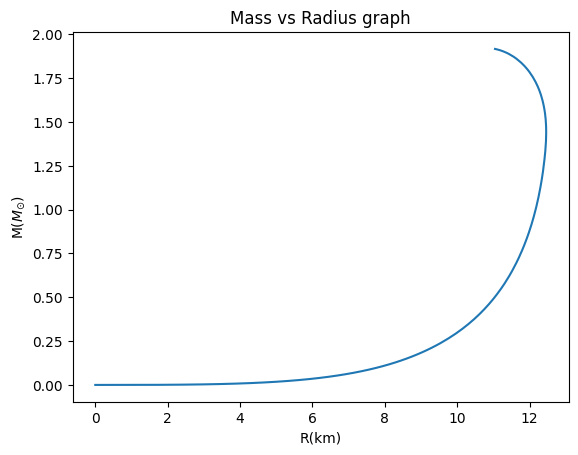

In [24]:
plt.plot(T[1],T[2])
plt.xlabel('R(km)')
plt.ylabel('M($M_{\odot}$)')

plt.title('Mass vs Radius graph')
plt.show()

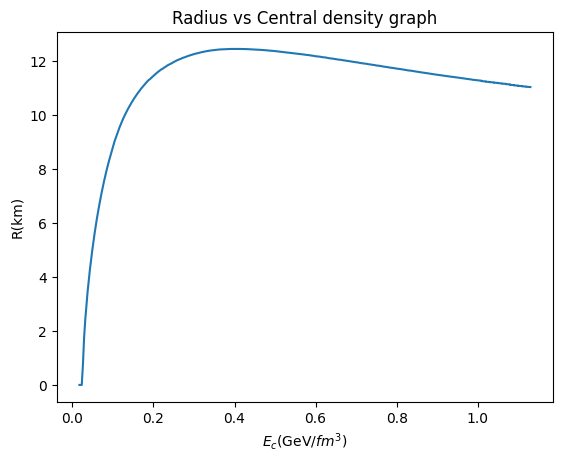

In [25]:
plt.plot(T[3],T[1])
plt.ylabel('R(km)')
plt.xlabel('$E_{c}$(GeV/$fm^{3}$)')

plt.title('Radius vs Central density graph')
plt.show()

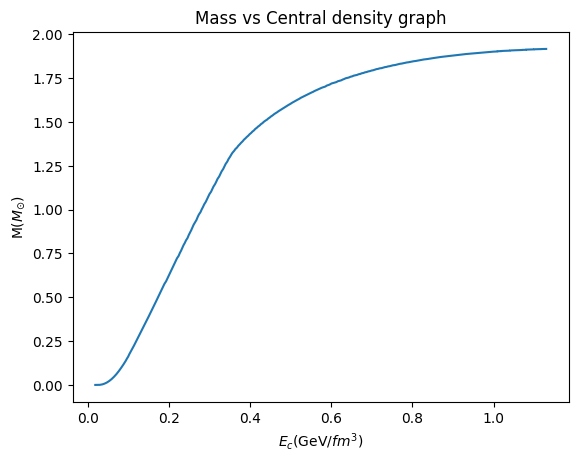

In [26]:
plt.plot(T[3],T[2])
plt.ylabel('M($M_{\odot}$)')
plt.xlabel('$E_{c}$(GeV/$fm^{3}$)')

plt.title('Mass vs Central density graph')
plt.show()